Author: yanjun zhang
## Concise
## 1: Start

Source from book "Abali - 2017 - Computational Reality" P119

import dolfinx
print(f"DOLFINx version: {dolfinx.__version__}   \
based on GIT commit:  \
{dolfinx.git_commit_hash} of https://github.com/FEniCS/dolfinx/")

In [1]:
import dolfinx
print(f"DOLFINx version: {dolfinx.__version__}")


DOLFINx version: 0.8.0


1: Total tims is  45.27 s
2: Total numb steps is  306


Text(0, 0.5, 'Brake pressure/ Pa')

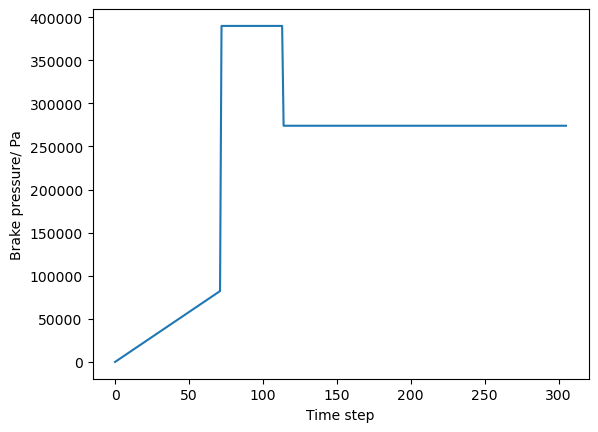

In [2]:
# import basic
import pyvista
import ufl
import dolfinx
import time
import sys
import os
import shutil
import numpy as np
import matplotlib.pyplot as plt

# import speciail library
from dolfinx.fem.petsc import (
    LinearProblem,
    assemble_vector,
    assemble_matrix,
    create_vector,
    apply_lifting,
    set_bc,
)
from dolfinx import fem, mesh, io, plot, default_scalar_type, nls, log
from dolfinx.fem import (
    Constant,
    dirichletbc,
    Function,
    FunctionSpace,
    form,
    locate_dofs_topological,
)
from dolfinx.io import XDMFFile, gmshio
from dolfinx.mesh import locate_entities, locate_entities_boundary, meshtags
from ufl import (
    SpatialCoordinate,
    TestFunction,
    TrialFunction,
    dx,
    grad,
    inner,
    Measure,
    dot,
    FacetNormal,
)
from dolfinx.fem.petsc import NonlinearProblem
from dolfinx.nls.petsc import NewtonSolver
from petsc4py import PETSc
from mpi4py import MPI

# import own functions


# calculate how long time the simulation it is
start_time = time.time()

# mesh-size, contact area coefficient
mesh_min = 3
mesh_max = 5
c_contact = 1

# Each time step rotation angular, and acc during lag, 1 is full acc, 0 is no acc.
angular_r = 448
v_vehicle = 160
c_acc = 1

def vehicle_initial(angular_r, v_vehicle, c_contact, c_acc):
    import numpy as np
    # v_ini  =  raad/ss
    v_ini = v_vehicle/3.6   /   (920/2/1000) 
    # D_wheel = 920 mm, v = D_wheel /2 /1000 * v_ini *3.6   # km/h
    # Start time, Final time  
    t = 0
    t_brake = 49
    t_lag1 = 6
    t_lag2 = 4
    # rubbing element radius, Contact area 
    r_rub = 18.8
    S_rub_circle = r_rub**2 * c_contact
    S_total = S_rub_circle * np.pi * 18  #mm2
    # initial and brake pad temperature
    Ti = 60
    Tm = 60
    # density (kg.m^-3), capacity (J/Kg.K), conductivity (W/m.K)
    t_u = 1e3 # m to mm
    rho = 7850 /(t_u**3)
    c = 462
    k = 48 / t_u
    # mu, P_brake,  r_disc , heat_distribution  
    mu = 0.376
    P_initial = 274000
    r_disc = 0.25
    heat_distribution = 0.88
    # calculate total num_steps
    if c_acc == 1:  # constant acc for the whole process
        acc = v_ini/t_brake
        # end velocity, km/h
        v_lag_end1 = (v_ini - (acc *t_lag1) )  
        v_lag_end2 = (v_ini - (acc *(t_lag1+t_lag2) ) )

        # angular speed, rad/s
        angular_r_rad = angular_r / 180 *np.pi  

        # lag time for period 1 and 2
        dt_lag1 = angular_r_rad  /  ( ( v_ini + v_lag_end1  ) /2 )
        dt_lag2 = angular_r_rad  /  ( ( v_lag_end1 + v_lag_end2  ) /2 )

        # lag steps for period 1 and 2
        n_lag1 = round (t_lag1 / dt_lag1) + 1 
        n_lag2 = round (t_lag2 / dt_lag2) + 1

        # every second, the rotation angular divide average speed, then know the average dt.
        dt_a_lag2 = angular_r_rad  /  ( v_lag_end2 /2 )
        
        n_a_lag =  round ( (t_brake - t_lag1 - t_lag2) / dt_a_lag2 )+ 1
        
        num_steps = n_lag1 + n_lag2 + n_a_lag
        dt = []
        v_angular = [v_ini]
        for i in range(num_steps):
            dt.append ( angular_r_rad / v_angular[i] )
            v_angular.append (  v_ini- sum(dt) * acc )           
        P = []
        for i in range(num_steps):
            if i <= n_lag1:
                # linear pressure increase * 10%
                P.append( P_initial/ n_lag1 * (i * 0.3) )
            elif n_lag1 < i <= (n_lag1 + n_lag2):
                # heat lost in lag1 is added on lag2, 50%, should be 90% here
                P.append( P_initial * (1+ n_lag1 / (2 * n_lag2)* 0.5 ) ) 
            else:
                P.append( P_initial) 
    # S_or is the original brake pad rubbing area, 200 cm2. 
    S_or = 200
    S_new = S_total/100 #mm2 to cm2
    # g is the heat source,unit is w/mm2 
    g = []
    for i in range(num_steps):
        g.append ( mu * P[i] * v_angular[i] * r_disc * heat_distribution *2 /(t_u**2)  * (S_or/S_new) )
        
    #  h is the heat convection coefficient, unit is W/mm2 K  
    h = 7.75e-5
    # radiation is the radiation heat coefficient, unit is W/mm2 K
    # stefan-Boltzmann constant theta = 5.67*10e-8 w/m2 k-4,   0.64 is the emmissivity
    radiation = 5.670*(10e-8)/(t_u**2)  * 0.64

    return dt,P,g,num_steps,h,radiation,v_angular,Ti,Tm,S_rub_circle,t,rho,c,k,t_brake,S_total,n_lag1,n_lag2,n_a_lag
    
# calling local functions to get all parameters
( dt,P,g,num_steps,h,radiation,v_angular,Ti,Tm,S_rub_circle,t,rho,c, k, t_brake,S_total,n_lag1,n_lag2,n_a_lag) = vehicle_initial (angular_r, v_vehicle, c_contact, c_acc)

print("1: Total tims is ", round(sum(dt), 2), "s")
print("2: Total numb steps is ", num_steps)

del dt[-1] 
num_steps = num_steps -1

plt.plot(P)
plt.xlabel("Time step")  # Label for x-axis
plt.ylabel("Brake pressure/ Pa")  # Label for y-axis


71
42
193
305


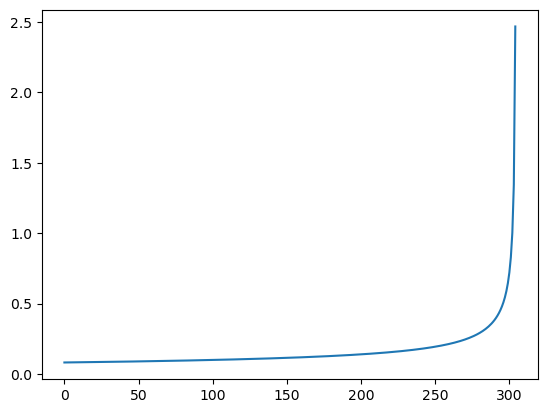

In [3]:
print(n_lag1)
print(n_lag2)
print(n_a_lag)
from disc_f import *



print(len(dt) )
plt.plot(dt)


In [4]:
print(num_steps)

305


## 2: Mesh

In [5]:
######################################  mesh  ###################################3
mesh_name = f"{mesh_min}-{mesh_max}"
mesh_filename1 = "m-{}.msh".format(mesh_name)
mesh_filename2 = "m-{}".format(mesh_name)

if os.path.exists(mesh_filename1):
    # Run this command if the file exists
    print(f"The file '{mesh_filename1}' exists, start creat now:")
    domain, cell_markers, facet_markers = gmshio.read_from_msh(
        mesh_filename1, MPI.COMM_WORLD, 0, gdim=3
    )

else:
    # Run this command if the file does not exist
    print(f"The file '{mesh_filename1}' does not exist, start building:")
    mesh_brake_disc(mesh_min, mesh_max, mesh_filename2, 'tetr')
    domain, cell_markers, facet_markers = gmshio.read_from_msh(
        mesh_filename1, MPI.COMM_WORLD, 0, gdim=3
    )

# Define variational problem, CG is Lagrabge
V = fem.functionspace(domain, ("CG", 1))


# initialization
def project(function, space):
    u = TrialFunction(space)
    v = TestFunction(space)
    a = inner(u, v) * dx
    L = inner(function, v) * dx
    problem = LinearProblem(a, L, bcs=[])
    return problem.solve()


# u_n is for initial condition and uh is the solver result.
# variable, need to be projected form Q onto V, DG is discontinuous Lagrange
Q = fem.functionspace(domain, ("DG", 0))
T_init = Function(Q)
T_init.name = "u_n"
T_init.x.array[:] = np.full_like(1, Ti, dtype=default_scalar_type)
u_n = project(T_init, V)
u_n.name = "u_n"

fdim = domain.topology.dim - 1
## bc_disc is zero, no any dirichlete boundary condition
bc_disc = mesh.locate_entities_boundary(domain, fdim, lambda x: np.isclose(x[2], 50))
bc = fem.dirichletbc(
    PETSc.ScalarType(Tm), fem.locate_dofs_topological(V, fdim, bc_disc), V
)
np.set_printoptions(threshold=np.inf)

import meshio

mesh1 = meshio.read(mesh_filename1)
total_elements = sum(len(cells.data) for cells in mesh1.cells)

The file 'm-3-5.msh' exists, start creat now:
Info    : Reading 'm-3-5.msh'...
Info    : 168 entities
Info    : 57455 nodes
Info    : 271817 elements
Info    : Done reading 'm-3-5.msh'                                         



## 3: Setup 


In [6]:
# create xdmf file, for paraview
xdmf_name = "T-s-{}-d-{}-{}-c-{}-e-{}.xdmf".format(
    num_steps, angular_r, mesh_filename2, c_contact, total_elements
)
h5_name = "T-s-{}-d-{}-{}-c-{}-e-{}.h5".format(
    num_steps, angular_r, mesh_filename2, c_contact, total_elements
)
xdmf = io.XDMFFile(domain.comm, xdmf_name, "w")
xdmf.write_mesh(domain)

# Create boundary condition
x_co, y_co = get_rub_coordinate()

common_indices3, facet_markers3, sorted_indices3 = target_facets(
    domain, x_co, y_co, S_rub_circle
)

facet_tag = meshtags(
    domain, fdim, common_indices3[sorted_indices3], facet_markers3[sorted_indices3]
)
ds = Measure("ds", domain=domain, subdomain_data=facet_tag)

## 4: Variational equation


In [7]:
uh = fem.Function(V)
uh.name = "uh"
uh = project(T_init, V)
t = 0
xdmf.write_function(uh, t)

# u = trial function, solution what we want to know
u = fem.Function(V)

v = ufl.TestFunction(V)
f = fem.Constant(domain, PETSc.ScalarType(0))
n_vector = FacetNormal(domain)

F = (
    (rho * c) / dt[0] * inner(u, v) * dx
    + k * inner(grad(u), grad(v)) * dx
    + h * inner(u, v) * ds(200)
    + radiation * inner(u**4, v) * ds(200)
    - (
        inner(f, v) * dx
        + (rho * c) / dt[0] * inner(u_n, v) * dx
        + h * Tm * v * ds(200)
        + radiation * (Tm**4) * v * ds(200)
    )
)


for i in list(range(1, 19)):
    # before 2024/5/16
    #F += -k * dot(grad(u) * v, n_vector) * ds(10 * i) - inner(g[0], v) * ds(10 * i)
    ## new start 2024/5/16, friction points do not have convection heat + heat input
    F += ( 
          + inner(g[0], v) * ds(10 * i) 
          - h * inner( u, v) * ds(10 * i)  
          - radiation * inner( (u**4 - Tm**4), v) * ds(10 * i) 
         )

problem = NonlinearProblem(F, u, bcs=[bc])

## 7: Using petsc4py to create a linear solver
#solver = NewtonSolver(MPI.COMM_WORLD, problem)
#solver.convergence_criterion = "incremental"
#solver.rtol = 1e-6
#solver.report = True

solver = NewtonSolver(MPI.COMM_WORLD, problem)

# Solver parameters
solver.convergence_criterion = "residual"  # Switch to residual criterion
solver.rtol = 1e-5  # Relax the relative tolerance
solver.atol = 1e-8  # Set an absolute tolerance (optional)
solver.max_it = 50  # Increase max iterations
solver.relaxation_parameter = 0.8  # Apply damping to Newton update
solver.report = True


ksp = solver.krylov_solver
opts = PETSc.Options()
option_prefix = ksp.getOptionsPrefix()
opts[f"{option_prefix}ksp_type"] = "cg"
opts[f"{option_prefix}pc_type"] = "gamg"
opts[f"{option_prefix}pc_factor_mat_solver_type"] = "mumps"
ksp.setFromOptions()

log.set_log_level(log.LogLevel.INFO)
n, converged = solver.solve(u)
assert converged


## 8:Visualization of time dependent problem using pyvista
import matplotlib as mpl

pyvista.start_xvfb()
grid = pyvista.UnstructuredGrid(*plot.vtk_mesh(V))
plotter = pyvista.Plotter()

gif_name = "T-s-{}-d-{}-{}-c-{}-e-{}.gif".format(
    num_steps, angular_r, mesh_filename2, c_contact, total_elements)

plotter.open_gif(gif_name, fps=30)
grid.point_data["Temperature"] = u.x.array
warped = grid.warp_by_scalar("Temperature", factor=0)
viridis = mpl.colormaps.get_cmap("viridis").resampled(25)
sargs = dict(
    title_font_size=25,
    label_font_size=20,
    color="black",
    position_x=0.1,
    position_y=0.8,
    width=0.8,
    height=0.1,
)
renderer = plotter.add_mesh(
    warped,
    show_edges=True,
    lighting=False,
    cmap=viridis,
    scalar_bar_args=sargs,
    # clim=[0, max(uh.x.array)])
    clim=[0, 200],
)

2024-09-17 12:50:58.619 (   9.526s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 85612 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:50:58.712 (   9.619s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:50:59.256 (  10.164s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 1: r (abs) = 17122.4 (tol = 1e-08) r (rel) = 1.19053(tol = 1e-05)
2024-09-17 12:50:59.367 (  10.274s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:50:59.426 (  10.333s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 2: r (abs) = 3424.48 (tol = 1e-08) r (rel) = 0.238106(tol = 1e-05)
2024-09-17 12:50:59.507 (  10.414s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:50:59.668 (  10.576s) [main            ]       NewtonSolver.cpp:

## 5: Solution


In [8]:
T_array = [(0, [Ti for _ in range(len(u.x.array))])]
total_degree = 0

for i in range(num_steps):
    t += dt[i]

    x_co, y_co = rub_rotation(x_co, y_co, angular_r)  # update the location
    total_degree += angular_r  # Incrementing degree by 10 in each step

    sys.stdout.write("\r1: Rotation has applied for {} degree. ".format(total_degree))
    sys.stdout.write("2: Current time is " + str(round(t, 1)) + " s. ")
    sys.stdout.write("3: Completion is " + str(round(100 * (t / t_brake), 1)) + " %. ")
    sys.stdout.flush()

    common_indices3, facet_markers3, sorted_indices3 = target_facets(
        domain, x_co, y_co, S_rub_circle
    )
    facet_tag = meshtags(
        domain, fdim, common_indices3[sorted_indices3], facet_markers3[sorted_indices3]
    )
    ds = Measure("ds", domain=domain, subdomain_data=facet_tag)

    F = (
        (rho * c) / dt[i] * inner(u, v) * dx
        + k * inner(grad(u), grad(v)) * dx
        + h * inner(u, v) * ds(200)
        + radiation * inner(u**4, v) * ds(200)
        - (
            inner(f, v) * dx
            + (rho * c) / dt[i] * inner(u_n, v) * dx
            + h * Tm * v * ds(200)
            + radiation * (Tm**4) * v * ds(200)
        )
    )

    for j in list(range(1, 19)):
        #F += -k * dot(grad(u) * v, n_vector) * ds(10 * j) - inner(g[i], v) * ds(10 * j)
        F += ( 
          - inner(g[i], v) * ds(10 * j) 
          - h * inner( u, v) * ds(10 * j)  
          - radiation * inner( (u**4 - Tm**4), v) * ds(10 * j) 
         )

        

    problem = NonlinearProblem(F, u, bcs=[bc])

    ## 7: Using petsc4py to create a linear solver
    solver = NewtonSolver(MPI.COMM_WORLD, problem)
    #solver.convergence_criterion = "incremental"
    #solver.rtol = 1e-6

    # Solver parameters
    solver.convergence_criterion = "residual"  # Switch to residual criterion
    solver.rtol = 1e-5  # Relax the relative tolerance
    solver.atol = 1e-8  # Set an absolute tolerance (optional)
    solver.max_it = 50  # Increase max iterations
    solver.relaxation_parameter = 0.8  # Apply damping to Newton update
    solver.report = True

    ksp = solver.krylov_solver
    opts = PETSc.Options()
    option_prefix = ksp.getOptionsPrefix()
    opts[f"{option_prefix}ksp_type"] = "cg"
    opts[f"{option_prefix}pc_type"] = "gamg"
    opts[f"{option_prefix}pc_factor_mat_solver_type"] = "mumps"
    ksp.setFromOptions()

    sys.stdout.write("1: Completion is " + str(round(100 * (t / t_brake), 1)) + " %. ")
    sys.stdout.flush()

    solver.solve(u)
    u.x.scatter_forward()

    # Update solution at previous time step (u_n)
    u_n.x.array[:] = u.x.array

    T_array.append((t, u.x.array.copy()))
    # Write solution to file
    xdmf.write_function(u, t)
    # Update plot
    # warped = grid.warp_by_scalar("uh", factor=0)
    plotter.update_coordinates(warped.points.copy(), render=False)
    plotter.update_scalars(u.x.array, render=False)
    plotter.write_frame()

plotter.close()
xdmf.close()
print()

csv_name = "Result_T-s-{}-d-{}-{}-c-{}-e-{}.csv".format(
    num_steps, angular_r, mesh_filename2, c_contact, total_elements
)
save_t_T(csv_name, T_array)

1: Rotation has applied for 448 degree. 2: Current time is 0.1 s. 3: Completion is 0.2 %. 

2024-09-17 12:51:06.050 (  15.599s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:51:06.055 (  15.604s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:51:06.055 (  15.604s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:51:06.057 (  15.606s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:51:06.059 (  15.608s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:51:06.059 (  15.608s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:51:06.062 (  15.611s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:51:06.066 (  15.615s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 0.2 %. 

2024-09-17 12:51:07.726 (  17.275s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:07.726 (  17.275s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:51:07.735 (  17.284s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:07.735 (  17.284s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:51:07.755 (  17.304s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:07.868 (  17.417s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:51:07.922 (  17.471s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 4.14418 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:51:08.081 (  17.630s) [main            ]       

1: Rotation has applied for 896 degree. 2: Current time is 0.2 s. 3: Completion is 0.3 %. 

2024-09-17 12:51:09.898 (  19.447s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:51:09.900 (  19.449s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:51:09.900 (  19.449s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:51:09.902 (  19.451s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:51:09.903 (  19.452s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:51:09.903 (  19.452s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:51:09.905 (  19.454s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:51:09.910 (  19.459s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 0.3 %. 

2024-09-17 12:51:11.596 (  21.145s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:11.596 (  21.145s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:51:11.605 (  21.154s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:11.606 (  21.155s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:51:11.629 (  21.178s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:11.695 (  21.244s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:51:11.707 (  21.256s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 12.3005 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:51:11.875 (  21.424s) [main            ]       

1: Rotation has applied for 1344 degree. 2: Current time is 0.2 s. 3: Completion is 0.5 %. 

2024-09-17 12:51:14.145 (  23.694s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:51:14.151 (  23.700s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:51:14.151 (  23.700s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:51:14.155 (  23.704s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:51:14.158 (  23.707s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:51:14.158 (  23.707s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:51:14.161 (  23.710s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:51:14.163 (  23.712s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 0.5 %. 

2024-09-17 12:51:14.881 (  24.429s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:14.881 (  24.430s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:51:14.883 (  24.432s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:14.883 (  24.432s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:51:14.937 (  24.486s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:14.937 (  24.486s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:51:14.938 (  24.487s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:14.938 (  24.487s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Rotation has applied for 1792 degree. 2: Current time is 0.3 s. 3: Completion is 0.7 %. 

2024-09-17 12:51:17.803 (  27.352s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:51:17.807 (  27.355s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:51:17.807 (  27.356s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:51:17.808 (  27.357s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:51:17.811 (  27.360s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:51:17.811 (  27.360s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:51:17.813 (  27.362s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:51:17.816 (  27.365s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 0.7 %. 

2024-09-17 12:51:19.544 (  29.093s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:19.545 (  29.094s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:51:19.550 (  29.099s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:19.550 (  29.099s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:51:19.579 (  29.128s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:19.722 (  29.271s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:51:19.805 (  29.354s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 38.571 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:51:20.068 (  29.617s) [main            ]        

1: Rotation has applied for 2240 degree. 2: Current time is 0.4 s. 3: Completion is 0.8 %. 

2024-09-17 12:51:22.868 (  32.416s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 9.87413e-05 (tol = 1e-08) r (rel) = 3.85961e-06(tol = 1e-05)
2024-09-17 12:51:22.868 (  32.417s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:51:22.868 (  32.417s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:51:22.979 (  32.528s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:51:22.983 (  32.532s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:51:22.983 (  32.532s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:51:22.985 (  32.534s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-0

1: Completion is 0.8 %. 

2024-09-17 12:51:24.498 (  34.047s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:24.498 (  34.047s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:51:24.505 (  34.054s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:24.505 (  34.054s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:51:24.531 (  34.080s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:24.651 (  34.200s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:51:24.717 (  34.266s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 43.2784 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:51:24.820 (  34.369s) [main            ]       

1: Rotation has applied for 2688 degree. 2: Current time is 0.5 s. 3: Completion is 1.0 %. 

2024-09-17 12:51:26.059 (  35.608s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 6: r (abs) = 0.00276981 (tol = 1e-08) r (rel) = 0.00011182(tol = 1e-05)
2024-09-17 12:51:26.172 (  35.721s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:51:26.223 (  35.773s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.000553961 (tol = 1e-08) r (rel) = 2.2364e-05(tol = 1e-05)
2024-09-17 12:51:26.331 (  35.880s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:51:26.494 (  36.042s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.000110792 (tol = 1e-08) r (rel) = 4.47279e-06(tol = 1e-05)
2024-09-17 12:51:26.494 (  36.043s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:51:26.495 ( 

1: Completion is 1.0 %. 

2024-09-17 12:51:28.064 (  37.613s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:28.064 (  37.613s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:51:28.070 (  37.619s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:28.070 (  37.619s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:51:28.091 (  37.640s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:28.222 (  37.771s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:51:28.291 (  37.840s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 52.7433 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:51:28.409 (  37.958s) [main            ]       

1: Rotation has applied for 3136 degree. 2: Current time is 0.6 s. 3: Completion is 1.2 %. 

2024-09-17 12:51:29.727 (  39.276s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.000675111 (tol = 1e-08) r (rel) = 2.28647e-05(tol = 1e-05)
2024-09-17 12:51:29.839 (  39.388s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:51:29.914 (  39.463s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.000135022 (tol = 1e-08) r (rel) = 4.57293e-06(tol = 1e-05)
2024-09-17 12:51:29.915 (  39.464s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:51:29.915 (  39.464s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:51:29.974 (  39.523s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:51:29.978 (  39.527s) [main            ]topologycomputation

1: Completion is 1.2 %. 

2024-09-17 12:51:30.175 (  39.724s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:30.175 (  39.724s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:51:30.183 (  39.732s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:30.184 (  39.732s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:51:30.187 (  39.736s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:30.198 (  39.747s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:51:30.259 (  39.808s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 62.4562 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:51:30.274 (  39.823s) [main            ]       

1: Rotation has applied for 3584 degree. 2: Current time is 0.7 s. 3: Completion is 1.3 %. 

2024-09-17 12:51:30.686 (  40.235s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.000799436 (tol = 1e-08) r (rel) = 2.28603e-05(tol = 1e-05)
2024-09-17 12:51:30.757 (  40.306s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:51:30.777 (  40.326s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.000159887 (tol = 1e-08) r (rel) = 4.57206e-06(tol = 1e-05)
2024-09-17 12:51:30.777 (  40.326s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:51:30.780 (  40.329s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:51:30.844 (  40.392s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:51:30.851 (  40.400s) [main            ]topologycomputation

1: Completion is 1.3 %. 

2024-09-17 12:51:31.061 (  40.609s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:31.061 (  40.610s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:51:31.063 (  40.612s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:31.063 (  40.612s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:51:31.120 (  40.668s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:31.120 (  40.669s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:51:31.121 (  40.670s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:31.121 (  40.670s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Rotation has applied for 4032 degree. 2: Current time is 0.7 s. 3: Completion is 1.5 %. 

2024-09-17 12:51:31.853 (  41.402s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:51:31.908 (  41.456s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.000214274 (tol = 1e-08) r (rel) = 3.84748e-06(tol = 1e-05)
2024-09-17 12:51:31.908 (  41.457s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:51:31.909 (  41.458s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:51:31.986 (  41.535s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:51:31.991 (  41.540s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:51:31.991 (  41.540s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0

1: Completion is 1.5 %. 

2024-09-17 12:51:33.520 (  43.069s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:33.520 (  43.069s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:51:33.526 (  43.075s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:33.526 (  43.075s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:51:33.551 (  43.100s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:33.664 (  43.213s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:51:46.760 (  43.289s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 85.524 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:51:46.787 (  43.316s) [main            ]        

1: Rotation has applied for 4480 degree. 2: Current time is 0.8 s. 3: Completion is 1.7 %. 

2024-09-17 12:51:47.478 (  44.008s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00021894 (tol = 1e-08) r (rel) = 4.36591e-06(tol = 1e-05)
2024-09-17 12:51:47.478 (  44.008s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:51:47.479 (  44.009s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:51:47.583 (  44.113s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:51:47.586 (  44.115s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:51:47.586 (  44.115s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:51:47.589 (  44.119s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09

1: Completion is 1.7 %. 

2024-09-17 12:51:49.109 (  45.639s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:49.109 (  45.639s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:51:49.115 (  45.644s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:49.115 (  45.644s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:51:49.135 (  45.665s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:49.253 (  45.782s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:51:49.320 (  45.849s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 93.1595 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:51:49.343 (  45.872s) [main            ]       

1: Rotation has applied for 4928 degree. 2: Current time is 0.9 s. 3: Completion is 1.8 %. 

2024-09-17 12:51:50.054 (  46.584s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:51:50.154 (  46.684s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:51:50.157 (  46.686s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:51:50.157 (  46.687s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:51:50.158 (  46.688s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:51:50.161 (  46.690s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:51:50.161 (  46.690s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:51:50.162 (  46.692s) [main            ]topologycomputation.cpp:799   INFO| Req

1: Completion is 1.8 %. 

2024-09-17 12:51:50.264 (  46.794s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:50.265 (  46.794s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:51:50.266 (  46.796s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:50.266 (  46.796s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:51:50.374 (  46.903s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:50.374 (  46.904s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:51:50.375 (  46.905s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:50.375 (  46.905s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Rotation has applied for 5376 degree. 2: Current time is 1.0 s. 3: Completion is 2.0 %. 

2024-09-17 12:51:51.971 (  48.501s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:51:51.976 (  48.506s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:51:51.976 (  48.506s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:51:51.979 (  48.508s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:51:51.981 (  48.511s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:51:51.981 (  48.511s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:51:51.983 (  48.512s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:51:51.996 (  48.526s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 2.0 %. 

2024-09-17 12:51:52.251 (  48.780s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:52.251 (  48.781s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:51:52.252 (  48.782s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:52.252 (  48.782s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:51:52.312 (  48.842s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:52.313 (  48.842s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:51:52.314 (  48.844s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:52.314 (  48.844s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Rotation has applied for 5824 degree. 2: Current time is 1.1 s. 3: Completion is 2.2 %. 

2024-09-17 12:51:53.026 (  49.556s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:51:53.111 (  49.641s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.000323289 (tol = 1e-08) r (rel) = 3.97042e-06(tol = 1e-05)
2024-09-17 12:51:53.111 (  49.641s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:51:53.112 (  49.641s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:51:53.146 (  49.676s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:51:53.149 (  49.678s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:51:53.149 (  49.679s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0

1: Completion is 2.2 %. 

2024-09-17 12:51:53.374 (  49.904s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:53.375 (  49.904s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:51:53.377 (  49.906s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:53.377 (  49.907s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:51:53.379 (  49.909s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:53.389 (  49.919s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:51:53.447 (  49.977s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 129.822 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:51:53.467 (  49.996s) [main            ]       

1: Rotation has applied for 6272 degree. 2: Current time is 1.1 s. 3: Completion is 2.3 %. 

2024-09-17 12:51:53.863 (  50.393s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:51:53.909 (  50.439s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.000332342 (tol = 1e-08) r (rel) = 4.25952e-06(tol = 1e-05)
2024-09-17 12:51:53.910 (  50.439s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:51:53.910 (  50.440s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:51:54.009 (  50.539s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:51:54.016 (  50.546s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:51:54.016 (  50.546s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0

1: Completion is 2.3 %. 

2024-09-17 12:51:54.223 (  50.753s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:54.223 (  50.753s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:51:54.225 (  50.755s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:54.225 (  50.755s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:51:54.289 (  50.819s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:54.289 (  50.819s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:51:54.290 (  50.820s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:54.290 (  50.820s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Rotation has applied for 6720 degree. 2: Current time is 1.2 s. 3: Completion is 2.5 %. 

2024-09-17 12:51:54.806 (  51.335s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:51:54.896 (  51.426s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.00170139 (tol = 1e-08) r (rel) = 2.26791e-05(tol = 1e-05)
2024-09-17 12:51:54.917 (  51.447s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:51:54.952 (  51.482s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.000340277 (tol = 1e-08) r (rel) = 4.53581e-06(tol = 1e-05)
2024-09-17 12:51:54.952 (  51.482s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:51:54.953 (  51.482s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:51:54.993 (  51.522s) [main            ]topologycomp

1: Completion is 2.5 %. 

2024-09-17 12:51:55.123 (  51.653s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:55.123 (  51.653s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:51:55.130 (  51.659s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:55.130 (  51.659s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:51:55.216 (  51.745s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:55.216 (  51.746s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:51:55.217 (  51.747s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:55.217 (  51.747s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Rotation has applied for 7168 degree. 2: Current time is 1.3 s. 3: Completion is 2.7 %. 

2024-09-17 12:51:55.846 (  52.375s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.00182037 (tol = 1e-08) r (rel) = 2.26895e-05(tol = 1e-05)
2024-09-17 12:51:55.894 (  52.423s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:51:55.983 (  52.513s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.000364073 (tol = 1e-08) r (rel) = 4.5379e-06(tol = 1e-05)
2024-09-17 12:51:55.983 (  52.513s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:51:55.984 (  52.514s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:51:56.034 (  52.564s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:51:56.042 (  52.571s) [main            ]topologycomputation.c

1: Completion is 2.7 %. 

2024-09-17 12:51:57.565 (  54.095s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:57.565 (  54.095s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:51:57.571 (  54.101s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:57.571 (  54.101s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:51:57.591 (  54.121s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:51:57.716 (  54.246s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:51:57.794 (  54.323s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 165.231 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:51:57.896 (  54.425s) [main            ]       

1: Rotation has applied for 7616 degree. 2: Current time is 1.4 s. 3: Completion is 2.8 %. 

2024-09-17 12:51:59.175 (  55.704s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 6: r (abs) = 0.0105748 (tol = 1e-08) r (rel) = 0.000100143(tol = 1e-05)
2024-09-17 12:51:59.307 (  55.836s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:51:59.399 (  55.928s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.00211495 (tol = 1e-08) r (rel) = 2.00286e-05(tol = 1e-05)
2024-09-17 12:51:59.554 (  56.084s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:51:59.648 (  56.177s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.000422989 (tol = 1e-08) r (rel) = 4.00572e-06(tol = 1e-05)
2024-09-17 12:51:59.648 (  56.178s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:51:59.648 ( 

1: Completion is 2.8 %. 

2024-09-17 12:52:01.296 (  57.826s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:52:01.296 (  57.826s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:52:01.306 (  57.837s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:52:01.307 (  57.837s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:52:01.330 (  57.860s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:52:01.445 (  57.975s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:52:01.550 (  58.079s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 171.754 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:52:01.753 (  58.283s) [main            ]       

1: Rotation has applied for 8064 degree. 2: Current time is 1.5 s. 3: Completion is 3.0 %. 

2024-09-17 12:52:03.450 (  59.980s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.000439688 (tol = 1e-08) r (rel) = 4.15324e-06(tol = 1e-05)
2024-09-17 12:52:03.450 (  59.980s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:52:03.450 (  59.980s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:52:03.511 (  60.041s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:52:03.521 (  60.050s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:52:03.521 (  60.050s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:52:03.523 (  60.053s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-0

1: Completion is 3.0 %. 

2024-09-17 12:52:03.800 (  60.330s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:52:03.800 (  60.330s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:52:03.802 (  60.331s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:52:03.802 (  60.332s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:52:03.804 (  60.334s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:52:03.807 (  60.337s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:52:03.900 (  60.429s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 172.965 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:52:04.034 (  60.564s) [main            ]       

1: Rotation has applied for 8512 degree. 2: Current time is 1.6 s. 3: Completion is 3.2 %. 

2024-09-17 12:52:05.652 (  62.182s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.000442787 (tol = 1e-08) r (rel) = 4.4995e-06(tol = 1e-05)
2024-09-17 12:52:05.652 (  62.182s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:52:05.653 (  62.182s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:52:05.770 (  62.300s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:52:05.775 (  62.305s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:52:05.775 (  62.305s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:52:05.776 (  62.306s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09

1: Completion is 3.2 %. 

2024-09-17 12:52:07.297 (  63.826s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:52:07.297 (  63.827s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:52:07.302 (  63.832s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:52:07.303 (  63.832s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:52:07.323 (  63.853s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:52:07.436 (  63.966s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:52:07.501 (  64.031s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 182.575 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:52:07.613 (  64.142s) [main            ]       

1: Rotation has applied for 8960 degree. 2: Current time is 1.6 s. 3: Completion is 3.4 %. 

2024-09-17 12:52:08.357 (  64.887s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.00233696 (tol = 1e-08) r (rel) = 2.25824e-05(tol = 1e-05)
2024-09-17 12:52:08.435 (  64.964s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:52:08.482 (  65.012s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.000467391 (tol = 1e-08) r (rel) = 4.51647e-06(tol = 1e-05)
2024-09-17 12:52:08.483 (  65.012s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:52:08.483 (  65.013s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:52:08.535 (  65.065s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:52:08.539 (  65.069s) [main            ]topologycomputation.

1: Completion is 3.4 %. 

2024-09-17 12:52:09.138 (  65.668s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:52:09.138 (  65.668s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:52:09.140 (  65.670s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:52:09.140 (  65.670s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:52:09.142 (  65.672s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:52:09.170 (  65.700s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:52:09.244 (  65.774s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 205.948 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:52:09.412 (  65.941s) [main            ]       

1: Rotation has applied for 9408 degree. 2: Current time is 1.7 s. 3: Completion is 3.5 %. 

2024-09-17 12:52:12.031 (  68.561s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.00263613 (tol = 1e-08) r (rel) = 2.02405e-05(tol = 1e-05)
2024-09-17 12:52:12.220 (  68.750s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:52:12.273 (  68.803s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.000527225 (tol = 1e-08) r (rel) = 4.0481e-06(tol = 1e-05)
2024-09-17 12:52:12.273 (  68.803s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:52:12.274 (  68.804s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:52:12.379 (  68.908s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:52:12.381 (  68.911s) [main            ]topologycomputation.c

1: Completion is 3.5 %. 

2024-09-17 12:52:14.077 (  70.607s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:52:14.078 (  70.608s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:52:14.087 (  70.617s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:52:14.087 (  70.617s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:52:14.110 (  70.639s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:52:14.244 (  70.774s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:52:14.331 (  70.861s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 210.207 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:52:14.434 (  70.964s) [main            ]       

1: Rotation has applied for 9856 degree. 2: Current time is 1.8 s. 3: Completion is 3.7 %. 

2024-09-17 12:52:15.912 (  72.442s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.00269064 (tol = 1e-08) r (rel) = 2.05193e-05(tol = 1e-05)
2024-09-17 12:52:16.022 (  72.551s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:52:16.104 (  72.634s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.000538128 (tol = 1e-08) r (rel) = 4.10386e-06(tol = 1e-05)
2024-09-17 12:52:16.104 (  72.634s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:52:16.105 (  72.634s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:52:16.225 (  72.755s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:52:16.229 (  72.759s) [main            ]topologycomputation.

1: Completion is 3.7 %. 

2024-09-17 12:52:18.078 (  74.608s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:52:18.078 (  74.608s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:52:18.087 (  74.616s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:52:18.087 (  74.616s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:52:18.111 (  74.641s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:52:18.239 (  74.768s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:52:18.350 (  74.879s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 211.053 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:52:18.568 (  75.098s) [main            ]       

1: Rotation has applied for 10304 degree. 2: Current time is 1.9 s. 3: Completion is 3.9 %. 

2024-09-17 12:52:45.958 (  77.313s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:52:45.961 (  77.316s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:52:45.961 (  77.316s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:52:45.963 (  77.318s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:52:45.971 (  77.327s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:52:45.972 (  77.327s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:52:45.976 (  77.331s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:52:45.979 (  77.334s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 3.9 %. 

2024-09-17 12:52:47.873 (  79.229s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:52:47.873 (  79.229s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:52:47.881 (  79.236s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:52:47.881 (  79.236s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:52:47.914 (  79.269s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:52:48.063 (  79.418s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:52:48.157 (  79.513s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 220.486 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:52:48.377 (  79.732s) [main            ]       

1: Rotation has applied for 10752 degree. 2: Current time is 2.0 s. 3: Completion is 4.0 %. 

2024-09-17 12:52:51.060 (  82.416s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.000564442 (tol = 1e-08) r (rel) = 4.4853e-06(tol = 1e-05)
2024-09-17 12:52:51.060 (  82.416s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:52:51.061 (  82.416s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:52:51.171 (  82.526s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:52:51.174 (  82.529s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:52:51.174 (  82.529s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:52:51.176 (  82.531s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09

1: Completion is 4.0 %. 

2024-09-17 12:52:52.998 (  84.353s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:52:52.998 (  84.353s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:52:53.005 (  84.361s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:52:53.005 (  84.361s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:52:53.036 (  84.391s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:52:53.175 (  84.530s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:52:53.306 (  84.661s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 238.497 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:52:53.454 (  84.809s) [main            ]       

1: Rotation has applied for 11200 degree. 2: Current time is 2.1 s. 3: Completion is 4.2 %. 

2024-09-17 12:52:54.148 (  85.503s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:52:54.203 (  85.559s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.00305275 (tol = 1e-08) r (rel) = 2.04231e-05(tol = 1e-05)
2024-09-17 12:52:54.270 (  85.625s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:52:54.307 (  85.663s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00061055 (tol = 1e-08) r (rel) = 4.08463e-06(tol = 1e-05)
2024-09-17 12:52:54.307 (  85.663s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:52:54.308 (  85.663s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:52:54.377 (  85.733s) [main            ]topologycompu

1: Completion is 4.2 %. 

2024-09-17 12:52:54.766 (  86.121s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 259.017 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:52:54.804 (  86.160s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:52:54.907 (  86.262s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 1: r (abs) = 51.8035 (tol = 1e-08) r (rel) = 0.313306(tol = 1e-05)
2024-09-17 12:52:54.946 (  86.302s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:52:54.975 (  86.331s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 2: r (abs) = 10.3607 (tol = 1e-08) r (rel) = 0.0626611(tol = 1e-05)
2024-09-17 12:52:55.003 (  86.359s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:52:55.052 (  86.408s) [main            ]       NewtonSolver.

1: Rotation has applied for 11648 degree. 2: Current time is 2.1 s. 3: Completion is 4.4 %. 

2024-09-17 12:52:55.462 (  86.817s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:52:55.502 (  86.858s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.00331541 (tol = 1e-08) r (rel) = 2.00515e-05(tol = 1e-05)
2024-09-17 12:52:55.556 (  86.912s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:52:55.588 (  86.944s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.000663082 (tol = 1e-08) r (rel) = 4.01029e-06(tol = 1e-05)
2024-09-17 12:52:55.588 (  86.944s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:52:55.589 (  86.945s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:52:55.661 (  87.016s) [main            ]topologycomp

1: Completion is 4.4 %. 

2024-09-17 12:52:57.315 (  88.671s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:52:57.316 (  88.671s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:52:57.325 (  88.680s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:52:57.325 (  88.680s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:52:57.346 (  88.702s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:52:57.476 (  88.832s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:52:57.573 (  88.928s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 249.913 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:52:57.746 (  89.102s) [main            ]       

1: Rotation has applied for 12096 degree. 2: Current time is 2.2 s. 3: Completion is 4.6 %. 

2024-09-17 12:52:59.579 (  90.934s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.00319888 (tol = 1e-08) r (rel) = 2.22687e-05(tol = 1e-05)
2024-09-17 12:52:59.715 (  91.070s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:52:59.798 (  91.154s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.000639775 (tol = 1e-08) r (rel) = 4.45373e-06(tol = 1e-05)
2024-09-17 12:52:59.802 (  91.157s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:52:59.803 (  91.158s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:52:59.853 (  91.208s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:52:59.861 (  91.216s) [main            ]topologycomputation.

1: Completion is 4.6 %. 

2024-09-17 12:53:00.090 (  91.446s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:53:00.091 (  91.446s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:53:00.094 (  91.450s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:53:00.094 (  91.450s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:53:00.096 (  91.452s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:53:00.103 (  91.458s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:53:00.154 (  91.509s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 258.554 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:53:00.185 (  91.540s) [main            ]       

1: Rotation has applied for 12544 degree. 2: Current time is 2.3 s. 3: Completion is 4.7 %. 

2024-09-17 12:53:00.797 (  92.153s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:53:00.863 (  92.218s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.000661895 (tol = 1e-08) r (rel) = 4.46391e-06(tol = 1e-05)
2024-09-17 12:53:00.864 (  92.220s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:53:00.865 (  92.221s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:53:00.927 (  92.282s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:53:00.929 (  92.285s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:53:00.929 (  92.285s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0

1: Completion is 4.7 %. 

2024-09-17 12:53:01.146 (  92.502s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:53:01.146 (  92.502s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:53:01.148 (  92.504s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:53:01.148 (  92.504s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:53:01.204 (  92.559s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:53:01.204 (  92.560s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:53:01.205 (  92.561s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:53:01.205 (  92.561s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Rotation has applied for 12992 degree. 2: Current time is 2.4 s. 3: Completion is 4.9 %. 

2024-09-17 12:53:01.882 (  93.238s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:53:01.932 (  93.288s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.000717812 (tol = 1e-08) r (rel) = 4.11732e-06(tol = 1e-05)
2024-09-17 12:53:01.932 (  93.288s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:53:01.933 (  93.288s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:53:02.037 (  93.392s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:53:02.040 (  93.395s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:53:02.040 (  93.395s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0

1: Completion is 4.9 %. 

2024-09-17 12:53:03.756 (  95.112s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:53:03.756 (  95.112s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:53:03.763 (  95.119s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:53:03.763 (  95.119s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:53:03.786 (  95.141s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:53:03.915 (  95.270s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:53:04.000 (  95.356s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 301.658 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:53:04.164 (  95.520s) [main            ]       

1: Rotation has applied for 13440 degree. 2: Current time is 2.5 s. 3: Completion is 5.1 %. 1: Completion is 5.1 %. 

2024-09-17 12:53:05.717 (  97.072s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.00386121 (tol = 1e-08) r (rel) = 1.9745e-05(tol = 1e-05)
2024-09-17 12:53:05.852 (  97.208s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:53:05.938 (  97.294s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.000772242 (tol = 1e-08) r (rel) = 3.94901e-06(tol = 1e-05)
2024-09-17 12:53:05.938 (  97.294s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:53:05.939 (  97.294s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:53:05.986 (  97.342s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:53:05.993 (  97.349s) [main            ]topologycomputation.c

1: Rotation has applied for 13888 degree. 2: Current time is 2.6 s. 3: Completion is 5.3 %. 

2024-09-17 12:53:06.964 (  98.320s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 6: r (abs) = 0.0184697 (tol = 1e-08) r (rel) = 0.000110375(tol = 1e-05)
2024-09-17 12:53:07.056 (  98.412s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:53:07.086 (  98.442s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.00369393 (tol = 1e-08) r (rel) = 2.2075e-05(tol = 1e-05)
2024-09-17 12:53:07.116 (  98.471s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:53:07.136 (  98.492s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.000738786 (tol = 1e-08) r (rel) = 4.41499e-06(tol = 1e-05)
2024-09-17 12:53:07.137 (  98.492s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:53:07.137 (  

1: Completion is 5.3 %. 

2024-09-17 12:53:08.884 ( 100.239s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:53:08.884 ( 100.240s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:53:08.890 ( 100.245s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:53:08.890 ( 100.245s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:53:08.913 ( 100.268s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:53:09.044 ( 100.399s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:53:09.138 ( 100.493s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 294.432 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:53:09.219 ( 100.575s) [main            ]       

1: Rotation has applied for 14336 degree. 2: Current time is 2.7 s. 3: Completion is 5.4 %. 

2024-09-17 12:53:10.871 ( 102.227s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.00376872 (tol = 1e-08) r (rel) = 2.23234e-05(tol = 1e-05)
2024-09-17 12:53:11.084 ( 102.439s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:53:11.180 ( 102.536s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.000753743 (tol = 1e-08) r (rel) = 4.46468e-06(tol = 1e-05)
2024-09-17 12:53:11.180 ( 102.536s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:53:11.183 ( 102.538s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:53:11.273 ( 102.629s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:53:11.277 ( 102.632s) [main            ]topologycomputation.

1: Completion is 5.4 %. 

2024-09-17 12:53:12.946 ( 104.301s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:53:12.946 ( 104.302s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:53:12.954 ( 104.310s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:53:12.954 ( 104.310s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:53:12.975 ( 104.331s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:53:13.100 ( 104.455s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:53:13.220 ( 104.575s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 314.22 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:53:13.466 ( 104.822s) [main            ]        

1: Rotation has applied for 14784 degree. 2: Current time is 2.7 s. 3: Completion is 5.6 %. 

2024-09-17 12:53:15.164 ( 106.520s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:53:15.166 ( 106.521s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:53:15.395 ( 106.751s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:53:15.397 ( 106.753s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:53:15.398 ( 106.753s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:53:15.403 ( 106.758s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:53:15.408 ( 106.763s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:53:15.408 ( 106.764s) [main            ]topol

1: Completion is 5.6 %. 

2024-09-17 12:53:35.252 ( 108.450s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:53:35.252 ( 108.451s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:53:35.258 ( 108.457s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:53:35.259 ( 108.457s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:53:35.285 ( 108.483s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:53:35.434 ( 108.632s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:53:35.520 ( 108.718s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 352.676 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:53:35.659 ( 108.858s) [main            ]       

1: Rotation has applied for 15232 degree. 2: Current time is 2.8 s. 3: Completion is 5.8 %. 

2024-09-17 12:53:37.786 ( 110.985s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:53:37.798 ( 110.996s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:53:37.798 ( 110.997s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:53:37.799 ( 110.998s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:53:37.802 ( 111.000s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:53:37.802 ( 111.000s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:53:37.804 ( 111.002s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:53:37.806 ( 111.005s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 5.8 %. 

2024-09-17 12:53:39.366 ( 112.565s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:53:39.366 ( 112.565s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:53:39.373 ( 112.572s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:53:39.373 ( 112.572s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:53:39.398 ( 112.597s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:53:39.525 ( 112.723s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:53:39.624 ( 112.822s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 327.795 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:53:39.811 ( 113.010s) [main            ]       

1: Rotation has applied for 15680 degree. 2: Current time is 2.9 s. 3: Completion is 6.0 %. 

2024-09-17 12:53:41.618 ( 114.817s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:53:41.777 ( 114.976s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00083915 (tol = 1e-08) r (rel) = 4.37065e-06(tol = 1e-05)
2024-09-17 12:53:41.777 ( 114.976s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:53:41.801 ( 114.999s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:53:41.952 ( 115.150s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:53:41.957 ( 115.156s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:53:41.957 ( 115.156s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)

1: Completion is 6.0 %. 

2024-09-17 12:53:43.566 ( 116.764s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:53:43.566 ( 116.764s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:53:43.572 ( 116.770s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:53:43.572 ( 116.771s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:53:43.608 ( 116.807s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:53:43.747 ( 116.945s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:53:43.834 ( 117.032s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 334.65 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:53:43.980 ( 117.179s) [main            ]        

1: Rotation has applied for 16128 degree. 2: Current time is 3.0 s. 3: Completion is 6.1 %. 

2024-09-17 12:53:45.707 ( 118.906s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.0008567 (tol = 1e-08) r (rel) = 4.43003e-06(tol = 1e-05)
2024-09-17 12:53:45.707 ( 118.906s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:53:45.708 ( 118.906s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:53:45.838 ( 119.036s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:53:45.841 ( 119.039s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:53:45.841 ( 119.040s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:53:45.844 ( 119.042s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-

1: Completion is 6.1 %. 

2024-09-17 12:53:46.023 ( 119.222s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:53:46.023 ( 119.222s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:53:46.025 ( 119.224s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:53:46.034 ( 119.233s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:53:46.116 ( 119.315s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 347.833 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:53:46.125 ( 119.324s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:53:46.184 ( 119.383s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 1: r (abs) = 69.5667 (tol = 1e-08) r (rel) = 0.337662(tol = 1e-05)
2024-09

1: Rotation has applied for 16576 degree. 2: Current time is 3.1 s. 3: Completion is 6.3 %. 

2024-09-17 12:53:46.751 ( 119.950s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:53:46.759 ( 119.957s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:53:46.759 ( 119.958s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:53:46.779 ( 119.977s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:53:46.781 ( 119.980s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:53:46.781 ( 119.980s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:53:46.783 ( 119.981s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:53:46.785 ( 119.983s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 6.3 %. 

2024-09-17 12:53:48.424 ( 121.623s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:53:48.424 ( 121.623s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:53:48.430 ( 121.628s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:53:48.430 ( 121.628s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:53:48.458 ( 121.657s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:53:48.574 ( 121.773s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:53:48.645 ( 121.843s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 397.895 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:53:48.745 ( 121.944s) [main            ]       

1: Rotation has applied for 17024 degree. 2: Current time is 3.2 s. 3: Completion is 6.5 %. 

2024-09-17 12:53:50.338 ( 123.536s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00101861 (tol = 1e-08) r (rel) = 3.72707e-06(tol = 1e-05)
2024-09-17 12:53:50.338 ( 123.537s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:53:50.339 ( 123.538s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:53:50.442 ( 123.640s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:53:50.444 ( 123.643s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:53:50.445 ( 123.643s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:53:50.453 ( 123.652s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09

1: Completion is 6.5 %. 

2024-09-17 12:53:52.041 ( 125.240s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:53:52.041 ( 125.240s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:53:52.047 ( 125.245s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:53:52.047 ( 125.245s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:53:52.068 ( 125.266s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:53:52.186 ( 125.384s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:53:52.246 ( 125.445s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 365.688 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:53:52.354 ( 125.553s) [main            ]       

1: Rotation has applied for 17472 degree. 2: Current time is 3.3 s. 3: Completion is 6.7 %. 

2024-09-17 12:53:53.865 ( 127.063s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.00468079 (tol = 1e-08) r (rel) = 2.14763e-05(tol = 1e-05)
2024-09-17 12:53:54.021 ( 127.219s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:53:54.103 ( 127.301s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.000936157 (tol = 1e-08) r (rel) = 4.29525e-06(tol = 1e-05)
2024-09-17 12:53:54.103 ( 127.302s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:53:54.103 ( 127.302s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:53:54.153 ( 127.352s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:53:54.156 ( 127.355s) [main            ]topologycomputation.

1: Completion is 6.7 %. 

2024-09-17 12:53:55.626 ( 128.824s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:53:55.626 ( 128.825s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:53:55.632 ( 128.830s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:53:55.632 ( 128.830s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:53:55.654 ( 128.852s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:53:55.769 ( 128.968s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:53:55.835 ( 129.034s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 368.213 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:53:55.950 ( 129.148s) [main            ]       

1: Rotation has applied for 17920 degree. 2: Current time is 3.3 s. 3: Completion is 6.8 %. 

2024-09-17 12:53:57.540 ( 130.738s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:53:57.614 ( 130.812s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.000942623 (tol = 1e-08) r (rel) = 4.37429e-06(tol = 1e-05)
2024-09-17 12:53:57.614 ( 130.813s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:53:57.615 ( 130.813s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:53:57.760 ( 130.958s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:53:57.764 ( 130.962s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:53:57.764 ( 130.962s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0

1: Completion is 6.8 %. 

2024-09-17 12:53:59.312 ( 132.511s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:53:59.312 ( 132.511s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:53:59.318 ( 132.517s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:53:59.319 ( 132.517s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:53:59.340 ( 132.538s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:53:59.455 ( 132.654s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:53:59.529 ( 132.728s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 375.065 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:53:59.657 ( 132.856s) [main            ]       

1: Rotation has applied for 18368 degree. 2: Current time is 3.4 s. 3: Completion is 7.0 %. 

2024-09-17 12:54:01.420 ( 134.619s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:54:01.427 ( 134.625s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:54:01.427 ( 134.625s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:54:01.429 ( 134.627s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:54:01.432 ( 134.630s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:54:01.432 ( 134.630s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:54:01.433 ( 134.632s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:54:01.436 ( 134.635s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 7.0 %. 

2024-09-17 12:54:01.644 ( 134.843s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:54:01.644 ( 134.843s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:54:01.653 ( 134.851s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:54:01.653 ( 134.851s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:54:01.694 ( 134.893s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:54:01.828 ( 135.026s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:54:01.904 ( 135.103s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 451.099 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:54:02.055 ( 135.253s) [main            ]       

1: Rotation has applied for 18816 degree. 2: Current time is 3.5 s. 3: Completion is 7.2 %. 

2024-09-17 12:54:03.761 ( 136.960s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:54:03.765 ( 136.963s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:54:03.765 ( 136.963s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:54:03.766 ( 136.965s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:54:03.775 ( 136.973s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:54:03.775 ( 136.973s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:54:03.776 ( 136.975s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:54:03.778 ( 136.977s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 7.2 %. 

2024-09-17 12:54:05.292 ( 138.490s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:54:05.292 ( 138.490s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:54:05.298 ( 138.497s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:54:05.298 ( 138.497s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:54:05.319 ( 138.517s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:54:05.433 ( 138.632s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:54:05.516 ( 138.715s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 401.978 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:54:05.640 ( 138.839s) [main            ]       

1: Rotation has applied for 19264 degree. 2: Current time is 3.6 s. 3: Completion is 7.4 %. 

2024-09-17 12:54:18.782 ( 140.362s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00102906 (tol = 1e-08) r (rel) = 4.26917e-06(tol = 1e-05)
2024-09-17 12:54:18.782 ( 140.363s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:54:18.784 ( 140.365s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:54:18.882 ( 140.463s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:54:18.885 ( 140.465s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:54:18.885 ( 140.465s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:54:18.887 ( 140.467s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09

1: Completion is 7.4 %. 

2024-09-17 12:54:20.482 ( 142.062s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:54:20.482 ( 142.063s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:54:20.488 ( 142.068s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:54:20.488 ( 142.068s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:54:20.514 ( 142.094s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:54:20.646 ( 142.226s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:54:20.703 ( 142.283s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 404.872 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:54:20.815 ( 142.395s) [main            ]       

1: Rotation has applied for 19712 degree. 2: Current time is 3.7 s. 3: Completion is 7.5 %. 

2024-09-17 12:54:22.230 ( 143.810s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:54:22.325 ( 143.905s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.00518236 (tol = 1e-08) r (rel) = 2.16783e-05(tol = 1e-05)
2024-09-17 12:54:22.441 ( 144.022s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:54:22.523 ( 144.104s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00103647 (tol = 1e-08) r (rel) = 4.33566e-06(tol = 1e-05)
2024-09-17 12:54:22.523 ( 144.104s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:54:22.524 ( 144.104s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:54:22.612 ( 144.192s) [main            ]topologycompu

1: Completion is 7.5 %. 

2024-09-17 12:54:24.226 ( 145.806s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:54:24.226 ( 145.806s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:54:24.232 ( 145.812s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:54:24.232 ( 145.812s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:54:24.255 ( 145.835s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:54:24.378 ( 145.958s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:54:24.449 ( 146.029s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 410.659 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:54:24.580 ( 146.161s) [main            ]       

1: Rotation has applied for 20160 degree. 2: Current time is 3.8 s. 3: Completion is 7.7 %. 

2024-09-17 12:54:26.022 ( 147.602s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.00525642 (tol = 1e-08) r (rel) = 2.17494e-05(tol = 1e-05)
2024-09-17 12:54:26.194 ( 147.774s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:54:26.240 ( 147.820s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00105128 (tol = 1e-08) r (rel) = 4.34987e-06(tol = 1e-05)
2024-09-17 12:54:26.240 ( 147.821s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:54:26.241 ( 147.821s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:54:26.305 ( 147.885s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:54:26.308 ( 147.888s) [main            ]topologycomputation.c

1: Completion is 7.7 %. 

2024-09-17 12:54:27.916 ( 149.496s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:54:27.916 ( 149.496s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:54:27.922 ( 149.502s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:54:27.922 ( 149.502s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:54:27.942 ( 149.523s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:54:28.060 ( 149.641s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:54:28.122 ( 149.702s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 558.735 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:54:28.212 ( 149.792s) [main            ]       

1: Rotation has applied for 20608 degree. 2: Current time is 3.9 s. 3: Completion is 7.9 %. 

2024-09-17 12:54:29.850 ( 151.430s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:54:29.939 ( 151.519s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00143036 (tol = 1e-08) r (rel) = 3.62526e-06(tol = 1e-05)
2024-09-17 12:54:29.939 ( 151.519s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:54:29.940 ( 151.520s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:54:30.055 ( 151.635s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:54:30.060 ( 151.640s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:54:30.060 ( 151.640s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)

1: Completion is 7.9 %. 

2024-09-17 12:54:31.660 ( 153.240s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:54:31.660 ( 153.240s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:54:31.667 ( 153.247s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:54:31.667 ( 153.247s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:54:31.689 ( 153.270s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:54:31.809 ( 153.389s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:54:31.869 ( 153.449s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 445.774 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:54:31.996 ( 153.576s) [main            ]       

1: Rotation has applied for 21056 degree. 2: Current time is 4.0 s. 3: Completion is 8.1 %. 

2024-09-17 12:54:33.585 ( 155.165s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:54:33.676 ( 155.256s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:54:33.679 ( 155.259s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:54:33.679 ( 155.259s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:54:33.683 ( 155.263s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:54:33.685 ( 155.266s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:54:33.686 ( 155.266s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:54:33.687 ( 155.267s) [main            ]topologycomputation.cpp:799   INFO| Req

1: Completion is 8.1 %. 

2024-09-17 12:54:35.334 ( 156.914s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:54:35.334 ( 156.914s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:54:35.344 ( 156.924s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:54:35.345 ( 156.925s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:54:35.370 ( 156.950s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:54:35.496 ( 157.076s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:54:35.555 ( 157.135s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 444.999 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:54:35.732 ( 157.312s) [main            ]       

1: Rotation has applied for 21504 degree. 2: Current time is 4.0 s. 3: Completion is 8.3 %. 

2024-09-17 12:54:37.195 ( 158.776s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.00569598 (tol = 1e-08) r (rel) = 2.17028e-05(tol = 1e-05)
2024-09-17 12:54:37.331 ( 158.911s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:54:37.448 ( 159.028s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00113919 (tol = 1e-08) r (rel) = 4.34056e-06(tol = 1e-05)
2024-09-17 12:54:37.448 ( 159.029s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:54:37.449 ( 159.029s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:54:37.544 ( 159.124s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:54:37.549 ( 159.129s) [main            ]topologycomputation.c

1: Completion is 8.3 %. 

2024-09-17 12:54:38.713 ( 160.294s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:54:38.714 ( 160.294s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:54:38.715 ( 160.296s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:54:38.715 ( 160.296s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:54:38.772 ( 160.352s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:54:38.772 ( 160.353s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:54:38.774 ( 160.354s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:54:38.774 ( 160.354s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Rotation has applied for 21952 degree. 2: Current time is 4.1 s. 3: Completion is 8.4 %. 

2024-09-17 12:54:40.477 ( 162.057s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:54:40.540 ( 162.121s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00115431 (tol = 1e-08) r (rel) = 4.35539e-06(tol = 1e-05)
2024-09-17 12:54:40.541 ( 162.121s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:54:40.542 ( 162.122s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:54:40.581 ( 162.161s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:54:40.584 ( 162.164s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:54:40.584 ( 162.164s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)

1: Completion is 8.4 %. 

2024-09-17 12:54:42.125 ( 163.705s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:54:42.125 ( 163.705s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:54:42.132 ( 163.712s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:54:42.132 ( 163.713s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:54:42.163 ( 163.743s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:54:42.281 ( 163.861s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:54:42.348 ( 163.928s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 526.574 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:54:42.454 ( 164.034s) [main            ]       

1: Rotation has applied for 22400 degree. 2: Current time is 4.2 s. 3: Completion is 8.6 %. 

2024-09-17 12:54:44.325 ( 165.905s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:54:44.327 ( 165.907s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:54:44.327 ( 165.908s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:54:44.330 ( 165.910s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:54:44.334 ( 165.914s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:54:44.334 ( 165.914s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:54:44.336 ( 165.916s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:54:44.339 ( 165.919s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 8.6 %. 

2024-09-17 12:54:45.342 ( 166.922s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:54:45.342 ( 166.922s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:54:45.350 ( 166.930s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:54:45.351 ( 166.931s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:54:45.439 ( 167.020s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:54:45.440 ( 167.020s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:54:45.442 ( 167.022s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:54:45.442 ( 167.023s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Rotation has applied for 22848 degree. 2: Current time is 4.3 s. 3: Completion is 8.8 %. 

2024-09-17 12:54:46.150 ( 167.730s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:54:46.153 ( 167.733s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:54:46.153 ( 167.733s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:54:46.155 ( 167.735s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:54:46.162 ( 167.742s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:54:46.162 ( 167.742s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:54:46.164 ( 167.744s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:54:46.167 ( 167.747s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 8.8 %. 

2024-09-17 12:54:47.620 ( 169.200s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:54:47.620 ( 169.200s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:54:47.626 ( 169.206s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:54:47.626 ( 169.206s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:54:47.647 ( 169.227s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:54:47.767 ( 169.347s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:54:47.834 ( 169.414s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 477.293 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:54:47.949 ( 169.529s) [main            ]       

1: Rotation has applied for 23296 degree. 2: Current time is 4.4 s. 3: Completion is 9.0 %. 

2024-09-17 12:54:49.492 ( 171.073s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:54:49.567 ( 171.148s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00122187 (tol = 1e-08) r (rel) = 4.31822e-06(tol = 1e-05)
2024-09-17 12:54:49.568 ( 171.149s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:54:49.570 ( 171.150s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:54:49.650 ( 171.230s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:54:49.653 ( 171.233s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:54:49.653 ( 171.233s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)

1: Completion is 9.0 %. 

2024-09-17 12:55:02.782 ( 172.835s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:55:02.782 ( 172.835s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:55:02.788 ( 172.841s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:55:02.788 ( 172.842s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:55:02.811 ( 172.864s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:55:02.937 ( 172.990s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:55:03.003 ( 173.056s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 481.696 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:55:03.130 ( 173.183s) [main            ]       

1: Rotation has applied for 23744 degree. 2: Current time is 4.5 s. 3: Completion is 9.2 %. 

2024-09-17 12:55:04.344 ( 174.397s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.00616571 (tol = 1e-08) r (rel) = 2.16552e-05(tol = 1e-05)
2024-09-17 12:55:04.505 ( 174.558s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:55:04.566 ( 174.619s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00123314 (tol = 1e-08) r (rel) = 4.33104e-06(tol = 1e-05)
2024-09-17 12:55:04.566 ( 174.620s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:55:04.567 ( 174.620s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:55:04.629 ( 174.682s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:55:04.631 ( 174.684s) [main            ]topologycomputation.c

1: Completion is 9.2 %. 

2024-09-17 12:55:06.138 ( 176.191s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:55:06.138 ( 176.191s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:55:06.144 ( 176.197s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:55:06.144 ( 176.197s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:55:06.164 ( 176.217s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:55:06.281 ( 176.334s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:55:06.346 ( 176.399s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 555.961 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:55:06.467 ( 176.520s) [main            ]       

1: Rotation has applied for 24192 degree. 2: Current time is 4.6 s. 3: Completion is 9.3 %. 

2024-09-17 12:55:08.092 ( 178.145s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:55:08.193 ( 178.247s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00142326 (tol = 1e-08) r (rel) = 3.66883e-06(tol = 1e-05)
2024-09-17 12:55:08.194 ( 178.247s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:55:08.195 ( 178.248s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:55:08.305 ( 178.358s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:55:08.308 ( 178.362s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:55:08.309 ( 178.362s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)

1: Completion is 9.3 %. 

2024-09-17 12:55:09.839 ( 179.892s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:55:09.839 ( 179.892s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:55:09.845 ( 179.898s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:55:09.845 ( 179.898s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:55:09.866 ( 179.919s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:55:09.997 ( 180.050s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:55:10.055 ( 180.108s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 516.82 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:55:10.185 ( 180.238s) [main            ]        

1: Rotation has applied for 24640 degree. 2: Current time is 4.7 s. 3: Completion is 9.5 %. 

2024-09-17 12:55:11.983 ( 182.036s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00132306 (tol = 1e-08) r (rel) = 4.09943e-06(tol = 1e-05)
2024-09-17 12:55:11.983 ( 182.037s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:55:11.984 ( 182.037s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:55:12.122 ( 182.175s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:55:12.125 ( 182.178s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:55:12.125 ( 182.178s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:55:12.126 ( 182.179s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09

1: Completion is 9.5 %. 

2024-09-17 12:55:13.769 ( 183.823s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:55:13.770 ( 183.823s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:55:13.775 ( 183.828s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:55:13.775 ( 183.828s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:55:13.799 ( 183.852s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:55:13.940 ( 183.993s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:55:14.012 ( 184.065s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 511.168 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:55:14.135 ( 184.188s) [main            ]       

1: Rotation has applied for 25088 degree. 2: Current time is 4.8 s. 3: Completion is 9.7 %. 

2024-09-17 12:55:16.056 ( 186.109s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:55:16.066 ( 186.119s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:55:16.066 ( 186.119s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:55:16.071 ( 186.124s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:55:16.080 ( 186.134s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:55:16.080 ( 186.134s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:55:16.083 ( 186.136s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:55:16.085 ( 186.138s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 9.7 %. 

2024-09-17 12:55:18.015 ( 188.069s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:55:18.016 ( 188.069s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:55:18.021 ( 188.074s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:55:18.021 ( 188.074s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:55:18.052 ( 188.105s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:55:18.178 ( 188.232s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:55:18.243 ( 188.296s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 516.032 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:55:18.414 ( 188.467s) [main            ]       

1: Rotation has applied for 25536 degree. 2: Current time is 4.8 s. 3: Completion is 9.9 %. 

2024-09-17 12:55:20.229 ( 190.282s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00132104 (tol = 1e-08) r (rel) = 4.27727e-06(tol = 1e-05)
2024-09-17 12:55:20.229 ( 190.282s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:55:20.232 ( 190.285s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:55:20.413 ( 190.467s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:55:20.417 ( 190.470s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:55:20.417 ( 190.470s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:55:20.420 ( 190.473s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09

1: Completion is 9.9 %. 

2024-09-17 12:55:21.949 ( 192.002s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:55:21.949 ( 192.003s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:55:21.957 ( 192.010s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:55:21.957 ( 192.010s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:55:21.983 ( 192.036s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:55:22.099 ( 192.152s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:55:22.152 ( 192.205s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 581.415 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:55:22.289 ( 192.342s) [main            ]       

1: Rotation has applied for 25984 degree. 2: Current time is 4.9 s. 3: Completion is 10.1 %. 

2024-09-17 12:55:23.990 ( 194.043s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00148842 (tol = 1e-08) r (rel) = 3.76378e-06(tol = 1e-05)
2024-09-17 12:55:23.990 ( 194.044s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:55:23.995 ( 194.048s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:55:24.149 ( 194.202s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:55:24.154 ( 194.207s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:55:24.154 ( 194.207s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:55:24.157 ( 194.210s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09

1: Completion is 10.1 %. 

2024-09-17 12:55:25.808 ( 195.861s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:55:25.808 ( 195.861s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:55:25.817 ( 195.870s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:55:25.817 ( 195.870s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:55:25.844 ( 195.898s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:55:25.977 ( 196.030s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:55:26.054 ( 196.107s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 563.29 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:55:26.224 ( 196.277s) [main            ]        

1: Rotation has applied for 26432 degree. 2: Current time is 5.0 s. 3: Completion is 10.3 %. 

2024-09-17 12:55:27.989 ( 198.043s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:55:28.091 ( 198.144s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00144202 (tol = 1e-08) r (rel) = 4.00036e-06(tol = 1e-05)
2024-09-17 12:55:28.091 ( 198.144s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:55:28.091 ( 198.145s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:55:28.209 ( 198.263s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:55:28.213 ( 198.266s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:55:28.213 ( 198.266s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)

1: Completion is 10.3 %. 

2024-09-17 12:55:29.921 ( 199.974s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:55:29.921 ( 199.974s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:55:29.928 ( 199.982s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:55:29.929 ( 199.982s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:55:29.957 ( 200.010s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:55:30.088 ( 200.141s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:55:30.187 ( 200.240s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 543.98 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:55:30.414 ( 200.467s) [main            ]        

1: Rotation has applied for 26880 degree. 2: Current time is 5.1 s. 3: Completion is 10.4 %. 

2024-09-17 12:55:32.081 ( 202.134s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.00696295 (tol = 1e-08) r (rel) = 2.12612e-05(tol = 1e-05)
2024-09-17 12:55:32.265 ( 202.318s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:55:32.334 ( 202.387s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00139259 (tol = 1e-08) r (rel) = 4.25224e-06(tol = 1e-05)
2024-09-17 12:55:32.334 ( 202.387s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:55:32.334 ( 202.387s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:55:32.402 ( 202.455s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:55:32.405 ( 202.459s) [main            ]topologycomputation.c

1: Completion is 10.4 %. 

2024-09-17 12:55:34.032 ( 204.085s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:55:34.032 ( 204.085s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:55:34.040 ( 204.093s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:55:34.040 ( 204.093s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:55:34.062 ( 204.115s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:55:34.179 ( 204.232s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:55:34.245 ( 204.299s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 549.303 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:55:34.410 ( 204.463s) [main            ]       

1: Rotation has applied for 27328 degree. 2: Current time is 5.2 s. 3: Completion is 10.6 %. 

2024-09-17 12:55:43.613 ( 206.076s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:55:43.683 ( 206.148s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.00703108 (tol = 1e-08) r (rel) = 2.13125e-05(tol = 1e-05)
2024-09-17 12:55:43.795 ( 206.258s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:55:43.887 ( 206.349s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00140622 (tol = 1e-08) r (rel) = 4.26251e-06(tol = 1e-05)
2024-09-17 12:55:43.887 ( 206.349s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:55:43.888 ( 206.350s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:55:43.962 ( 206.425s) [main            ]topologycompu

1: Completion is 10.6 %. 

2024-09-17 12:55:45.603 ( 208.066s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:55:45.603 ( 208.066s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:55:45.610 ( 208.073s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:55:45.611 ( 208.074s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:55:45.632 ( 208.095s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:55:45.749 ( 208.212s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:55:45.826 ( 208.288s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 601.614 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:55:45.992 ( 208.455s) [main            ]       

1: Rotation has applied for 27776 degree. 2: Current time is 5.3 s. 3: Completion is 10.8 %. 

2024-09-17 12:55:47.771 ( 210.234s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00154013 (tol = 1e-08) r (rel) = 3.78321e-06(tol = 1e-05)
2024-09-17 12:55:47.771 ( 210.234s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:55:47.779 ( 210.242s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:55:47.909 ( 210.372s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:55:47.912 ( 210.375s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:55:47.914 ( 210.376s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:55:47.915 ( 210.377s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09

1: Completion is 10.8 %. 

2024-09-17 12:55:49.598 ( 212.061s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:55:49.599 ( 212.061s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:55:49.606 ( 212.069s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:55:49.606 ( 212.069s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:55:49.629 ( 212.091s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:55:49.770 ( 212.233s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:55:49.866 ( 212.329s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 598.356 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:55:50.003 ( 212.466s) [main            ]       

1: Rotation has applied for 28224 degree. 2: Current time is 5.4 s. 3: Completion is 11.0 %. 

2024-09-17 12:55:51.702 ( 214.165s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.00765897 (tol = 1e-08) r (rel) = 1.95071e-05(tol = 1e-05)
2024-09-17 12:55:51.889 ( 214.352s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:55:51.941 ( 214.403s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00153179 (tol = 1e-08) r (rel) = 3.90141e-06(tol = 1e-05)
2024-09-17 12:55:51.941 ( 214.404s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:55:51.941 ( 214.404s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:55:52.011 ( 214.474s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:55:52.014 ( 214.477s) [main            ]topologycomputation.c

1: Completion is 11.0 %. 

2024-09-17 12:55:53.573 ( 216.036s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:55:53.573 ( 216.036s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:55:53.579 ( 216.041s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:55:53.579 ( 216.041s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:55:53.600 ( 216.063s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:55:53.734 ( 216.197s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:55:53.818 ( 216.280s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 578.7 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:55:53.931 ( 216.394s) [main            ]         

1: Rotation has applied for 28672 degree. 2: Current time is 5.5 s. 3: Completion is 11.2 %. 

2024-09-17 12:55:55.687 ( 218.149s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:55:55.853 ( 218.316s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00148147 (tol = 1e-08) r (rel) = 4.20906e-06(tol = 1e-05)
2024-09-17 12:55:55.853 ( 218.316s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:55:55.855 ( 218.317s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:55:55.951 ( 218.414s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:55:55.957 ( 218.420s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:55:55.958 ( 218.421s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)

1: Completion is 11.2 %. 

2024-09-17 12:55:56.022 ( 218.484s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:55:56.026 ( 218.489s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:55:56.026 ( 218.489s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:55:56.027 ( 218.490s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:55:56.031 ( 218.494s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:55:56.031 ( 218.494s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:55:56.032 ( 218.494s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:55:56.036 ( 218.498s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Rotation has applied for 29120 degree. 2: Current time is 5.6 s. 3: Completion is 11.4 %. 

2024-09-17 12:55:57.859 ( 220.322s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.00749729 (tol = 1e-08) r (rel) = 2.11647e-05(tol = 1e-05)
2024-09-17 12:55:58.024 ( 220.486s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:55:58.117 ( 220.584s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00149946 (tol = 1e-08) r (rel) = 4.23294e-06(tol = 1e-05)
2024-09-17 12:55:58.122 ( 220.584s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:55:58.122 ( 220.585s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:55:58.236 ( 220.698s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:55:58.242 ( 220.705s) [main            ]topologycomputation.c

1: Completion is 11.4 %. 

2024-09-17 12:55:59.921 ( 222.384s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:55:59.921 ( 222.384s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:55:59.936 ( 222.398s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:55:59.936 ( 222.399s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:55:59.959 ( 222.422s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:56:00.089 ( 222.552s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:56:00.183 ( 222.646s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 632.53 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:56:00.408 ( 222.871s) [main            ]        

1: Rotation has applied for 29568 degree. 2: Current time is 5.7 s. 3: Completion is 11.6 %. 

2024-09-17 12:56:02.367 ( 224.829s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00161928 (tol = 1e-08) r (rel) = 3.81256e-06(tol = 1e-05)
2024-09-17 12:56:02.367 ( 224.830s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:56:02.368 ( 224.831s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:56:02.464 ( 224.927s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:56:02.469 ( 224.931s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:56:02.469 ( 224.931s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:56:02.471 ( 224.933s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09

1: Completion is 11.6 %. 

2024-09-17 12:56:04.140 ( 226.602s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:56:04.140 ( 226.603s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:56:04.147 ( 226.610s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:56:04.148 ( 226.611s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:56:04.170 ( 226.633s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:56:04.298 ( 226.760s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:56:04.381 ( 226.844s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 625.075 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:56:04.551 ( 227.014s) [main            ]       

1: Rotation has applied for 30016 degree. 2: Current time is 5.8 s. 3: Completion is 11.7 %. 

2024-09-17 12:56:06.431 ( 228.894s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00160019 (tol = 1e-08) r (rel) = 3.85189e-06(tol = 1e-05)
2024-09-17 12:56:06.431 ( 228.894s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:56:06.432 ( 228.895s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:56:06.534 ( 228.996s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:56:06.536 ( 228.999s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:56:06.536 ( 228.999s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:56:06.539 ( 229.001s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09

1: Completion is 11.7 %. 

2024-09-17 12:56:08.126 ( 230.589s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:56:08.126 ( 230.589s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:56:08.133 ( 230.596s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:56:08.133 ( 230.596s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:56:08.154 ( 230.617s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:56:08.289 ( 230.752s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:56:08.355 ( 230.818s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 608.364 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:56:08.470 ( 230.933s) [main            ]       

1: Rotation has applied for 30464 degree. 2: Current time is 5.8 s. 3: Completion is 11.9 %. 

2024-09-17 12:56:10.286 ( 232.749s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:56:10.382 ( 232.846s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00155741 (tol = 1e-08) r (rel) = 4.1677e-06(tol = 1e-05)
2024-09-17 12:56:10.384 ( 232.846s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:56:10.384 ( 232.847s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:56:10.502 ( 232.965s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:56:10.508 ( 232.971s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:56:10.508 ( 232.971s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)


1: Completion is 11.9 %. 

2024-09-17 12:56:12.217 ( 234.680s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:56:12.217 ( 234.680s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:56:12.229 ( 234.691s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:56:12.229 ( 234.691s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:56:12.263 ( 234.726s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:56:12.409 ( 234.872s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:56:12.489 ( 234.952s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 615.314 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:56:12.667 ( 235.130s) [main            ]       

1: Rotation has applied for 30912 degree. 2: Current time is 5.9 s. 3: Completion is 12.1 %. 

2024-09-17 12:56:13.973 ( 236.436s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.00787604 (tol = 1e-08) r (rel) = 2.09882e-05(tol = 1e-05)
2024-09-17 12:56:14.153 ( 236.616s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:56:14.255 ( 236.718s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00157521 (tol = 1e-08) r (rel) = 4.19763e-06(tol = 1e-05)
2024-09-17 12:56:14.255 ( 236.718s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:56:14.255 ( 236.718s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:56:23.283 ( 236.842s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:56:23.289 ( 236.848s) [main            ]topologycomputation.c

1: Completion is 12.1 %. 

2024-09-17 12:56:24.893 ( 238.452s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:56:24.893 ( 238.452s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:56:24.900 ( 238.459s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:56:24.900 ( 238.459s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:56:24.925 ( 238.484s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:56:25.051 ( 238.609s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:56:25.140 ( 238.698s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 644.391 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:56:25.292 ( 238.850s) [main            ]       

1: Rotation has applied for 31360 degree. 2: Current time is 6.0 s. 3: Completion is 12.3 %. 

2024-09-17 12:56:27.272 ( 240.831s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:56:27.276 ( 240.835s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:56:27.276 ( 240.835s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:56:27.278 ( 240.837s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:56:27.281 ( 240.840s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:56:27.281 ( 240.840s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:56:27.283 ( 240.842s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:56:27.287 ( 240.846s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 12.3 %. 

2024-09-17 12:56:28.908 ( 242.467s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:56:28.908 ( 242.467s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:56:28.917 ( 242.476s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:56:28.917 ( 242.476s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:56:28.947 ( 242.506s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:56:29.071 ( 242.630s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:56:29.147 ( 242.705s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 679.814 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:56:29.262 ( 242.821s) [main            ]       

1: Rotation has applied for 31808 degree. 2: Current time is 6.1 s. 3: Completion is 12.5 %. 

2024-09-17 12:56:30.866 ( 244.441s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.00870164 (tol = 1e-08) r (rel) = 1.87907e-05(tol = 1e-05)
2024-09-17 12:56:30.999 ( 244.558s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:56:31.074 ( 244.643s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00174033 (tol = 1e-08) r (rel) = 3.75813e-06(tol = 1e-05)
2024-09-17 12:56:31.084 ( 244.643s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:56:31.085 ( 244.643s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:56:31.145 ( 244.703s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:56:31.147 ( 244.706s) [main            ]topologycomputation.c

1: Completion is 12.5 %. 

2024-09-17 12:56:32.733 ( 246.292s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:56:32.733 ( 246.292s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:56:32.740 ( 246.299s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:56:32.743 ( 246.302s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:56:32.765 ( 246.324s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:56:32.900 ( 246.459s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:56:32.980 ( 246.539s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 641.375 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:56:33.094 ( 246.653s) [main            ]       

1: Rotation has applied for 32256 degree. 2: Current time is 6.2 s. 3: Completion is 12.7 %. 

2024-09-17 12:56:34.751 ( 248.310s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:56:34.858 ( 248.418s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00164192 (tol = 1e-08) r (rel) = 4.15364e-06(tol = 1e-05)
2024-09-17 12:56:34.859 ( 248.418s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:56:34.860 ( 248.418s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:56:34.960 ( 248.519s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:56:34.963 ( 248.521s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:56:34.963 ( 248.522s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)

1: Completion is 12.7 %. 

2024-09-17 12:56:36.555 ( 250.114s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:56:36.556 ( 250.114s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:56:36.561 ( 250.120s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:56:36.561 ( 250.120s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:56:36.583 ( 250.142s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:56:36.707 ( 250.266s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:56:36.800 ( 250.359s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 646.545 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:56:36.955 ( 250.513s) [main            ]       

1: Rotation has applied for 32704 degree. 2: Current time is 6.3 s. 3: Completion is 12.9 %. 

2024-09-17 12:56:38.587 ( 252.145s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:56:38.666 ( 252.224s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00165516 (tol = 1e-08) r (rel) = 4.17157e-06(tol = 1e-05)
2024-09-17 12:56:38.666 ( 252.225s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:56:38.667 ( 252.226s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:56:38.791 ( 252.350s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:56:38.794 ( 252.353s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:56:38.795 ( 252.353s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)

1: Completion is 12.9 %. 

2024-09-17 12:56:40.314 ( 253.873s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:56:40.314 ( 253.873s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:56:40.325 ( 253.884s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:56:40.325 ( 253.884s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:56:40.355 ( 253.914s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:56:40.473 ( 254.032s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:56:40.551 ( 254.109s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 3036.64 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:56:40.673 ( 254.232s) [main            ]       

1: Rotation has applied for 33152 degree. 2: Current time is 6.4 s. 3: Completion is 13.1 %. 

2024-09-17 12:56:42.490 ( 256.049s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00777432 (tol = 1e-08) r (rel) = 3.74987e-06(tol = 1e-05)
2024-09-17 12:56:42.490 ( 256.049s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:56:42.492 ( 256.051s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:56:42.701 ( 256.260s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:56:42.712 ( 256.270s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:56:42.712 ( 256.270s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:56:42.713 ( 256.272s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09

1: Completion is 13.1 %. 

2024-09-17 12:56:44.280 ( 257.839s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:56:44.280 ( 257.839s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:56:44.287 ( 257.846s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:56:44.287 ( 257.846s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:56:44.310 ( 257.869s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:56:44.449 ( 258.008s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:56:44.520 ( 258.078s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 3292.13 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:56:44.671 ( 258.230s) [main            ]       

1: Rotation has applied for 33600 degree. 2: Current time is 6.5 s. 3: Completion is 13.3 %. 

2024-09-17 12:56:46.307 ( 259.866s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.042142 (tol = 1e-08) r (rel) = 1.82811e-05(tol = 1e-05)
2024-09-17 12:56:46.458 ( 260.017s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:56:46.566 ( 260.125s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00842839 (tol = 1e-08) r (rel) = 3.65622e-06(tol = 1e-05)
2024-09-17 12:56:46.566 ( 260.125s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:56:46.567 ( 260.125s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:56:46.645 ( 260.204s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:56:46.648 ( 260.207s) [main            ]topologycomputation.cpp

1: Completion is 13.3 %. 

2024-09-17 12:56:48.266 ( 261.825s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:56:48.267 ( 261.825s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:56:48.272 ( 261.831s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:56:48.272 ( 261.831s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:56:48.293 ( 261.852s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:56:48.434 ( 261.994s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:56:48.530 ( 262.089s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 3073.4 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:56:48.649 ( 262.208s) [main            ]        

1: Rotation has applied for 34048 degree. 2: Current time is 6.6 s. 3: Completion is 13.4 %. 

2024-09-17 12:56:50.269 ( 263.827s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00786836 (tol = 1e-08) r (rel) = 4.10145e-06(tol = 1e-05)
2024-09-17 12:56:50.269 ( 263.828s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:56:50.270 ( 263.829s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:56:50.365 ( 263.924s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:56:50.370 ( 263.929s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:56:50.371 ( 263.930s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:56:50.374 ( 263.933s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09

1: Completion is 13.4 %. 

2024-09-17 12:56:50.778 ( 264.337s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:56:50.778 ( 264.337s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:56:50.779 ( 264.338s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:56:50.779 ( 264.338s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:56:50.780 ( 264.340s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:56:50.796 ( 264.354s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:56:50.873 ( 264.432s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 3050.78 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:56:50.899 ( 264.457s) [main            ]       

1: Rotation has applied for 34496 degree. 2: Current time is 6.7 s. 3: Completion is 13.6 %. 

2024-09-17 12:56:51.479 ( 265.038s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:56:51.542 ( 265.101s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0390524 (tol = 1e-08) r (rel) = 2.07454e-05(tol = 1e-05)
2024-09-17 12:56:51.637 ( 265.196s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:56:51.681 ( 265.240s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00781047 (tol = 1e-08) r (rel) = 4.14909e-06(tol = 1e-05)
2024-09-17 12:56:51.681 ( 265.240s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:56:51.682 ( 265.241s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:56:51.724 ( 265.283s) [main            ]topologycomput

1: Completion is 13.6 %. 

2024-09-17 12:56:52.016 ( 265.575s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:56:52.017 ( 265.575s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:56:52.018 ( 265.577s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:56:52.018 ( 265.577s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:56:52.020 ( 265.579s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:56:52.035 ( 265.594s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:56:52.097 ( 265.656s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 3097.76 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:56:52.129 ( 265.688s) [main            ]       

1: Rotation has applied for 34944 degree. 2: Current time is 6.8 s. 3: Completion is 13.8 %. 

2024-09-17 12:56:52.827 ( 266.386s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:56:52.907 ( 266.466s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00793086 (tol = 1e-08) r (rel) = 3.95092e-06(tol = 1e-05)
2024-09-17 12:56:52.907 ( 266.466s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:56:52.908 ( 266.467s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:56:52.961 ( 266.519s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:56:52.963 ( 266.522s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:56:52.963 ( 266.522s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)

1: Completion is 13.8 %. 

2024-09-17 12:56:53.102 ( 266.661s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:56:53.102 ( 266.661s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:56:53.105 ( 266.664s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:56:53.118 ( 266.677s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:56:53.207 ( 266.765s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 3390.02 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:56:53.405 ( 266.964s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:56:53.631 ( 267.190s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 1: r (abs) = 678.041 (tol = 1e-08) r (rel) = 0.28271(tol = 1e-05)
2024-09-

1: Rotation has applied for 35392 degree. 2: Current time is 6.9 s. 3: Completion is 14.0 %. 

2024-09-17 12:56:55.002 ( 268.560s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0433956 (tol = 1e-08) r (rel) = 1.80939e-05(tol = 1e-05)
2024-09-17 12:56:55.127 ( 268.686s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:56:55.240 ( 268.799s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00867912 (tol = 1e-08) r (rel) = 3.61877e-06(tol = 1e-05)
2024-09-17 12:56:55.240 ( 268.799s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:56:55.240 ( 268.799s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:56:55.313 ( 268.872s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:56:55.316 ( 268.875s) [main            ]topologycomputation.cp

1: Completion is 14.0 %. 

2024-09-17 12:57:10.654 ( 270.776s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:57:10.654 ( 270.776s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:57:10.659 ( 270.782s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:57:10.659 ( 270.782s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:57:10.683 ( 270.806s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:57:10.808 ( 270.931s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:57:10.875 ( 270.998s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 3073.15 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:57:11.003 ( 271.126s) [main            ]       

1: Rotation has applied for 35840 degree. 2: Current time is 7.0 s. 3: Completion is 14.2 %. 

2024-09-17 12:57:12.841 ( 272.964s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:57:12.942 ( 273.065s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:57:12.944 ( 273.067s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:57:12.944 ( 273.067s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:57:12.946 ( 273.069s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:57:12.949 ( 273.072s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:57:12.949 ( 273.072s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:57:12.951 ( 273.073s) [main            ]topologycomputation.cpp:799   INFO| Req

1: Completion is 14.2 %. 

2024-09-17 12:57:14.669 ( 274.792s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:57:14.669 ( 274.792s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:57:14.675 ( 274.798s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:57:14.675 ( 274.798s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:57:14.699 ( 274.822s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:57:14.822 ( 274.946s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:57:14.890 ( 275.013s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 3049.66 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:57:15.037 ( 275.160s) [main            ]       

1: Rotation has applied for 36288 degree. 2: Current time is 7.1 s. 3: Completion is 14.4 %. 

2024-09-17 12:57:16.744 ( 276.867s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:57:16.841 ( 276.963s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00780771 (tol = 1e-08) r (rel) = 4.14064e-06(tol = 1e-05)
2024-09-17 12:57:16.841 ( 276.964s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:57:16.841 ( 276.964s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:57:16.921 ( 277.043s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:57:16.924 ( 277.047s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:57:16.924 ( 277.047s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)

1: Completion is 14.4 %. 

2024-09-17 12:57:18.562 ( 278.685s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:57:18.562 ( 278.685s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:57:18.569 ( 278.692s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:57:18.570 ( 278.693s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:57:18.595 ( 278.718s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:57:18.729 ( 278.852s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:57:18.802 ( 278.924s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 3058.8 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:57:18.945 ( 279.068s) [main            ]        

1: Rotation has applied for 36736 degree. 2: Current time is 7.2 s. 3: Completion is 14.6 %. 

2024-09-17 12:57:20.797 ( 280.919s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:57:20.855 ( 280.978s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00783118 (tol = 1e-08) r (rel) = 4.04641e-06(tol = 1e-05)
2024-09-17 12:57:20.855 ( 280.978s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:57:20.856 ( 280.978s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:57:20.989 ( 281.112s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:57:20.994 ( 281.116s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:57:20.994 ( 281.117s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)

1: Completion is 14.6 %. 

2024-09-17 12:57:22.714 ( 282.837s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:57:22.714 ( 282.837s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:57:22.722 ( 282.845s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:57:22.722 ( 282.845s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:57:22.747 ( 282.869s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:57:22.880 ( 283.003s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:57:22.945 ( 283.068s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 3397.65 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:57:23.111 ( 283.234s) [main            ]       

1: Rotation has applied for 37184 degree. 2: Current time is 7.2 s. 3: Completion is 14.8 %. 1: Completion is 14.8 %. 

2024-09-17 12:57:24.950 ( 285.073s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:57:24.956 ( 285.079s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:57:24.956 ( 285.079s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:57:24.958 ( 285.081s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:57:24.962 ( 285.085s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:57:24.962 ( 285.085s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:57:24.964 ( 285.087s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:57:24.972 ( 285.095s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Rotation has applied for 37632 degree. 2: Current time is 7.3 s. 3: Completion is 15.0 %. 1: Completion is 15.0 %. 

2024-09-17 12:57:26.159 ( 286.282s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:57:26.165 ( 286.288s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:57:26.165 ( 286.288s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:57:26.167 ( 286.291s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:57:26.171 ( 286.294s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:57:26.172 ( 286.294s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:57:26.174 ( 286.296s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:57:26.177 ( 286.299s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Rotation has applied for 38080 degree. 2: Current time is 7.4 s. 3: Completion is 15.2 %. 

2024-09-17 12:57:27.127 ( 287.250s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:57:27.182 ( 287.305s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00767356 (tol = 1e-08) r (rel) = 4.09056e-06(tol = 1e-05)
2024-09-17 12:57:27.182 ( 287.305s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:57:27.195 ( 287.318s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:57:27.267 ( 287.390s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:57:27.272 ( 287.395s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:57:27.272 ( 287.395s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)

1: Completion is 15.2 %. 

2024-09-17 12:57:28.642 ( 288.765s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:57:28.642 ( 288.765s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:57:28.649 ( 288.772s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:57:28.649 ( 288.772s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:57:28.670 ( 288.793s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:57:28.765 ( 288.888s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:57:28.829 ( 288.951s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 2965.33 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:57:28.935 ( 289.058s) [main            ]       

1: Rotation has applied for 38528 degree. 2: Current time is 7.5 s. 3: Completion is 15.4 %. 

2024-09-17 12:57:29.924 ( 290.047s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 6: r (abs) = 0.189798 (tol = 1e-08) r (rel) = 0.000103068(tol = 1e-05)
2024-09-17 12:57:30.032 ( 290.155s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:57:30.108 ( 290.231s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0379596 (tol = 1e-08) r (rel) = 2.06136e-05(tol = 1e-05)
2024-09-17 12:57:30.219 ( 290.342s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:57:30.290 ( 290.413s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00759192 (tol = 1e-08) r (rel) = 4.12271e-06(tol = 1e-05)
2024-09-17 12:57:30.292 ( 290.415s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:57:30.293 ( 290

1: Completion is 15.4 %. 

2024-09-17 12:57:30.539 ( 290.661s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:57:30.539 ( 290.662s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:57:30.541 ( 290.663s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:57:30.541 ( 290.663s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:57:30.568 ( 290.691s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:57:30.569 ( 290.691s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:57:30.571 ( 290.694s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:57:30.571 ( 290.694s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Rotation has applied for 38976 degree. 2: Current time is 7.6 s. 3: Completion is 15.6 %. 

2024-09-17 12:57:31.297 ( 291.420s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:57:31.300 ( 291.423s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:57:31.300 ( 291.423s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:57:31.302 ( 291.425s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:57:31.306 ( 291.429s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:57:31.306 ( 291.429s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:57:31.309 ( 291.432s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:57:31.318 ( 291.441s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 15.6 %. 

2024-09-17 12:57:32.939 ( 293.062s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:57:32.940 ( 293.062s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:57:32.947 ( 293.069s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:57:32.947 ( 293.069s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:57:32.969 ( 293.091s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:57:33.089 ( 293.212s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:57:33.154 ( 293.276s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 3029.98 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:57:33.180 ( 293.302s) [main            ]       

1: Rotation has applied for 39424 degree. 2: Current time is 7.7 s. 3: Completion is 15.8 %. 

2024-09-17 12:57:34.492 ( 294.622s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00775746 (tol = 1e-08) r (rel) = 3.98271e-06(tol = 1e-05)
2024-09-17 12:57:34.499 ( 294.622s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:57:34.501 ( 294.623s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:57:34.612 ( 294.735s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:57:34.625 ( 294.748s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:57:34.625 ( 294.748s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:57:34.631 ( 294.753s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09

1: Completion is 15.8 %. 

2024-09-17 12:57:36.259 ( 296.382s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:57:36.259 ( 296.382s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:57:36.266 ( 296.389s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:57:36.266 ( 296.389s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:57:36.290 ( 296.413s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:57:36.411 ( 296.534s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:57:36.470 ( 296.593s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 2976.15 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:57:36.580 ( 296.702s) [main            ]       

1: Rotation has applied for 39872 degree. 2: Current time is 7.8 s. 3: Completion is 16.0 %. 

2024-09-17 12:57:38.436 ( 298.559s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:57:38.443 ( 298.566s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:57:38.443 ( 298.566s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:57:38.445 ( 298.568s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:57:38.448 ( 298.571s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:57:38.448 ( 298.571s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:57:38.450 ( 298.573s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:57:38.453 ( 298.576s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 16.0 %. 

2024-09-17 12:57:39.918 ( 300.041s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:57:39.919 ( 300.042s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:57:39.924 ( 300.047s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:57:39.924 ( 300.047s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:57:39.944 ( 300.067s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:57:40.060 ( 300.183s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:57:40.141 ( 300.264s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 2943.4 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:57:40.235 ( 300.357s) [main            ]        

1: Rotation has applied for 40320 degree. 2: Current time is 7.9 s. 3: Completion is 16.2 %. 

2024-09-17 12:57:58.764 ( 301.885s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00753584 (tol = 1e-08) r (rel) = 4.06463e-06(tol = 1e-05)
2024-09-17 12:57:58.765 ( 301.885s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:57:58.768 ( 301.888s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:57:58.855 ( 301.975s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:57:58.857 ( 301.977s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:57:58.857 ( 301.977s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:57:58.861 ( 301.980s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09

1: Completion is 16.2 %. 

2024-09-17 12:58:00.478 ( 303.598s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:00.478 ( 303.598s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:58:00.484 ( 303.604s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:00.484 ( 303.604s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:58:00.509 ( 303.629s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:00.629 ( 303.748s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:58:00.683 ( 303.803s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 3879 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:58:00.798 ( 303.918s) [main            ]          

1: Rotation has applied for 40768 degree. 2: Current time is 8.0 s. 3: Completion is 16.4 %. 

2024-09-17 12:58:02.279 ( 305.398s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:58:02.347 ( 305.467s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00993144 (tol = 1e-08) r (rel) = 3.38537e-06(tol = 1e-05)
2024-09-17 12:58:02.347 ( 305.467s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:58:02.349 ( 305.469s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:58:02.453 ( 305.572s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:58:02.457 ( 305.576s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:58:02.457 ( 305.577s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)

1: Completion is 16.4 %. 

2024-09-17 12:58:04.001 ( 307.121s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:04.001 ( 307.121s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:58:04.010 ( 307.130s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:04.010 ( 307.130s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:58:04.032 ( 307.152s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:04.156 ( 307.276s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:58:04.233 ( 307.353s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 3065.37 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:58:04.377 ( 307.497s) [main            ]       

1: Rotation has applied for 41216 degree. 2: Current time is 8.1 s. 3: Completion is 16.5 %. 

2024-09-17 12:58:06.090 ( 309.210s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:58:06.094 ( 309.214s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:58:06.094 ( 309.214s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:58:06.096 ( 309.216s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:58:06.099 ( 309.219s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:58:06.099 ( 309.219s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:58:06.100 ( 309.220s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:58:06.104 ( 309.224s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 16.5 %. 

2024-09-17 12:58:07.645 ( 310.765s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:07.645 ( 310.765s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:58:07.657 ( 310.777s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:07.657 ( 310.777s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:58:07.680 ( 310.800s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:07.801 ( 310.920s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:58:07.871 ( 310.991s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 2984.61 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:58:07.990 ( 311.110s) [main            ]       

1: Rotation has applied for 41664 degree. 2: Current time is 8.2 s. 3: Completion is 16.7 %. 

2024-09-17 12:58:09.742 ( 312.865s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00764137 (tol = 1e-08) r (rel) = 4.04798e-06(tol = 1e-05)
2024-09-17 12:58:09.745 ( 312.865s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:58:09.746 ( 312.867s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:58:09.833 ( 312.953s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:58:09.836 ( 312.956s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:58:09.836 ( 312.956s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:58:09.838 ( 312.958s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09

1: Completion is 16.7 %. 

2024-09-17 12:58:11.402 ( 314.522s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:11.402 ( 314.522s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:58:11.409 ( 314.529s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:11.409 ( 314.529s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:58:11.431 ( 314.550s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:11.554 ( 314.673s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:58:11.624 ( 314.744s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 2954.46 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:58:11.767 ( 314.887s) [main            ]       

1: Rotation has applied for 42112 degree. 2: Current time is 8.3 s. 3: Completion is 16.9 %. 

2024-09-17 12:58:13.269 ( 316.388s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.037821 (tol = 1e-08) r (rel) = 2.03121e-05(tol = 1e-05)
2024-09-17 12:58:13.408 ( 316.528s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:58:13.463 ( 316.582s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.0075642 (tol = 1e-08) r (rel) = 4.06242e-06(tol = 1e-05)
2024-09-17 12:58:13.463 ( 316.582s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:58:13.464 ( 316.584s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:58:13.591 ( 316.711s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:58:13.594 ( 316.714s) [main            ]topologycomputation.cpp:

1: Completion is 16.9 %. 

2024-09-17 12:58:15.214 ( 318.334s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:15.214 ( 318.334s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:58:15.221 ( 318.341s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:15.221 ( 318.341s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:58:15.245 ( 318.365s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:15.380 ( 318.500s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:58:15.444 ( 318.564s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 3354.85 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:58:15.589 ( 318.709s) [main            ]       

1: Rotation has applied for 42560 degree. 2: Current time is 8.4 s. 3: Completion is 17.1 %. 

2024-09-17 12:58:16.887 ( 320.008s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0429477 (tol = 1e-08) r (rel) = 1.74312e-05(tol = 1e-05)
2024-09-17 12:58:16.994 ( 320.113s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:58:17.088 ( 320.208s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00858954 (tol = 1e-08) r (rel) = 3.48623e-06(tol = 1e-05)
2024-09-17 12:58:17.088 ( 320.208s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:58:17.089 ( 320.209s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:58:17.147 ( 320.267s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:58:17.150 ( 320.270s) [main            ]topologycomputation.cp

1: Completion is 17.1 %. 

2024-09-17 12:58:18.756 ( 321.876s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:18.756 ( 321.876s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:58:18.763 ( 321.883s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:18.763 ( 321.883s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:58:18.786 ( 321.906s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:18.924 ( 322.043s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:58:18.997 ( 322.116s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 3003.97 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:58:19.182 ( 322.301s) [main            ]       

1: Rotation has applied for 43008 degree. 2: Current time is 8.5 s. 3: Completion is 17.3 %. 

2024-09-17 12:58:20.190 ( 323.309s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:58:20.293 ( 323.412s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 5: r (abs) = 0.961377 (tol = 1e-08) r (rel) = 0.00048883(tol = 1e-05)
2024-09-17 12:58:20.445 ( 323.565s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:58:20.493 ( 323.612s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 6: r (abs) = 0.192275 (tol = 1e-08) r (rel) = 9.7766e-05(tol = 1e-05)
2024-09-17 12:58:20.649 ( 323.769s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:58:20.730 ( 323.849s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0384551 (tol = 1e-08) r (rel) = 1.95532e-05(tol = 1e-05)
2024-09-17 12:58:20.863 ( 323.983s) [main            ]     

1: Completion is 17.3 %. 

2024-09-17 12:58:22.632 ( 325.752s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:22.632 ( 325.752s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:58:22.638 ( 325.757s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:22.638 ( 325.757s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:58:22.660 ( 325.779s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:22.784 ( 325.904s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:58:22.846 ( 325.965s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 2940.22 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:58:22.962 ( 326.081s) [main            ]       

1: Rotation has applied for 43456 degree. 2: Current time is 8.6 s. 3: Completion is 17.5 %. 

2024-09-17 12:58:24.665 ( 327.785s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00752777 (tol = 1e-08) r (rel) = 4.02273e-06(tol = 1e-05)
2024-09-17 12:58:24.665 ( 327.785s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:58:24.668 ( 327.788s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:58:24.834 ( 327.954s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:58:24.837 ( 327.957s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:58:24.837 ( 327.957s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:58:24.839 ( 327.959s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09

1: Completion is 17.5 %. 

2024-09-17 12:58:26.450 ( 329.570s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:26.450 ( 329.570s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:58:26.456 ( 329.576s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:26.456 ( 329.576s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:58:26.481 ( 329.601s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:26.609 ( 329.728s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:58:26.691 ( 329.811s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 2906.71 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:58:26.832 ( 329.952s) [main            ]       

1: Rotation has applied for 43904 degree. 2: Current time is 8.7 s. 3: Completion is 17.7 %. 

2024-09-17 12:58:28.497 ( 331.616s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00744199 (tol = 1e-08) r (rel) = 4.03622e-06(tol = 1e-05)
2024-09-17 12:58:28.497 ( 331.617s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:58:28.498 ( 331.618s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:58:28.631 ( 331.751s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:58:28.634 ( 331.754s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:58:28.635 ( 331.755s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:58:28.636 ( 331.755s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09

1: Completion is 17.7 %. 

2024-09-17 12:58:30.219 ( 333.338s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:30.219 ( 333.339s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:58:30.225 ( 333.345s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:30.225 ( 333.345s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:58:30.248 ( 333.368s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:30.262 ( 333.382s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:58:30.351 ( 333.471s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 3269.21 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:58:39.427 ( 333.629s) [main            ]       

1: Rotation has applied for 44352 degree. 2: Current time is 8.8 s. 3: Completion is 17.9 %. 

2024-09-17 12:58:41.045 ( 335.247s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:58:41.047 ( 335.250s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:58:41.047 ( 335.250s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:58:41.049 ( 335.252s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:58:41.052 ( 335.254s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:58:41.052 ( 335.254s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:58:41.054 ( 335.256s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:58:41.057 ( 335.259s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 17.9 %. 

2024-09-17 12:58:42.601 ( 336.803s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:42.601 ( 336.803s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:58:42.607 ( 336.809s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:42.607 ( 336.809s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:58:42.630 ( 336.832s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:42.752 ( 336.954s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:58:42.818 ( 337.021s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 2999.73 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:58:42.923 ( 337.125s) [main            ]       

1: Rotation has applied for 44800 degree. 2: Current time is 8.9 s. 3: Completion is 18.1 %. 

2024-09-17 12:58:44.369 ( 338.572s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0384011 (tol = 1e-08) r (rel) = 1.90632e-05(tol = 1e-05)
2024-09-17 12:58:44.479 ( 338.681s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:58:44.571 ( 338.773s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00768021 (tol = 1e-08) r (rel) = 3.81263e-06(tol = 1e-05)
2024-09-17 12:58:44.571 ( 338.774s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:58:44.574 ( 338.777s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:58:44.697 ( 338.899s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:58:44.702 ( 338.905s) [main            ]topologycomputation.cp

1: Completion is 18.1 %. 

2024-09-17 12:58:46.259 ( 340.461s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:46.259 ( 340.461s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:58:46.264 ( 340.467s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:46.264 ( 340.467s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:58:46.286 ( 340.489s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:46.407 ( 340.609s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:58:46.481 ( 340.683s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 2910.96 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:58:46.602 ( 340.804s) [main            ]       

1: Rotation has applied for 45248 degree. 2: Current time is 9.0 s. 3: Completion is 18.3 %. 

2024-09-17 12:58:47.892 ( 342.095s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0372646 (tol = 1e-08) r (rel) = 1.9833e-05(tol = 1e-05)
2024-09-17 12:58:48.009 ( 342.211s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:58:48.113 ( 342.316s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00745293 (tol = 1e-08) r (rel) = 3.96659e-06(tol = 1e-05)
2024-09-17 12:58:48.113 ( 342.316s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:58:48.115 ( 342.317s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:58:48.163 ( 342.365s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:58:48.166 ( 342.368s) [main            ]topologycomputation.cpp

1: Completion is 18.3 %. 

2024-09-17 12:58:49.668 ( 343.870s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:49.668 ( 343.871s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:58:49.674 ( 343.877s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:49.674 ( 343.877s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:58:49.696 ( 343.899s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:49.810 ( 344.012s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:58:49.874 ( 344.076s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 2882.45 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:58:49.975 ( 344.178s) [main            ]       

1: Rotation has applied for 45696 degree. 2: Current time is 9.1 s. 3: Completion is 18.5 %. 

2024-09-17 12:58:51.309 ( 345.511s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0368998 (tol = 1e-08) r (rel) = 1.99107e-05(tol = 1e-05)
2024-09-17 12:58:51.427 ( 345.630s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:58:51.522 ( 345.725s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00737995 (tol = 1e-08) r (rel) = 3.98215e-06(tol = 1e-05)
2024-09-17 12:58:51.523 ( 345.725s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:58:51.525 ( 345.727s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:58:51.615 ( 345.817s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:58:51.618 ( 345.820s) [main            ]topologycomputation.cp

1: Completion is 18.5 %. 

2024-09-17 12:58:53.173 ( 347.375s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:53.173 ( 347.375s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:58:53.179 ( 347.381s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:53.179 ( 347.381s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:58:53.199 ( 347.402s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:53.321 ( 347.523s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:58:53.395 ( 347.597s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 3171.17 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:58:53.516 ( 347.719s) [main            ]       

1: Rotation has applied for 46144 degree. 2: Current time is 9.2 s. 3: Completion is 18.8 %. 

2024-09-17 12:58:55.071 ( 349.273s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0405966 (tol = 1e-08) r (rel) = 1.75694e-05(tol = 1e-05)
2024-09-17 12:58:55.238 ( 349.440s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:58:55.294 ( 349.496s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00811932 (tol = 1e-08) r (rel) = 3.51388e-06(tol = 1e-05)
2024-09-17 12:58:55.294 ( 349.497s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:58:55.295 ( 349.497s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:58:55.387 ( 349.589s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:58:55.389 ( 349.592s) [main            ]topologycomputation.cp

1: Completion is 18.8 %. 

2024-09-17 12:58:56.841 ( 351.043s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:56.841 ( 351.044s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:58:56.842 ( 351.045s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:56.842 ( 351.045s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:58:56.845 ( 351.048s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:56.856 ( 351.059s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:58:56.868 ( 351.071s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 3030.23 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:58:56.916 ( 351.118s) [main            ]       

1: Rotation has applied for 46592 degree. 2: Current time is 9.3 s. 3: Completion is 19.0 %. 1: Completion is 19.0 %. 

2024-09-17 12:58:57.637 ( 351.839s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:58:57.646 ( 351.848s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:58:57.646 ( 351.848s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:58:57.647 ( 351.849s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:58:57.650 ( 351.852s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:58:57.650 ( 351.852s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:58:57.651 ( 351.853s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:58:57.655 ( 351.857s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Rotation has applied for 47040 degree. 2: Current time is 9.4 s. 3: Completion is 19.2 %. 

2024-09-17 12:58:58.465 ( 352.667s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:58:58.478 ( 352.680s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00737303 (tol = 1e-08) r (rel) = 3.94902e-06(tol = 1e-05)
2024-09-17 12:58:58.478 ( 352.680s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:58:58.481 ( 352.683s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:58:58.598 ( 352.800s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:58:58.601 ( 352.803s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:58:58.601 ( 352.803s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)

1: Completion is 19.2 %. 

2024-09-17 12:58:58.685 ( 352.887s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:58:58.685 ( 352.887s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:58:58.690 ( 352.893s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:58:58.693 ( 352.895s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:58:58.693 ( 352.896s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:58:58.695 ( 352.897s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:58:58.697 ( 352.899s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:58:58.697 ( 352.899s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Rotation has applied for 47488 degree. 2: Current time is 9.5 s. 3: Completion is 19.4 %. 

2024-09-17 12:58:59.502 ( 353.704s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:58:59.505 ( 353.708s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:58:59.505 ( 353.708s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:58:59.507 ( 353.709s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:58:59.511 ( 353.714s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:58:59.512 ( 353.714s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:58:59.513 ( 353.716s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:58:59.517 ( 353.720s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 19.4 %. 

2024-09-17 12:58:59.823 ( 354.025s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:59.823 ( 354.027s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:58:59.828 ( 354.030s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:59.828 ( 354.030s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:58:59.860 ( 354.063s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:59.860 ( 354.063s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:58:59.862 ( 354.064s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:58:59.862 ( 354.064s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Rotation has applied for 47936 degree. 2: Current time is 9.6 s. 3: Completion is 19.6 %. 

2024-09-17 12:59:00.802 ( 355.004s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0391852 (tol = 1e-08) r (rel) = 1.76364e-05(tol = 1e-05)
2024-09-17 12:59:00.840 ( 355.042s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:59:01.002 ( 355.205s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00783704 (tol = 1e-08) r (rel) = 3.52727e-06(tol = 1e-05)
2024-09-17 12:59:01.003 ( 355.205s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:59:01.004 ( 355.207s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:59:01.045 ( 355.247s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:59:01.048 ( 355.250s) [main            ]topologycomputation.cp

1: Completion is 19.6 %. 

2024-09-17 12:59:01.198 ( 355.400s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:59:01.198 ( 355.400s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:59:01.316 ( 355.519s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:59:01.317 ( 355.519s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:59:01.318 ( 355.521s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:59:01.318 ( 355.521s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:59:01.321 ( 355.523s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:59:01.333 ( 355.535s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost s

1: Rotation has applied for 48384 degree. 2: Current time is 9.7 s. 3: Completion is 19.8 %. 

2024-09-17 12:59:01.973 ( 356.175s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:59:02.036 ( 356.238s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0384048 (tol = 1e-08) r (rel) = 1.81303e-05(tol = 1e-05)
2024-09-17 12:59:02.119 ( 356.321s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:59:02.177 ( 356.380s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00768095 (tol = 1e-08) r (rel) = 3.62605e-06(tol = 1e-05)
2024-09-17 12:59:02.178 ( 356.380s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:59:02.179 ( 356.381s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:59:02.237 ( 356.440s) [main            ]topologycomput

1: Completion is 19.8 %. 

2024-09-17 12:59:02.535 ( 356.738s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:59:02.550 ( 356.752s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:59:02.656 ( 356.858s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 2859.51 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:59:02.706 ( 356.908s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:59:02.775 ( 356.978s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 1: r (abs) = 571.956 (tol = 1e-08) r (rel) = 0.304796(tol = 1e-05)
2024-09-17 12:59:02.866 ( 357.068s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:59:02.882 ( 357.084s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 2: r (abs) = 114.395

1: Rotation has applied for 48832 degree. 2: Current time is 9.8 s. 3: Completion is 20.0 %. 

2024-09-17 12:59:03.282 ( 357.484s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:59:03.336 ( 357.538s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0366065 (tol = 1e-08) r (rel) = 1.95076e-05(tol = 1e-05)
2024-09-17 12:59:03.394 ( 357.596s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:59:03.436 ( 357.638s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00732129 (tol = 1e-08) r (rel) = 3.90153e-06(tol = 1e-05)
2024-09-17 12:59:03.436 ( 357.638s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:59:03.437 ( 357.639s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:59:03.511 ( 357.713s) [main            ]topologycomput

1: Completion is 20.0 %. 

2024-09-17 12:59:05.169 ( 359.371s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:59:05.169 ( 359.371s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:59:05.177 ( 359.379s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:59:05.177 ( 359.379s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:59:05.201 ( 359.403s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:59:05.326 ( 359.529s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:59:05.398 ( 359.600s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 2845.24 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:59:05.428 ( 359.630s) [main            ]       

1: Rotation has applied for 49280 degree. 2: Current time is 9.9 s. 3: Completion is 20.2 %. 

2024-09-17 12:59:06.810 ( 361.012s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00728477 (tol = 1e-08) r (rel) = 3.92739e-06(tol = 1e-05)
2024-09-17 12:59:06.810 ( 361.013s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:59:06.811 ( 361.014s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:59:06.954 ( 361.156s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:59:06.958 ( 361.161s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:59:06.959 ( 361.161s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:59:06.960 ( 361.162s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09

1: Completion is 20.2 %. 

2024-09-17 12:59:06.998 ( 361.201s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:59:07.004 ( 361.206s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:59:07.038 ( 361.241s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:59:07.045 ( 361.247s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:59:07.045 ( 361.247s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:59:07.047 ( 361.249s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:59:07.049 ( 361.252s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:59:07.049 ( 361.252s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Rotation has applied for 49728 degree. 2: Current time is 10.0 s. 3: Completion is 20.4 %. 

2024-09-17 12:59:07.977 ( 362.179s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:59:08.065 ( 362.267s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:59:08.068 ( 362.271s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:59:08.068 ( 362.271s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:59:08.071 ( 362.274s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:59:08.075 ( 362.277s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:59:08.075 ( 362.277s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:59:08.077 ( 362.279s) [main            ]topologycomputation.cpp:799   INFO| Req

1: Completion is 20.4 %. 

2024-09-17 12:59:08.302 ( 362.505s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:59:08.306 ( 362.508s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:59:08.306 ( 362.508s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:59:08.421 ( 362.624s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:59:08.422 ( 362.624s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:59:08.423 ( 362.626s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:59:08.424 ( 362.626s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:59:08.490 ( 362.693s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Rotation has applied for 50176 degree. 2: Current time is 10.1 s. 3: Completion is 20.6 %. 

2024-09-17 12:59:09.280 ( 363.483s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:59:09.287 ( 363.489s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:59:09.287 ( 363.489s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:59:09.289 ( 363.491s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:59:09.292 ( 363.494s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:59:09.292 ( 363.494s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:59:09.294 ( 363.497s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:59:09.299 ( 363.502s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 20.6 %. 

2024-09-17 12:59:09.484 ( 363.686s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:59:09.484 ( 363.686s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:59:09.485 ( 363.687s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:59:09.485 ( 363.687s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:59:09.489 ( 363.691s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:59:09.499 ( 363.701s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:59:09.603 ( 363.806s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 2818.11 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:59:09.650 ( 363.852s) [main            ]       

1: Rotation has applied for 50624 degree. 2: Current time is 10.2 s. 3: Completion is 20.8 %. 

2024-09-17 12:59:11.028 ( 365.230s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00721534 (tol = 1e-08) r (rel) = 3.85639e-06(tol = 1e-05)
2024-09-17 12:59:11.028 ( 365.231s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:59:11.029 ( 365.231s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:59:11.161 ( 365.363s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:59:11.167 ( 365.370s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:59:11.167 ( 365.370s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:59:11.170 ( 365.372s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09

1: Completion is 20.8 %. 

2024-09-17 12:59:45.301 ( 367.011s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:59:45.302 ( 367.011s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:59:45.309 ( 367.018s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:59:45.309 ( 367.019s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:59:45.331 ( 367.040s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:59:45.457 ( 367.166s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:59:45.545 ( 367.255s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 2805.35 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:59:45.761 ( 367.470s) [main            ]       

1: Rotation has applied for 51072 degree. 2: Current time is 10.3 s. 3: Completion is 21.0 %. 

2024-09-17 12:59:47.570 ( 369.279s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:59:47.573 ( 369.283s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:59:47.573 ( 369.283s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:59:47.577 ( 369.287s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:59:47.580 ( 369.289s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:59:47.580 ( 369.289s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:59:47.582 ( 369.291s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:59:47.588 ( 369.298s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 21.0 %. 

2024-09-17 12:59:49.240 ( 370.949s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:59:49.240 ( 370.950s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:59:49.250 ( 370.959s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:59:49.250 ( 370.959s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:59:49.280 ( 370.990s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:59:49.425 ( 371.134s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:59:49.512 ( 371.221s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 2886.61 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:59:49.684 ( 371.394s) [main            ]       

1: Rotation has applied for 51520 degree. 2: Current time is 10.4 s. 3: Completion is 21.2 %. 

2024-09-17 12:59:51.371 ( 373.081s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:59:51.497 ( 373.206s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:59:51.500 ( 373.209s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:59:51.500 ( 373.209s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:59:51.502 ( 373.211s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:59:51.505 ( 373.214s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:59:51.505 ( 373.214s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:59:51.507 ( 373.216s) [main            ]topologycomputation.cpp:799   INFO| Req

1: Completion is 21.2 %. 

2024-09-17 12:59:53.036 ( 374.745s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:59:53.036 ( 374.746s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:59:53.042 ( 374.752s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:59:53.042 ( 374.752s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:59:53.063 ( 374.773s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:59:53.199 ( 374.908s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:59:53.274 ( 374.984s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 2271.68 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:59:53.395 ( 375.105s) [main            ]       

1: Rotation has applied for 51968 degree. 2: Current time is 10.5 s. 3: Completion is 21.4 %. 

2024-09-17 12:59:55.030 ( 376.739s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 12:59:55.094 ( 376.804s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00581601 (tol = 1e-08) r (rel) = 3.55611e-06(tol = 1e-05)
2024-09-17 12:59:55.094 ( 376.804s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:59:55.108 ( 376.818s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:59:55.245 ( 376.955s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:59:55.248 ( 376.957s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:59:55.248 ( 376.957s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)

1: Completion is 21.4 %. 

2024-09-17 12:59:56.916 ( 378.625s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:59:56.916 ( 378.626s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:59:56.924 ( 378.634s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:59:56.924 ( 378.634s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 12:59:56.948 ( 378.658s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 12:59:57.076 ( 378.786s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 12:59:57.137 ( 378.847s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 2044.18 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 12:59:57.319 ( 379.028s) [main            ]       

1: Rotation has applied for 52416 degree. 2: Current time is 10.6 s. 3: Completion is 21.6 %. 1: Completion is 21.6 %. 

2024-09-17 12:59:58.989 ( 380.699s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.0052335 (tol = 1e-08) r (rel) = 3.86453e-06(tol = 1e-05)
2024-09-17 12:59:58.989 ( 380.699s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 12:59:58.990 ( 380.699s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 12:59:59.044 ( 380.754s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:59:59.047 ( 380.757s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 12:59:59.048 ( 380.757s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 12:59:59.049 ( 380.759s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-

1: Rotation has applied for 52864 degree. 2: Current time is 10.7 s. 3: Completion is 21.9 %. 

2024-09-17 13:00:00.367 ( 382.077s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00510708 (tol = 1e-08) r (rel) = 3.89632e-06(tol = 1e-05)
2024-09-17 13:00:00.369 ( 382.078s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:00:00.370 ( 382.079s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:00:00.497 ( 382.206s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:00:00.501 ( 382.210s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:00:00.501 ( 382.210s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:00:00.503 ( 382.213s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09

1: Completion is 21.9 %. 

2024-09-17 13:00:02.224 ( 383.933s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:00:02.224 ( 383.933s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:00:02.232 ( 383.942s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:00:02.232 ( 383.942s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:00:02.257 ( 383.966s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:00:02.388 ( 384.098s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:00:02.476 ( 384.186s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 2043.78 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:00:02.667 ( 384.376s) [main            ]       

1: Rotation has applied for 53312 degree. 2: Current time is 10.8 s. 3: Completion is 22.1 %. 

2024-09-17 13:00:04.683 ( 386.393s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00523257 (tol = 1e-08) r (rel) = 3.62239e-06(tol = 1e-05)
2024-09-17 13:00:04.683 ( 386.393s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:00:04.685 ( 386.394s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:00:04.881 ( 386.590s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:00:04.885 ( 386.594s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:00:04.885 ( 386.594s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:00:04.889 ( 386.598s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09

1: Completion is 22.1 %. 

2024-09-17 13:00:06.742 ( 388.451s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:00:06.742 ( 388.452s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:00:06.750 ( 388.459s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:00:06.750 ( 388.459s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:00:06.775 ( 388.484s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:00:06.925 ( 388.634s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:00:07.016 ( 388.726s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 2123.89 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:00:07.216 ( 388.926s) [main            ]       

1: Rotation has applied for 53760 degree. 2: Current time is 10.9 s. 3: Completion is 22.3 %. 

2024-09-17 13:00:09.187 ( 390.896s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:00:09.292 ( 391.002s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00543766 (tol = 1e-08) r (rel) = 3.45163e-06(tol = 1e-05)
2024-09-17 13:00:09.293 ( 391.002s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:00:09.293 ( 391.003s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:00:09.470 ( 391.180s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:00:09.474 ( 391.183s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:00:09.474 ( 391.183s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)

1: Completion is 22.3 %. 

2024-09-17 13:00:11.223 ( 392.933s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:00:11.223 ( 392.933s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:00:11.235 ( 392.944s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:00:11.235 ( 392.944s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:00:11.258 ( 392.967s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:00:11.394 ( 393.104s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:00:11.490 ( 393.199s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1973.56 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:00:11.617 ( 393.327s) [main            ]       

1: Rotation has applied for 54208 degree. 2: Current time is 11.0 s. 3: Completion is 22.5 %. 

2024-09-17 13:00:13.551 ( 395.261s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00505273 (tol = 1e-08) r (rel) = 3.80737e-06(tol = 1e-05)
2024-09-17 13:00:13.551 ( 395.261s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:00:13.552 ( 395.262s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:00:13.688 ( 395.397s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:00:13.691 ( 395.400s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:00:13.691 ( 395.400s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:00:13.692 ( 395.401s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09

1: Completion is 22.5 %. 

2024-09-17 13:00:15.348 ( 397.057s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:00:15.348 ( 397.058s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:00:15.359 ( 397.068s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:00:15.359 ( 397.068s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:00:15.381 ( 397.091s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:00:15.510 ( 397.219s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:00:15.597 ( 397.307s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1936.53 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:00:15.749 ( 397.458s) [main            ]       

1: Rotation has applied for 54656 degree. 2: Current time is 11.1 s. 3: Completion is 22.7 %. 

2024-09-17 13:00:25.379 ( 399.293s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:00:25.462 ( 399.377s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00495793 (tol = 1e-08) r (rel) = 3.85991e-06(tol = 1e-05)
2024-09-17 13:00:25.463 ( 399.377s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:00:25.463 ( 399.377s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:00:25.572 ( 399.486s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:00:25.582 ( 399.496s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:00:25.582 ( 399.496s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)

1: Completion is 22.7 %. 

2024-09-17 13:00:27.279 ( 401.193s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:00:27.279 ( 401.193s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:00:27.288 ( 401.202s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:00:27.288 ( 401.202s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:00:27.313 ( 401.227s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:00:27.441 ( 401.355s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:00:27.494 ( 401.408s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1982.85 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:00:27.752 ( 401.666s) [main            ]       

1: Rotation has applied for 55104 degree. 2: Current time is 11.2 s. 3: Completion is 22.9 %. 

2024-09-17 13:00:29.777 ( 403.691s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:00:29.780 ( 403.694s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:00:29.780 ( 403.694s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:00:29.782 ( 403.696s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:00:29.787 ( 403.701s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:00:29.787 ( 403.701s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:00:29.789 ( 403.703s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:00:29.801 ( 403.715s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 22.9 %. 

2024-09-17 13:00:31.498 ( 405.412s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:00:31.499 ( 405.413s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:00:31.505 ( 405.419s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:00:31.505 ( 405.419s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:00:31.531 ( 405.445s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:00:31.661 ( 405.575s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:00:31.761 ( 405.675s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 2143.51 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:00:31.903 ( 405.817s) [main            ]       

1: Rotation has applied for 55552 degree. 2: Current time is 11.3 s. 3: Completion is 23.1 %. 

2024-09-17 13:00:33.401 ( 407.316s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0274395 (tol = 1e-08) r (rel) = 1.68051e-05(tol = 1e-05)
2024-09-17 13:00:33.578 ( 407.492s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:00:33.637 ( 407.551s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.0054879 (tol = 1e-08) r (rel) = 3.36103e-06(tol = 1e-05)
2024-09-17 13:00:33.637 ( 407.551s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:00:33.637 ( 407.552s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:00:33.693 ( 407.607s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:00:33.698 ( 407.612s) [main            ]topologycomputation.cpp

1: Completion is 23.1 %. 

2024-09-17 13:00:35.417 ( 409.331s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:00:35.418 ( 409.332s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:00:35.425 ( 409.339s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:00:35.425 ( 409.339s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:00:35.453 ( 409.367s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:00:35.583 ( 409.497s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:00:35.640 ( 409.554s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1953.85 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:00:35.770 ( 409.684s) [main            ]       

1: Rotation has applied for 56000 degree. 2: Current time is 11.4 s. 3: Completion is 23.3 %. 

2024-09-17 13:00:37.469 ( 411.383s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:00:37.567 ( 411.495s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00500227 (tol = 1e-08) r (rel) = 3.74668e-06(tol = 1e-05)
2024-09-17 13:00:37.581 ( 411.495s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:00:37.581 ( 411.495s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:00:37.633 ( 411.547s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:00:37.638 ( 411.552s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:00:37.638 ( 411.552s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)

1: Completion is 23.3 %. 

2024-09-17 13:00:39.360 ( 413.274s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:00:39.360 ( 413.274s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:00:39.369 ( 413.283s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:00:39.369 ( 413.283s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:00:39.393 ( 413.307s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:00:39.524 ( 413.438s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:00:39.618 ( 413.532s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1927.37 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:00:39.810 ( 413.724s) [main            ]       

1: Rotation has applied for 56448 degree. 2: Current time is 11.5 s. 3: Completion is 23.6 %. 

2024-09-17 13:00:41.855 ( 415.769s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00493451 (tol = 1e-08) r (rel) = 3.80827e-06(tol = 1e-05)
2024-09-17 13:00:41.855 ( 415.769s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:00:41.862 ( 415.776s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:00:42.027 ( 415.941s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:00:42.030 ( 415.944s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:00:42.030 ( 415.944s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:00:42.034 ( 415.948s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09

1: Completion is 23.6 %. 

2024-09-17 13:00:42.059 ( 415.973s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:00:42.059 ( 415.973s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:00:42.062 ( 415.976s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:00:42.102 ( 416.016s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:00:42.102 ( 416.016s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:00:42.105 ( 416.019s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:00:42.110 ( 416.024s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:00:42.110 ( 416.024s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Rotation has applied for 56896 degree. 2: Current time is 11.7 s. 3: Completion is 23.8 %. 

2024-09-17 13:00:43.605 ( 417.519s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:00:43.679 ( 417.593s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00496374 (tol = 1e-08) r (rel) = 3.72484e-06(tol = 1e-05)
2024-09-17 13:00:43.679 ( 417.593s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:00:43.682 ( 417.596s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:00:43.723 ( 417.637s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:00:43.725 ( 417.639s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:00:43.726 ( 417.640s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)

1: Completion is 23.8 %. 

2024-09-17 13:00:45.188 ( 419.102s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:00:45.188 ( 419.102s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:00:45.193 ( 419.107s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:00:45.193 ( 419.107s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:00:45.216 ( 419.130s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:00:45.349 ( 419.263s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:00:45.409 ( 419.323s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 2135.37 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:00:45.513 ( 419.427s) [main            ]       

1: Rotation has applied for 57344 degree. 2: Current time is 11.8 s. 3: Completion is 24.0 %. 

2024-09-17 13:00:46.685 ( 420.599s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:00:46.739 ( 420.653s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0273356 (tol = 1e-08) r (rel) = 1.61637e-05(tol = 1e-05)
2024-09-17 13:00:46.867 ( 420.781s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:00:46.925 ( 420.839s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00546712 (tol = 1e-08) r (rel) = 3.23273e-06(tol = 1e-05)
2024-09-17 13:00:46.925 ( 420.839s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:00:46.926 ( 420.840s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:00:46.991 ( 420.905s) [main            ]topologycomput

1: Completion is 24.0 %. 

2024-09-17 13:00:48.532 ( 422.446s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:00:48.532 ( 422.446s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:00:48.539 ( 422.453s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:00:48.539 ( 422.453s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:00:48.561 ( 422.475s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:00:48.693 ( 422.607s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:00:48.790 ( 422.704s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1933.96 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:00:49.004 ( 422.918s) [main            ]       

1: Rotation has applied for 57792 degree. 2: Current time is 11.9 s. 3: Completion is 24.2 %. 

2024-09-17 13:00:50.659 ( 424.573s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:00:50.756 ( 424.670s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00495138 (tol = 1e-08) r (rel) = 3.66511e-06(tol = 1e-05)
2024-09-17 13:00:50.756 ( 424.670s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:00:50.756 ( 424.670s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:00:50.911 ( 424.825s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:00:50.914 ( 424.828s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:00:50.914 ( 424.828s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)

1: Completion is 24.2 %. 

2024-09-17 13:00:52.498 ( 426.412s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:00:52.498 ( 426.412s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:00:52.508 ( 426.422s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:00:52.508 ( 426.422s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:00:52.531 ( 426.445s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:00:52.651 ( 426.565s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:00:52.725 ( 426.639s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1890.26 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:00:52.875 ( 426.789s) [main            ]       

1: Rotation has applied for 58240 degree. 2: Current time is 12.0 s. 3: Completion is 24.4 %. 

2024-09-17 13:00:54.666 ( 428.580s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.0048395 (tol = 1e-08) r (rel) = 3.74609e-06(tol = 1e-05)
2024-09-17 13:00:54.666 ( 428.580s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:00:54.666 ( 428.580s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:00:54.774 ( 428.688s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:00:54.777 ( 428.691s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:00:54.778 ( 428.692s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:00:54.779 ( 428.693s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-

1: Completion is 24.4 %. 

2024-09-17 13:00:56.278 ( 430.192s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:00:56.278 ( 430.192s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:00:56.291 ( 430.205s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:00:56.292 ( 430.206s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:00:56.311 ( 430.225s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:01:05.446 ( 430.351s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:01:05.512 ( 430.417s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1872.2 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:01:05.657 ( 430.562s) [main            ]        

1: Rotation has applied for 58688 degree. 2: Current time is 12.1 s. 3: Completion is 24.7 %. 

2024-09-17 13:01:07.294 ( 432.198s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:01:07.384 ( 432.288s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00479327 (tol = 1e-08) r (rel) = 3.77577e-06(tol = 1e-05)
2024-09-17 13:01:07.384 ( 432.289s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:01:07.384 ( 432.289s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:01:07.458 ( 432.362s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:01:07.463 ( 432.368s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:01:07.463 ( 432.368s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)

1: Completion is 24.7 %. 

2024-09-17 13:01:08.977 ( 433.882s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:01:08.978 ( 433.883s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:01:08.983 ( 433.888s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:01:08.983 ( 433.888s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:01:09.004 ( 433.909s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:01:09.117 ( 434.022s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:01:09.185 ( 434.090s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 2166.7 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:01:09.287 ( 434.192s) [main            ]        

1: Rotation has applied for 59136 degree. 2: Current time is 12.2 s. 3: Completion is 24.9 %. 

2024-09-17 13:01:10.883 ( 435.788s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:01:10.968 ( 435.873s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00554734 (tol = 1e-08) r (rel) = 3.22896e-06(tol = 1e-05)
2024-09-17 13:01:10.968 ( 435.873s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:01:10.968 ( 435.873s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:01:11.104 ( 436.009s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:01:11.107 ( 436.012s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:01:11.107 ( 436.012s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)

1: Completion is 24.9 %. 

2024-09-17 13:01:12.644 ( 437.549s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:01:12.644 ( 437.549s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:01:12.651 ( 437.555s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:01:12.651 ( 437.555s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:01:12.676 ( 437.580s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:01:12.796 ( 437.701s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:01:12.874 ( 437.779s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1911.73 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:01:12.981 ( 437.886s) [main            ]       

1: Rotation has applied for 59584 degree. 2: Current time is 12.3 s. 3: Completion is 25.1 %. 

2024-09-17 13:01:14.572 ( 439.476s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 6: r (abs) = 0.122362 (tol = 1e-08) r (rel) = 9.08351e-05(tol = 1e-05)
2024-09-17 13:01:14.775 ( 439.679s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:01:14.856 ( 439.761s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0244724 (tol = 1e-08) r (rel) = 1.8167e-05(tol = 1e-05)
2024-09-17 13:01:14.973 ( 439.878s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:01:15.025 ( 439.929s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00489448 (tol = 1e-08) r (rel) = 3.6334e-06(tol = 1e-05)
2024-09-17 13:01:15.025 ( 439.930s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:01:15.025 ( 439.9

1: Completion is 25.1 %. 

2024-09-17 13:01:16.627 ( 441.532s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:01:16.627 ( 441.532s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:01:16.632 ( 441.537s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:01:16.632 ( 441.537s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:01:16.654 ( 441.559s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:01:16.783 ( 441.688s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:01:16.873 ( 441.778s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1872.23 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:01:16.998 ( 441.903s) [main            ]       

1: Rotation has applied for 60032 degree. 2: Current time is 12.4 s. 3: Completion is 25.3 %. 

2024-09-17 13:01:19.128 ( 444.034s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0239667 (tol = 1e-08) r (rel) = 1.85127e-05(tol = 1e-05)
2024-09-17 13:01:19.233 ( 444.137s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:01:19.305 ( 444.209s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00479335 (tol = 1e-08) r (rel) = 3.70255e-06(tol = 1e-05)
2024-09-17 13:01:19.305 ( 444.210s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:01:19.305 ( 444.210s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:01:19.446 ( 444.351s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:01:19.450 ( 444.354s) [main            ]topologycomputation.cp

1: Completion is 25.3 %. 

2024-09-17 13:01:21.015 ( 445.920s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:01:21.015 ( 445.920s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:01:21.022 ( 445.927s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:01:21.022 ( 445.927s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:01:21.047 ( 445.952s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:01:21.173 ( 446.077s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:01:21.225 ( 446.130s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1852.73 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:01:21.352 ( 446.257s) [main            ]       

1: Rotation has applied for 60480 degree. 2: Current time is 12.5 s. 3: Completion is 25.5 %. 

2024-09-17 13:01:22.761 ( 447.666s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:01:22.839 ( 447.744s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00474342 (tol = 1e-08) r (rel) = 3.71692e-06(tol = 1e-05)
2024-09-17 13:01:22.839 ( 447.744s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:01:22.840 ( 447.745s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:01:22.942 ( 447.847s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:01:22.944 ( 447.849s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:01:22.944 ( 447.849s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)

1: Completion is 25.5 %. 

2024-09-17 13:01:24.573 ( 449.478s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:01:24.573 ( 449.478s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:01:24.578 ( 449.483s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:01:24.578 ( 449.483s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:01:24.600 ( 449.505s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:01:24.761 ( 449.666s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:01:24.882 ( 449.787s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 2415.23 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:01:25.042 ( 449.947s) [main            ]       

1: Rotation has applied for 60928 degree. 2: Current time is 12.6 s. 3: Completion is 25.8 %. 

2024-09-17 13:01:26.579 ( 451.484s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00618371 (tol = 1e-08) r (rel) = 3.10031e-06(tol = 1e-05)
2024-09-17 13:01:26.579 ( 451.484s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:01:26.579 ( 451.484s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:01:26.679 ( 451.584s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:01:26.685 ( 451.590s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:01:26.686 ( 451.590s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:01:26.687 ( 451.592s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09

1: Completion is 25.8 %. 

2024-09-17 13:01:28.153 ( 453.058s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:01:28.153 ( 453.058s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:01:28.158 ( 453.063s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:01:28.158 ( 453.063s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:01:28.179 ( 453.084s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:01:28.293 ( 453.197s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:01:28.344 ( 453.249s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1929.8 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:01:28.530 ( 453.435s) [main            ]        

1: Rotation has applied for 61376 degree. 2: Current time is 12.7 s. 3: Completion is 26.0 %. 

2024-09-17 13:01:30.860 ( 455.764s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00494074 (tol = 1e-08) r (rel) = 3.60196e-06(tol = 1e-05)
2024-09-17 13:01:30.860 ( 455.765s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:01:30.860 ( 455.765s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:01:31.042 ( 455.947s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:01:31.050 ( 455.955s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:01:31.050 ( 455.955s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:01:31.051 ( 455.956s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09

1: Completion is 26.0 %. 

2024-09-17 13:01:33.324 ( 458.229s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:01:33.325 ( 458.229s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:01:33.331 ( 458.236s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:01:33.332 ( 458.236s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:01:33.354 ( 458.258s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:01:33.483 ( 458.388s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:01:33.566 ( 458.471s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1871.86 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:01:33.748 ( 458.653s) [main            ]       

1: Rotation has applied for 61824 degree. 2: Current time is 12.8 s. 3: Completion is 26.2 %. 

2024-09-17 13:01:35.390 ( 460.295s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0239621 (tol = 1e-08) r (rel) = 1.84302e-05(tol = 1e-05)
2024-09-17 13:01:35.588 ( 460.493s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:01:35.672 ( 460.577s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00479241 (tol = 1e-08) r (rel) = 3.68605e-06(tol = 1e-05)
2024-09-17 13:01:35.672 ( 460.577s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:01:35.672 ( 460.577s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:01:35.761 ( 460.666s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:01:35.768 ( 460.673s) [main            ]topologycomputation.cp

1: Completion is 26.2 %. 

2024-09-17 13:01:37.369 ( 462.273s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:01:37.369 ( 462.274s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:01:37.374 ( 462.279s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:01:37.375 ( 462.279s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:01:37.403 ( 462.308s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:01:37.547 ( 462.452s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:01:45.223 ( 462.548s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1852.47 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:01:45.361 ( 462.686s) [main            ]       

1: Rotation has applied for 62272 degree. 2: Current time is 12.9 s. 3: Completion is 26.4 %. 

2024-09-17 13:01:46.930 ( 464.255s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0237139 (tol = 1e-08) r (rel) = 1.85058e-05(tol = 1e-05)
2024-09-17 13:01:47.114 ( 464.439s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:01:47.182 ( 464.508s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00474278 (tol = 1e-08) r (rel) = 3.70116e-06(tol = 1e-05)
2024-09-17 13:01:47.183 ( 464.508s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:01:47.183 ( 464.508s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:01:47.327 ( 464.652s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:01:47.330 ( 464.655s) [main            ]topologycomputation.cp

1: Completion is 26.4 %. 

2024-09-17 13:01:49.183 ( 466.508s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:01:49.183 ( 466.508s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:01:49.193 ( 466.518s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:01:49.193 ( 466.518s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:01:49.227 ( 466.552s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:01:49.380 ( 466.705s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:01:49.439 ( 466.764s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 2090.24 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:01:49.723 ( 467.048s) [main            ]       

1: Rotation has applied for 62720 degree. 2: Current time is 13.1 s. 3: Completion is 26.6 %. 

2024-09-17 13:01:52.487 ( 469.812s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:01:52.784 ( 470.109s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00535163 (tol = 1e-08) r (rel) = 3.19094e-06(tol = 1e-05)
2024-09-17 13:01:52.784 ( 470.109s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:01:52.785 ( 470.110s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:01:52.980 ( 470.305s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:01:52.983 ( 470.308s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:01:52.983 ( 470.308s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)

1: Completion is 26.6 %. 

2024-09-17 13:01:54.756 ( 472.081s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:01:54.841 ( 472.166s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1883.92 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:01:54.983 ( 472.308s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:01:55.244 ( 472.569s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 1: r (abs) = 376.811 (tol = 1e-08) r (rel) = 0.277629(tol = 1e-05)
2024-09-17 13:01:55.345 ( 472.670s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:01:55.425 ( 472.751s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 2: r (abs) = 75.3636 (tol = 1e-08) r (rel) = 0.0555268(tol = 1e-05)
2024-09-17 13:01:55.542 ( 472.867s) [main            ]              petsc.cpp:70

1: Rotation has applied for 63168 degree. 2: Current time is 13.2 s. 3: Completion is 26.9 %. 

2024-09-17 13:01:56.362 ( 473.687s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:01:56.371 ( 473.696s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:01:56.371 ( 473.696s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:01:56.371 ( 473.696s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:01:56.373 ( 473.698s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:01:56.373 ( 473.699s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:01:56.376 ( 473.701s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:01:56.378 ( 473.703s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 26.9 %. 

2024-09-17 13:01:56.569 ( 473.894s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:01:56.569 ( 473.894s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:01:56.571 ( 473.896s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:01:56.571 ( 473.896s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:01:56.574 ( 473.899s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:01:56.585 ( 473.911s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:01:56.665 ( 473.990s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1839.9 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:01:56.713 ( 474.038s) [main            ]        

1: Rotation has applied for 63616 degree. 2: Current time is 13.3 s. 3: Completion is 27.1 %. 

2024-09-17 13:01:57.078 ( 474.403s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:01:57.099 ( 474.425s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 6: r (abs) = 0.117765 (tol = 1e-08) r (rel) = 9.14909e-05(tol = 1e-05)
2024-09-17 13:01:57.145 ( 474.470s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:01:57.230 ( 474.555s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.023553 (tol = 1e-08) r (rel) = 1.82982e-05(tol = 1e-05)
2024-09-17 13:01:57.252 ( 474.577s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:01:57.290 ( 474.615s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.0047106 (tol = 1e-08) r (rel) = 3.65963e-06(tol = 1e-05)
2024-09-17 13:01:57.290 ( 474.615s) [main            ]   

1: Completion is 27.1 %. 

2024-09-17 13:01:57.647 ( 474.973s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:01:57.648 ( 474.973s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:01:57.650 ( 474.975s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:01:57.650 ( 474.975s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:01:57.652 ( 474.977s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:01:57.672 ( 474.998s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:01:57.714 ( 475.039s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1818.09 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:01:57.739 ( 475.064s) [main            ]       

1: Rotation has applied for 64064 degree. 2: Current time is 13.4 s. 3: Completion is 27.3 %. 1: Completion is 27.3 %. 

2024-09-17 13:01:58.152 ( 475.477s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0232737 (tol = 1e-08) r (rel) = 1.83655e-05(tol = 1e-05)
2024-09-17 13:01:58.219 ( 475.544s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:01:58.254 ( 475.580s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00465474 (tol = 1e-08) r (rel) = 3.67309e-06(tol = 1e-05)
2024-09-17 13:01:58.255 ( 475.580s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:01:58.255 ( 475.580s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:01:58.295 ( 475.620s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:01:58.301 ( 475.626s) [main            ]topologycomputation.cp

1: Rotation has applied for 64512 degree. 2: Current time is 13.5 s. 3: Completion is 27.6 %. 

2024-09-17 13:01:58.803 ( 476.129s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 4: r (abs) = 3.25767 (tol = 1e-08) r (rel) = 0.00196193(tol = 1e-05)
2024-09-17 13:01:58.826 ( 476.151s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:01:58.938 ( 476.264s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 5: r (abs) = 0.651534 (tol = 1e-08) r (rel) = 0.000392386(tol = 1e-05)
2024-09-17 13:01:58.957 ( 476.282s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:01:58.987 ( 476.313s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 6: r (abs) = 0.130307 (tol = 1e-08) r (rel) = 7.84772e-05(tol = 1e-05)
2024-09-17 13:01:59.011 ( 476.336s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:01:59.019 ( 476.344s) [main            ]      

1: Completion is 27.6 %. 

2024-09-17 13:02:00.774 ( 478.099s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:02:00.774 ( 478.099s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:02:00.780 ( 478.105s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:02:00.780 ( 478.105s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:02:00.804 ( 478.129s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:02:00.935 ( 478.261s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:02:01.005 ( 478.330s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1875.63 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:02:01.108 ( 478.433s) [main            ]       

1: Rotation has applied for 64960 degree. 2: Current time is 13.6 s. 3: Completion is 27.8 %. 

2024-09-17 13:02:02.306 ( 479.631s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 6: r (abs) = 0.120052 (tol = 1e-08) r (rel) = 8.65825e-05(tol = 1e-05)
2024-09-17 13:02:02.426 ( 479.751s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:02:02.532 ( 479.857s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0240105 (tol = 1e-08) r (rel) = 1.73165e-05(tol = 1e-05)
2024-09-17 13:02:02.666 ( 479.991s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:02:02.716 ( 480.041s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.0048021 (tol = 1e-08) r (rel) = 3.4633e-06(tol = 1e-05)
2024-09-17 13:02:02.716 ( 480.041s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:02:02.716 ( 480.0

1: Completion is 27.8 %. 

2024-09-17 13:02:04.310 ( 481.635s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:02:04.310 ( 481.635s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:02:04.317 ( 481.642s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:02:04.317 ( 481.642s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:02:04.343 ( 481.668s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:02:04.471 ( 481.796s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:02:04.539 ( 481.864s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1817.93 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:02:04.657 ( 481.982s) [main            ]       

1: Rotation has applied for 65408 degree. 2: Current time is 13.7 s. 3: Completion is 28.0 %. 

2024-09-17 13:02:06.471 ( 483.796s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:02:06.478 ( 483.803s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:02:06.478 ( 483.803s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:02:06.480 ( 483.805s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:02:06.486 ( 483.811s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:02:06.486 ( 483.811s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:02:06.489 ( 483.814s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:02:06.492 ( 483.817s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 28.0 %. 

2024-09-17 13:02:08.120 ( 485.445s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:02:08.120 ( 485.445s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:02:08.127 ( 485.452s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:02:08.127 ( 485.452s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:02:08.151 ( 485.476s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:02:08.286 ( 485.611s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:02:08.392 ( 485.717s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1799.2 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:02:08.582 ( 485.907s) [main            ]        

1: Rotation has applied for 65856 degree. 2: Current time is 13.8 s. 3: Completion is 28.2 %. 

2024-09-17 13:02:10.106 ( 487.431s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0230321 (tol = 1e-08) r (rel) = 1.81032e-05(tol = 1e-05)
2024-09-17 13:02:10.219 ( 487.544s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:02:10.306 ( 487.631s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00460642 (tol = 1e-08) r (rel) = 3.62063e-06(tol = 1e-05)
2024-09-17 13:02:10.306 ( 487.631s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:02:10.306 ( 487.631s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:02:10.402 ( 487.728s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:02:10.405 ( 487.730s) [main            ]topologycomputation.cp

1: Completion is 28.2 %. 

2024-09-17 13:02:12.034 ( 489.359s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:02:12.034 ( 489.359s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:02:12.043 ( 489.368s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:02:12.043 ( 489.368s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:02:12.070 ( 489.395s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:02:12.199 ( 489.524s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:02:12.284 ( 489.609s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1971.82 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:02:12.424 ( 489.749s) [main            ]       

1: Rotation has applied for 66304 degree. 2: Current time is 13.9 s. 3: Completion is 28.5 %. 

2024-09-17 13:02:14.036 ( 491.361s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:02:14.123 ( 491.448s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00504841 (tol = 1e-08) r (rel) = 3.20605e-06(tol = 1e-05)
2024-09-17 13:02:14.123 ( 491.449s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:02:14.124 ( 491.449s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:02:14.190 ( 491.515s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:02:14.194 ( 491.519s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:02:14.194 ( 491.519s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)

1: Completion is 28.5 %. 

2024-09-17 13:02:15.736 ( 493.061s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:02:15.737 ( 493.062s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:02:15.744 ( 493.069s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:02:15.744 ( 493.069s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:02:15.767 ( 493.092s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:02:15.901 ( 493.226s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:02:15.975 ( 493.300s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1888.97 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:02:16.089 ( 493.414s) [main            ]       

1: Rotation has applied for 66752 degree. 2: Current time is 14.1 s. 3: Completion is 28.7 %. 

2024-09-17 13:02:17.115 ( 494.440s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0241813 (tol = 1e-08) r (rel) = 1.68924e-05(tol = 1e-05)
2024-09-17 13:02:17.146 ( 494.471s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:02:17.217 ( 494.542s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00483626 (tol = 1e-08) r (rel) = 3.37848e-06(tol = 1e-05)
2024-09-17 13:02:17.217 ( 494.542s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:02:17.219 ( 494.544s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:02:17.259 ( 494.584s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:02:17.263 ( 494.588s) [main            ]topologycomputation.cp

1: Completion is 28.7 %. 

2024-09-17 13:02:34.997 ( 494.878s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:02:34.997 ( 494.878s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:02:34.997 ( 494.879s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:02:34.998 ( 494.879s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:02:35.090 ( 494.971s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:02:35.090 ( 494.971s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:02:35.092 ( 494.973s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:02:35.092 ( 494.973s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Rotation has applied for 67200 degree. 2: Current time is 14.2 s. 3: Completion is 28.9 %. 

2024-09-17 13:02:35.883 ( 495.764s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 6: r (abs) = 0.114916 (tol = 1e-08) r (rel) = 8.95433e-05(tol = 1e-05)
2024-09-17 13:02:35.950 ( 495.832s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:02:35.997 ( 495.878s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0229832 (tol = 1e-08) r (rel) = 1.79087e-05(tol = 1e-05)
2024-09-17 13:02:36.024 ( 495.906s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:02:36.047 ( 495.928s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00459664 (tol = 1e-08) r (rel) = 3.58173e-06(tol = 1e-05)
2024-09-17 13:02:36.047 ( 495.928s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:02:36.048 ( 495

1: Completion is 28.9 %. 

2024-09-17 13:02:37.900 ( 497.781s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:02:37.900 ( 497.781s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:02:37.912 ( 497.793s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:02:37.912 ( 497.793s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:02:37.937 ( 497.818s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:02:38.069 ( 497.950s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:02:38.182 ( 498.063s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1778.14 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:02:38.264 ( 498.145s) [main            ]       

1: Rotation has applied for 67648 degree. 2: Current time is 14.3 s. 3: Completion is 29.2 %. 

2024-09-17 13:02:39.399 ( 499.280s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:02:39.507 ( 499.389s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00455248 (tol = 1e-08) r (rel) = 3.59512e-06(tol = 1e-05)
2024-09-17 13:02:39.508 ( 499.389s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:02:39.509 ( 499.390s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:02:39.562 ( 499.443s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:02:39.566 ( 499.447s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:02:39.566 ( 499.447s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)

1: Completion is 29.2 %. 

2024-09-17 13:02:40.353 ( 500.234s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:02:40.353 ( 500.234s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:02:40.361 ( 500.242s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:02:40.361 ( 500.242s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:02:40.383 ( 500.265s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:02:40.508 ( 500.389s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:02:40.602 ( 500.483s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1900.86 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:02:40.769 ( 500.650s) [main            ]       

1: Rotation has applied for 68096 degree. 2: Current time is 14.4 s. 3: Completion is 29.4 %. 

2024-09-17 13:02:42.447 ( 502.332s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0243337 (tol = 1e-08) r (rel) = 1.60691e-05(tol = 1e-05)
2024-09-17 13:02:42.587 ( 502.468s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:02:42.679 ( 502.560s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00486674 (tol = 1e-08) r (rel) = 3.21382e-06(tol = 1e-05)
2024-09-17 13:02:42.679 ( 502.560s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:02:42.680 ( 502.561s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:02:42.734 ( 502.615s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:02:42.737 ( 502.619s) [main            ]topologycomputation.cp

1: Completion is 29.4 %. 

2024-09-17 13:02:44.121 ( 504.002s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:02:44.121 ( 504.002s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:02:44.122 ( 504.004s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:02:44.122 ( 504.004s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:02:44.124 ( 504.006s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:02:44.138 ( 504.019s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:02:44.211 ( 504.092s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1865.06 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:02:44.233 ( 504.115s) [main            ]       

1: Rotation has applied for 68544 degree. 2: Current time is 14.5 s. 3: Completion is 29.6 %. 

2024-09-17 13:02:45.147 ( 505.028s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:02:45.152 ( 505.033s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:02:45.152 ( 505.033s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:02:45.154 ( 505.035s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:02:45.157 ( 505.039s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:02:45.158 ( 505.039s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:02:45.160 ( 505.041s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:02:45.165 ( 505.046s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 29.6 %. 

2024-09-17 13:02:46.536 ( 506.418s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:02:46.536 ( 506.418s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:02:46.540 ( 506.421s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:02:46.540 ( 506.421s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:02:46.545 ( 506.426s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:02:46.649 ( 506.530s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:02:46.704 ( 506.586s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1778.54 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:02:46.721 ( 506.602s) [main            ]       

1: Rotation has applied for 68992 degree. 2: Current time is 14.6 s. 3: Completion is 29.9 %. 

2024-09-17 13:02:47.330 ( 507.211s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:02:47.341 ( 507.222s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:02:47.341 ( 507.222s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:02:47.345 ( 507.226s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:02:47.348 ( 507.229s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:02:47.348 ( 507.229s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:02:47.349 ( 507.231s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:02:47.352 ( 507.234s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 29.9 %. 

2024-09-17 13:02:48.877 ( 508.758s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:02:48.877 ( 508.759s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:02:48.883 ( 508.764s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:02:48.883 ( 508.764s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:02:48.909 ( 508.790s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:02:49.042 ( 508.923s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:02:49.127 ( 509.008s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1767.44 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:02:49.286 ( 509.167s) [main            ]       

1: Rotation has applied for 69440 degree. 2: Current time is 14.7 s. 3: Completion is 30.1 %. 

2024-09-17 13:02:50.943 ( 510.824s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:02:50.947 ( 510.829s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:02:50.948 ( 510.829s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:02:50.949 ( 510.830s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:02:50.951 ( 510.832s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:02:50.951 ( 510.832s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:02:50.952 ( 510.833s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:02:50.954 ( 510.835s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 30.1 %. 

2024-09-17 13:02:52.535 ( 512.416s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:02:52.535 ( 512.416s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:02:52.540 ( 512.422s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:02:52.540 ( 512.422s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:02:52.562 ( 512.444s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:02:52.684 ( 512.565s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:02:52.742 ( 512.624s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1866.8 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:02:52.856 ( 512.737s) [main            ]        

1: Rotation has applied for 69888 degree. 2: Current time is 14.9 s. 3: Completion is 30.3 %. 

2024-09-17 13:02:54.461 ( 514.342s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:02:54.587 ( 514.468s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00477955 (tol = 1e-08) r (rel) = 3.22629e-06(tol = 1e-05)
2024-09-17 13:02:54.587 ( 514.469s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:02:54.588 ( 514.469s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:02:54.689 ( 514.570s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:02:54.692 ( 514.573s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:02:54.692 ( 514.573s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)

1: Completion is 30.3 %. 

2024-09-17 13:02:56.266 ( 516.147s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:02:56.266 ( 516.147s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:02:56.273 ( 516.154s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:02:56.273 ( 516.154s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:02:56.297 ( 516.178s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:02:56.417 ( 516.298s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:02:56.470 ( 516.351s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1821.92 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:02:56.584 ( 516.465s) [main            ]       

1: Rotation has applied for 70336 degree. 2: Current time is 15.0 s. 3: Completion is 30.6 %. 

2024-09-17 13:02:57.945 ( 517.829s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.023323 (tol = 1e-08) r (rel) = 1.62362e-05(tol = 1e-05)
2024-09-17 13:02:58.090 ( 517.971s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:02:58.142 ( 518.024s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.0046646 (tol = 1e-08) r (rel) = 3.24723e-06(tol = 1e-05)
2024-09-17 13:02:58.142 ( 518.024s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:02:58.143 ( 518.025s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:02:58.200 ( 518.082s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:02:58.205 ( 518.086s) [main            ]topologycomputation.cpp:

1: Completion is 30.6 %. 

2024-09-17 13:02:59.805 ( 519.686s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:02:59.805 ( 519.686s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:02:59.811 ( 519.692s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:02:59.811 ( 519.692s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:02:59.834 ( 519.715s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:02:59.956 ( 519.837s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:03:00.027 ( 519.908s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1748.74 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:03:00.163 ( 520.044s) [main            ]       

1: Rotation has applied for 70784 degree. 2: Current time is 15.1 s. 3: Completion is 30.8 %. 

2024-09-17 13:03:01.508 ( 521.389s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0223862 (tol = 1e-08) r (rel) = 1.74319e-05(tol = 1e-05)
2024-09-17 13:03:01.611 ( 521.492s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:03:01.714 ( 521.595s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00447724 (tol = 1e-08) r (rel) = 3.48637e-06(tol = 1e-05)
2024-09-17 13:03:01.714 ( 521.596s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:03:01.715 ( 521.596s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:03:01.782 ( 521.663s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:03:01.785 ( 521.666s) [main            ]topologycomputation.cp

1: Completion is 30.8 %. 

2024-09-17 13:03:03.272 ( 523.154s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:03:03.273 ( 523.154s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:03:03.279 ( 523.160s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:03:03.279 ( 523.160s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:03:03.303 ( 523.184s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:03:03.429 ( 523.310s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:03:03.491 ( 523.372s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1738.67 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:03:03.593 ( 523.474s) [main            ]       

1: Rotation has applied for 71232 degree. 2: Current time is 15.2 s. 3: Completion is 31.0 %. 

2024-09-17 13:03:05.228 ( 525.109s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:03:05.231 ( 525.112s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:03:05.231 ( 525.112s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:03:05.233 ( 525.114s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:03:05.236 ( 525.117s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:03:05.236 ( 525.117s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:03:05.237 ( 525.119s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:03:05.240 ( 525.121s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 31.0 %. 

2024-09-17 13:03:06.754 ( 526.635s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:03:06.754 ( 526.635s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:03:06.761 ( 526.642s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:03:06.761 ( 526.642s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:03:06.784 ( 526.666s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:03:06.910 ( 526.791s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:03:06.968 ( 526.849s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1786.43 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:03:07.083 ( 526.964s) [main            ]       

1: Rotation has applied for 71680 degree. 2: Current time is 15.3 s. 3: Completion is 31.3 %. 

2024-09-17 13:03:23.367 ( 528.431s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:03:23.413 ( 528.478s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00457378 (tol = 1e-08) r (rel) = 3.24179e-06(tol = 1e-05)
2024-09-17 13:03:23.413 ( 528.478s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:03:23.418 ( 528.482s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:03:23.501 ( 528.565s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:03:23.504 ( 528.569s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:03:23.504 ( 528.569s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)

1: Completion is 31.3 %. 

2024-09-17 13:03:25.088 ( 530.153s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:03:25.088 ( 530.153s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:03:25.096 ( 530.161s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:03:25.096 ( 530.161s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:03:25.117 ( 530.182s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:03:25.242 ( 530.307s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:03:25.318 ( 530.383s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1853.57 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:03:25.472 ( 530.536s) [main            ]       

1: Rotation has applied for 72128 degree. 2: Current time is 15.4 s. 3: Completion is 31.5 %. 

2024-09-17 13:03:27.016 ( 532.081s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00474567 (tol = 1e-08) r (rel) = 3.15824e-06(tol = 1e-05)
2024-09-17 13:03:27.016 ( 532.081s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:03:27.017 ( 532.081s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:03:27.128 ( 532.193s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:03:27.132 ( 532.197s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:03:27.132 ( 532.197s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:03:27.134 ( 532.199s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09

1: Completion is 31.5 %. 

2024-09-17 13:03:28.715 ( 533.780s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:03:28.715 ( 533.780s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:03:28.725 ( 533.789s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:03:28.725 ( 533.789s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:03:28.755 ( 533.820s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:03:28.879 ( 533.944s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:03:28.965 ( 534.029s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1732.3 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:03:29.143 ( 534.207s) [main            ]        

1: Rotation has applied for 72576 degree. 2: Current time is 15.6 s. 3: Completion is 31.8 %. 

2024-09-17 13:03:31.167 ( 536.232s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00443514 (tol = 1e-08) r (rel) = 3.46273e-06(tol = 1e-05)
2024-09-17 13:03:31.169 ( 536.234s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:03:31.172 ( 536.236s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:03:31.289 ( 536.353s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:03:31.291 ( 536.356s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:03:31.291 ( 536.356s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:03:31.293 ( 536.357s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09

1: Completion is 31.8 %. 

2024-09-17 13:03:33.008 ( 538.072s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:03:33.008 ( 538.072s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:03:33.016 ( 538.080s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:03:33.016 ( 538.080s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:03:33.038 ( 538.103s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:03:33.167 ( 538.231s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:03:33.252 ( 538.316s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1716.85 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:03:33.465 ( 538.530s) [main            ]       

1: Rotation has applied for 73024 degree. 2: Current time is 15.7 s. 3: Completion is 32.0 %. 

2024-09-17 13:03:34.901 ( 539.966s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 6: r (abs) = 0.10989 (tol = 1e-08) r (rel) = 8.71675e-05(tol = 1e-05)
2024-09-17 13:03:35.040 ( 540.104s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:03:35.114 ( 540.179s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0219779 (tol = 1e-08) r (rel) = 1.74335e-05(tol = 1e-05)
2024-09-17 13:03:35.224 ( 540.289s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:03:35.280 ( 540.344s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00439558 (tol = 1e-08) r (rel) = 3.4867e-06(tol = 1e-05)
2024-09-17 13:03:35.280 ( 540.345s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:03:35.281 ( 540.3

1: Completion is 32.0 %. 

2024-09-17 13:03:36.917 ( 541.981s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:03:36.917 ( 541.982s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:03:36.923 ( 541.987s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:03:36.923 ( 541.987s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:03:36.950 ( 542.015s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:03:37.077 ( 542.142s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:03:37.150 ( 542.214s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1779.32 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:03:37.302 ( 542.367s) [main            ]       

1: Rotation has applied for 73472 degree. 2: Current time is 15.8 s. 3: Completion is 32.3 %. 

2024-09-17 13:03:38.728 ( 543.792s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0227779 (tol = 1e-08) r (rel) = 1.6199e-05(tol = 1e-05)
2024-09-17 13:03:38.878 ( 543.943s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:03:38.955 ( 544.020s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00455558 (tol = 1e-08) r (rel) = 3.23981e-06(tol = 1e-05)
2024-09-17 13:03:38.955 ( 544.020s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:03:38.956 ( 544.020s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:03:39.052 ( 544.116s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:03:39.056 ( 544.120s) [main            ]topologycomputation.cpp

1: Completion is 32.3 %. 

2024-09-17 13:03:40.645 ( 545.709s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:03:40.645 ( 545.710s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:03:40.652 ( 545.716s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:03:40.652 ( 545.716s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:03:40.677 ( 545.742s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:03:40.800 ( 545.864s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:03:40.865 ( 545.929s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1838.97 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:03:40.966 ( 546.031s) [main            ]       

1: Rotation has applied for 73920 degree. 2: Current time is 15.9 s. 3: Completion is 32.5 %. 

2024-09-17 13:03:42.603 ( 547.667s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:03:42.667 ( 547.731s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:03:42.670 ( 547.734s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:03:42.670 ( 547.734s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:03:42.672 ( 547.736s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:03:42.681 ( 547.745s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:03:42.681 ( 547.745s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:03:42.682 ( 547.747s) [main            ]topologycomputation.cpp:799   INFO| Req

1: Completion is 32.5 %. 

2024-09-17 13:03:44.210 ( 549.275s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:03:44.210 ( 549.275s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:03:44.217 ( 549.282s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:03:44.217 ( 549.282s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:03:44.245 ( 549.310s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:03:44.371 ( 549.436s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:03:44.435 ( 549.500s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1714.22 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:03:44.569 ( 549.634s) [main            ]       

1: Rotation has applied for 74368 degree. 2: Current time is 16.0 s. 3: Completion is 32.7 %. 

2024-09-17 13:03:45.931 ( 550.996s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00438887 (tol = 1e-08) r (rel) = 3.4142e-06(tol = 1e-05)
2024-09-17 13:03:45.932 ( 550.996s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:03:45.935 ( 550.999s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:03:46.023 ( 551.088s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:03:46.032 ( 551.097s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:03:46.032 ( 551.097s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:03:46.034 ( 551.099s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-

1: Completion is 32.7 %. 

2024-09-17 13:03:47.687 ( 552.751s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:03:47.687 ( 552.751s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:03:47.693 ( 552.758s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:03:47.693 ( 552.758s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:03:47.714 ( 552.779s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:03:47.833 ( 552.898s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:03:47.895 ( 552.959s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1684.54 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:03:48.009 ( 553.073s) [main            ]       

1: Rotation has applied for 74816 degree. 2: Current time is 16.2 s. 3: Completion is 33.0 %. 

2024-09-17 13:03:49.597 ( 554.662s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00431288 (tol = 1e-08) r (rel) = 3.46305e-06(tol = 1e-05)
2024-09-17 13:03:49.597 ( 554.662s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:03:49.599 ( 554.663s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:03:49.727 ( 554.792s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:03:49.731 ( 554.796s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:03:49.731 ( 554.796s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:03:49.734 ( 554.798s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09

1: Completion is 33.0 %. 

2024-09-17 13:03:51.339 ( 556.403s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:03:51.339 ( 556.403s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:03:51.347 ( 556.411s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:03:51.347 ( 556.412s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:03:51.376 ( 556.440s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:03:51.497 ( 556.561s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:03:51.571 ( 556.636s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1728.87 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:03:51.708 ( 556.773s) [main            ]       

1: Rotation has applied for 75264 degree. 2: Current time is 16.3 s. 3: Completion is 33.2 %. 

2024-09-17 13:03:52.884 ( 557.948s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:03:52.943 ( 558.008s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.022132 (tol = 1e-08) r (rel) = 1.64988e-05(tol = 1e-05)
2024-09-17 13:03:53.038 ( 558.102s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:03:53.110 ( 558.175s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.0044264 (tol = 1e-08) r (rel) = 3.29976e-06(tol = 1e-05)
2024-09-17 13:03:53.110 ( 558.175s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:03:53.111 ( 558.175s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:03:53.140 ( 558.205s) [main            ]topologycomputat

1: Completion is 33.2 %. 

2024-09-17 13:04:02.685 ( 559.712s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:04:02.685 ( 559.713s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:04:02.694 ( 559.721s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:04:02.695 ( 559.722s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:04:02.719 ( 559.747s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:04:02.859 ( 559.887s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:04:02.922 ( 559.949s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1865.49 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:04:03.038 ( 560.065s) [main            ]       

1: Rotation has applied for 75712 degree. 2: Current time is 16.4 s. 3: Completion is 33.5 %. 

2024-09-17 13:04:04.057 ( 561.084s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:04:04.127 ( 561.155s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 6: r (abs) = 0.119406 (tol = 1e-08) r (rel) = 7.56563e-05(tol = 1e-05)
2024-09-17 13:04:04.143 ( 561.170s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:04:04.164 ( 561.192s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0238811 (tol = 1e-08) r (rel) = 1.51312e-05(tol = 1e-05)
2024-09-17 13:04:04.179 ( 561.207s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:04:04.192 ( 561.220s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00477622 (tol = 1e-08) r (rel) = 3.02625e-06(tol = 1e-05)
2024-09-17 13:04:04.192 ( 561.220s) [main            ] 

1: Completion is 33.5 %. 

2024-09-17 13:04:04.322 ( 561.349s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:04:04.322 ( 561.350s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (2,0)
2024-09-17 13:04:04.323 ( 561.351s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (0,0) - (3,0)
2024-09-17 13:04:04.324 ( 561.351s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:04:04.341 ( 561.368s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:04:04.343 ( 561.370s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:04:04.343 ( 561.370s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:04:04.380 ( 561.407s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Rotation has applied for 76160 degree. 2: Current time is 16.5 s. 3: Completion is 33.7 %. 

2024-09-17 13:04:04.907 ( 561.934s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 5: r (abs) = 0.544994 (tol = 1e-08) r (rel) = 0.000420287(tol = 1e-05)
2024-09-17 13:04:04.928 ( 561.955s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:04:05.021 ( 562.049s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 6: r (abs) = 0.108999 (tol = 1e-08) r (rel) = 8.40574e-05(tol = 1e-05)
2024-09-17 13:04:05.055 ( 562.083s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:04:05.084 ( 562.111s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0217997 (tol = 1e-08) r (rel) = 1.68115e-05(tol = 1e-05)
2024-09-17 13:04:05.096 ( 562.124s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:04:05.114 ( 562.142s) [main            ]   

1: Completion is 33.7 %. 

2024-09-17 13:04:06.975 ( 564.002s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:04:06.975 ( 564.002s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:04:06.981 ( 564.009s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:04:06.981 ( 564.009s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:04:07.008 ( 564.035s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:04:07.138 ( 564.165s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:04:07.229 ( 564.256s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1678 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:04:07.248 ( 564.276s) [main            ]          

1: Rotation has applied for 76608 degree. 2: Current time is 16.7 s. 3: Completion is 34.0 %. 

2024-09-17 13:04:08.808 ( 565.836s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0214808 (tol = 1e-08) r (rel) = 1.7094e-05(tol = 1e-05)
2024-09-17 13:04:08.949 ( 565.976s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:04:09.022 ( 566.050s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00429616 (tol = 1e-08) r (rel) = 3.41881e-06(tol = 1e-05)
2024-09-17 13:04:09.022 ( 566.050s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:04:09.023 ( 566.050s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:04:09.173 ( 566.200s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:04:09.175 ( 566.203s) [main            ]topologycomputation.cpp

1: Completion is 34.0 %. 

2024-09-17 13:04:11.009 ( 568.037s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:04:11.010 ( 568.037s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:04:11.019 ( 568.046s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:04:11.019 ( 568.046s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:04:11.041 ( 568.069s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:04:11.170 ( 568.198s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:04:11.270 ( 568.298s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1688.57 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:04:11.482 ( 568.509s) [main            ]       

1: Rotation has applied for 77056 degree. 2: Current time is 16.8 s. 3: Completion is 34.2 %. 

2024-09-17 13:04:13.187 ( 570.215s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0216161 (tol = 1e-08) r (rel) = 1.6725e-05(tol = 1e-05)
2024-09-17 13:04:13.346 ( 570.373s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:04:13.410 ( 570.437s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00432322 (tol = 1e-08) r (rel) = 3.345e-06(tol = 1e-05)
2024-09-17 13:04:13.410 ( 570.437s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:04:13.410 ( 570.438s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:04:13.488 ( 570.515s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:04:13.491 ( 570.518s) [main            ]topologycomputation.cpp:7

1: Completion is 34.2 %. 

2024-09-17 13:04:15.094 ( 572.122s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:04:15.094 ( 572.122s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:04:15.101 ( 572.129s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:04:15.101 ( 572.129s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:04:15.128 ( 572.156s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:04:15.273 ( 572.301s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:04:15.331 ( 572.358s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1856.6 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:04:15.456 ( 572.483s) [main            ]        

1: Rotation has applied for 77504 degree. 2: Current time is 16.9 s. 3: Completion is 34.5 %. 

2024-09-17 13:04:17.257 ( 574.285s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:04:17.265 ( 574.292s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:04:17.265 ( 574.292s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:04:17.267 ( 574.294s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:04:17.271 ( 574.299s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:04:17.271 ( 574.299s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:04:17.273 ( 574.300s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:04:17.279 ( 574.306s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 34.5 %. 

2024-09-17 13:04:18.698 ( 575.726s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:04:18.699 ( 575.726s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:04:18.703 ( 575.730s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:04:18.703 ( 575.730s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:04:18.723 ( 575.751s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:04:18.835 ( 575.862s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:04:18.883 ( 575.911s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1684.59 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:04:18.997 ( 576.024s) [main            ]       

1: Rotation has applied for 77952 degree. 2: Current time is 17.0 s. 3: Completion is 34.7 %. 

2024-09-17 13:04:20.281 ( 577.310s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0215651 (tol = 1e-08) r (rel) = 1.64341e-05(tol = 1e-05)
2024-09-17 13:04:20.384 ( 577.412s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:04:20.453 ( 577.481s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00431302 (tol = 1e-08) r (rel) = 3.28682e-06(tol = 1e-05)
2024-09-17 13:04:20.454 ( 577.481s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:04:20.455 ( 577.482s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:04:20.498 ( 577.525s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:04:20.501 ( 577.528s) [main            ]topologycomputation.cp

1: Completion is 34.7 %. 

2024-09-17 13:04:21.891 ( 578.918s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:04:21.891 ( 578.918s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:04:21.897 ( 578.924s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:04:21.897 ( 578.924s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:04:21.919 ( 578.946s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:04:22.031 ( 579.058s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:04:22.092 ( 579.119s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1642.65 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:04:22.207 ( 579.235s) [main            ]       

1: Rotation has applied for 78400 degree. 2: Current time is 17.1 s. 3: Completion is 35.0 %. 

2024-09-17 13:04:23.327 ( 580.354s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:04:23.393 ( 580.420s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0210282 (tol = 1e-08) r (rel) = 1.68028e-05(tol = 1e-05)
2024-09-17 13:04:23.479 ( 580.507s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:04:23.531 ( 580.558s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00420564 (tol = 1e-08) r (rel) = 3.36056e-06(tol = 1e-05)
2024-09-17 13:04:23.531 ( 580.558s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:04:23.532 ( 580.559s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:04:23.594 ( 580.621s) [main            ]topologycomput

1: Completion is 35.0 %. 

2024-09-17 13:04:24.786 ( 581.813s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:04:24.786 ( 581.814s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:04:24.788 ( 581.815s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:04:24.788 ( 581.815s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:04:24.791 ( 581.819s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:04:24.802 ( 581.830s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:04:24.813 ( 581.840s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1626.54 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:04:24.841 ( 581.868s) [main            ]       

1: Rotation has applied for 78848 degree. 2: Current time is 17.3 s. 3: Completion is 35.2 %. 

2024-09-17 13:04:25.281 ( 582.309s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:04:25.286 ( 582.314s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:04:25.286 ( 582.314s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:04:25.288 ( 582.315s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:04:25.291 ( 582.318s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:04:25.291 ( 582.319s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:04:25.293 ( 582.320s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:04:25.298 ( 582.325s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 35.2 %. 

2024-09-17 13:04:26.929 ( 583.956s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:04:26.929 ( 583.956s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:04:26.937 ( 583.965s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:04:26.938 ( 583.965s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:04:26.961 ( 583.988s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:04:27.076 ( 584.104s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:04:27.151 ( 584.178s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1877.75 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:04:27.288 ( 584.316s) [main            ]       

1: Rotation has applied for 79296 degree. 2: Current time is 17.4 s. 3: Completion is 35.5 %. 

2024-09-17 13:04:28.762 ( 585.789s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00480767 (tol = 1e-08) r (rel) = 2.90345e-06(tol = 1e-05)
2024-09-17 13:04:28.762 ( 585.789s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:04:28.763 ( 585.790s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:04:28.862 ( 585.889s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:04:28.865 ( 585.892s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:04:28.865 ( 585.892s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:04:28.867 ( 585.894s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09

1: Completion is 35.5 %. 

2024-09-17 13:04:30.322 ( 587.349s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:04:30.322 ( 587.349s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:04:30.329 ( 587.356s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:04:30.329 ( 587.356s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:04:30.350 ( 587.378s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:04:30.471 ( 587.498s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:04:30.528 ( 587.555s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1662.38 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:04:30.647 ( 587.674s) [main            ]       

1: Rotation has applied for 79744 degree. 2: Current time is 17.5 s. 3: Completion is 35.8 %. 1: Completion is 35.8 %. 

2024-09-17 13:04:32.223 ( 589.251s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:04:32.229 ( 589.257s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:04:32.229 ( 589.257s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:04:32.231 ( 589.258s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:04:32.233 ( 589.261s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:04:32.233 ( 589.261s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:04:32.235 ( 589.263s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:04:32.239 ( 589.267s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Rotation has applied for 80192 degree. 2: Current time is 17.6 s. 3: Completion is 36.0 %. 

2024-09-17 13:04:33.845 ( 590.872s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:04:33.850 ( 590.877s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:04:33.850 ( 590.877s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:04:33.852 ( 590.881s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:04:33.857 ( 590.884s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:04:33.857 ( 590.884s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:04:33.858 ( 590.886s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:04:33.862 ( 590.889s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 36.0 %. 

2024-09-17 13:04:51.831 ( 592.391s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:04:51.831 ( 592.392s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:04:51.838 ( 592.399s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:04:51.838 ( 592.399s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:04:51.859 ( 592.420s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:04:51.980 ( 592.541s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:04:52.048 ( 592.609s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1604.77 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:04:52.223 ( 592.783s) [main            ]       

1: Rotation has applied for 80640 degree. 2: Current time is 17.8 s. 3: Completion is 36.3 %. 

2024-09-17 13:04:53.600 ( 594.160s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:04:53.691 ( 594.252s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00410868 (tol = 1e-08) r (rel) = 3.32596e-06(tol = 1e-05)
2024-09-17 13:04:53.691 ( 594.252s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:04:53.692 ( 594.253s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:04:53.747 ( 594.308s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:04:53.756 ( 594.317s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:04:53.756 ( 594.317s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)

1: Completion is 36.3 %. 

2024-09-17 13:04:55.396 ( 595.957s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:04:55.396 ( 595.957s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:04:55.404 ( 595.964s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:04:55.404 ( 595.964s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:04:55.426 ( 595.986s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:04:55.544 ( 596.104s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:04:55.595 ( 596.155s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 2083.95 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:04:55.705 ( 596.265s) [main            ]       

1: Rotation has applied for 81088 degree. 2: Current time is 17.9 s. 3: Completion is 36.5 %. 

2024-09-17 13:04:57.183 ( 597.743s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0266784 (tol = 1e-08) r (rel) = 1.38635e-05(tol = 1e-05)
2024-09-17 13:04:57.314 ( 597.874s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:04:57.366 ( 597.926s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00533567 (tol = 1e-08) r (rel) = 2.7727e-06(tol = 1e-05)
2024-09-17 13:04:57.366 ( 597.926s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:04:57.366 ( 597.927s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:04:57.415 ( 597.975s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:04:57.417 ( 597.977s) [main            ]topologycomputation.cpp

1: Completion is 36.5 %. 

2024-09-17 13:04:59.084 ( 599.644s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:04:59.084 ( 599.644s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:04:59.091 ( 599.652s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:04:59.091 ( 599.652s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:04:59.114 ( 599.674s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:04:59.244 ( 599.805s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:04:59.301 ( 599.862s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1677.63 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:04:59.445 ( 600.005s) [main            ]       

1: Rotation has applied for 81536 degree. 2: Current time is 18.0 s. 3: Completion is 36.8 %. 

2024-09-17 13:05:00.991 ( 601.552s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:05:01.057 ( 601.618s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.0042952 (tol = 1e-08) r (rel) = 3.21715e-06(tol = 1e-05)
2024-09-17 13:05:01.057 ( 601.618s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:05:01.058 ( 601.618s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:05:01.140 ( 601.700s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:05:01.143 ( 601.704s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:05:01.143 ( 601.704s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)


1: Completion is 36.8 %. 

2024-09-17 13:05:01.345 ( 601.906s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:05:01.345 ( 601.906s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:05:01.350 ( 601.910s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:05:01.350 ( 601.910s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:05:01.408 ( 601.968s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:05:01.408 ( 601.968s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:05:01.409 ( 601.970s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:05:01.409 ( 601.970s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Rotation has applied for 81984 degree. 2: Current time is 18.2 s. 3: Completion is 37.0 %. 

2024-09-17 13:05:01.861 ( 602.421s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 6: r (abs) = 0.103527 (tol = 1e-08) r (rel) = 8.22788e-05(tol = 1e-05)
2024-09-17 13:05:01.890 ( 602.451s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:05:01.962 ( 602.522s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0207053 (tol = 1e-08) r (rel) = 1.64557e-05(tol = 1e-05)
2024-09-17 13:05:02.010 ( 602.570s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:05:02.040 ( 602.601s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00414107 (tol = 1e-08) r (rel) = 3.29115e-06(tol = 1e-05)
2024-09-17 13:05:02.040 ( 602.601s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:05:02.041 ( 602

1: Completion is 37.0 %. 

2024-09-17 13:05:02.108 ( 602.669s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:05:02.108 ( 602.669s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:05:02.109 ( 602.670s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:05:02.112 ( 602.673s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:05:02.112 ( 602.673s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:05:02.114 ( 602.675s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:05:02.117 ( 602.677s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:05:02.117 ( 602.677s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Rotation has applied for 82432 degree. 2: Current time is 18.3 s. 3: Completion is 37.3 %. 

2024-09-17 13:05:02.934 ( 603.494s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:05:02.937 ( 603.498s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:05:02.937 ( 603.498s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:05:02.941 ( 603.502s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:05:02.948 ( 603.508s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:05:02.948 ( 603.508s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:05:02.949 ( 603.509s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:05:02.951 ( 603.512s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 37.3 %. 

2024-09-17 13:05:04.487 ( 605.048s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:05:04.487 ( 605.048s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:05:04.493 ( 605.053s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:05:04.493 ( 605.053s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:05:04.521 ( 605.081s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:05:04.642 ( 605.202s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:05:04.726 ( 605.287s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1798.46 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:05:04.744 ( 605.304s) [main            ]       

1: Rotation has applied for 82880 degree. 2: Current time is 18.4 s. 3: Completion is 37.6 %. 

2024-09-17 13:05:05.090 ( 605.651s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 4: r (abs) = 2.87793 (tol = 1e-08) r (rel) = 0.00178405(tol = 1e-05)
2024-09-17 13:05:05.187 ( 605.748s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:05:05.213 ( 605.773s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 5: r (abs) = 0.575586 (tol = 1e-08) r (rel) = 0.000356811(tol = 1e-05)
2024-09-17 13:05:05.247 ( 605.808s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:05:05.273 ( 605.833s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 6: r (abs) = 0.115117 (tol = 1e-08) r (rel) = 7.13621e-05(tol = 1e-05)
2024-09-17 13:05:05.288 ( 605.849s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:05:05.294 ( 605.855s) [main            ]      

1: Completion is 37.6 %. 

2024-09-17 13:05:06.946 ( 607.506s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:05:06.946 ( 607.507s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:05:06.954 ( 607.514s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:05:06.954 ( 607.514s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:05:06.978 ( 607.539s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:05:07.104 ( 607.665s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:05:07.177 ( 607.737s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1627.14 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:05:07.292 ( 607.853s) [main            ]       

1: Rotation has applied for 83328 degree. 2: Current time is 18.5 s. 3: Completion is 37.8 %. 

2024-09-17 13:05:08.471 ( 609.032s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:05:08.566 ( 609.126s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 6: r (abs) = 0.104149 (tol = 1e-08) r (rel) = 7.91734e-05(tol = 1e-05)
2024-09-17 13:05:08.757 ( 609.318s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:05:08.835 ( 609.395s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0208299 (tol = 1e-08) r (rel) = 1.58347e-05(tol = 1e-05)
2024-09-17 13:05:08.964 ( 609.524s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:05:09.012 ( 609.572s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00416597 (tol = 1e-08) r (rel) = 3.16694e-06(tol = 1e-05)
2024-09-17 13:05:09.012 ( 609.573s) [main            ] 

1: Completion is 37.8 %. 

2024-09-17 13:05:10.676 ( 611.237s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:05:10.676 ( 611.237s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:05:10.681 ( 611.242s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:05:10.681 ( 611.242s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:05:10.703 ( 611.264s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:05:10.835 ( 611.396s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:05:10.908 ( 611.468s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1583.75 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:05:11.047 ( 611.608s) [main            ]       

1: Rotation has applied for 83776 degree. 2: Current time is 18.7 s. 3: Completion is 38.1 %. 

2024-09-17 13:05:12.376 ( 612.937s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0202744 (tol = 1e-08) r (rel) = 1.62997e-05(tol = 1e-05)
2024-09-17 13:05:12.492 ( 613.053s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:05:12.567 ( 613.127s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00405488 (tol = 1e-08) r (rel) = 3.25994e-06(tol = 1e-05)
2024-09-17 13:05:12.567 ( 613.128s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:05:12.570 ( 613.131s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:05:12.663 ( 613.224s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:05:12.666 ( 613.227s) [main            ]topologycomputation.cp

1: Completion is 38.1 %. 

2024-09-17 13:05:14.085 ( 614.645s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:05:14.086 ( 614.646s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:05:14.092 ( 614.653s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:05:14.092 ( 614.653s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:05:14.114 ( 614.675s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:05:14.242 ( 614.802s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:05:14.305 ( 614.866s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1563.08 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:05:14.445 ( 615.005s) [main            ]       

1: Rotation has applied for 84224 degree. 2: Current time is 18.8 s. 3: Completion is 38.4 %. 

2024-09-17 13:05:15.623 ( 616.184s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0200097 (tol = 1e-08) r (rel) = 1.63405e-05(tol = 1e-05)
2024-09-17 13:05:15.710 ( 616.271s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:05:15.769 ( 616.329s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00400194 (tol = 1e-08) r (rel) = 3.26809e-06(tol = 1e-05)
2024-09-17 13:05:15.769 ( 616.330s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:05:15.770 ( 616.330s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:05:15.819 ( 616.380s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:05:15.824 ( 616.384s) [main            ]topologycomputation.cp

1: Completion is 38.4 %. 

2024-09-17 13:05:17.310 ( 617.870s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:05:17.310 ( 617.870s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:05:17.315 ( 617.876s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:05:17.315 ( 617.876s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:05:17.336 ( 617.897s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:05:17.450 ( 618.011s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:05:17.526 ( 618.086s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1745.36 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:05:17.626 ( 618.187s) [main            ]       

1: Rotation has applied for 84672 degree. 2: Current time is 18.9 s. 3: Completion is 38.6 %. 

2024-09-17 13:05:19.030 ( 619.590s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00446872 (tol = 1e-08) r (rel) = 2.80406e-06(tol = 1e-05)
2024-09-17 13:05:19.030 ( 619.591s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:05:19.030 ( 619.591s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:05:19.144 ( 619.704s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:05:19.148 ( 619.708s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:05:19.148 ( 619.708s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:05:19.149 ( 619.710s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09

1: Completion is 38.6 %. 

2024-09-17 13:05:19.250 ( 619.811s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:05:19.253 ( 619.813s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:05:19.253 ( 619.813s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:05:19.339 ( 619.899s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:05:19.339 ( 619.900s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:05:19.340 ( 619.901s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:05:19.340 ( 619.901s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:05:19.386 ( 619.946s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Rotation has applied for 85120 degree. 2: Current time is 19.1 s. 3: Completion is 38.9 %. 

2024-09-17 13:05:20.061 ( 620.621s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:05:20.068 ( 620.628s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:05:20.068 ( 620.628s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:05:20.070 ( 620.630s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:05:20.072 ( 620.633s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:05:20.072 ( 620.633s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:05:20.074 ( 620.634s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:05:20.079 ( 620.640s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 38.9 %. 

2024-09-17 13:05:21.483 ( 622.043s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:05:21.483 ( 622.043s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:05:21.488 ( 622.049s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:05:21.488 ( 622.049s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:05:21.511 ( 622.072s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:05:21.629 ( 622.190s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:05:21.702 ( 622.262s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1558.58 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:05:21.813 ( 622.373s) [main            ]       

1: Rotation has applied for 85568 degree. 2: Current time is 19.2 s. 3: Completion is 39.2 %. 

2024-09-17 13:05:42.673 ( 623.820s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0199523 (tol = 1e-08) r (rel) = 1.60124e-05(tol = 1e-05)
2024-09-17 13:05:42.814 ( 623.962s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:05:42.890 ( 624.037s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00399045 (tol = 1e-08) r (rel) = 3.20249e-06(tol = 1e-05)
2024-09-17 13:05:42.890 ( 624.037s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:05:42.895 ( 624.042s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:05:43.013 ( 624.160s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:05:43.016 ( 624.164s) [main            ]topologycomputation.cp

1: Completion is 39.2 %. 

2024-09-17 13:05:44.521 ( 625.668s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:05:44.521 ( 625.668s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:05:44.527 ( 625.674s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:05:44.527 ( 625.674s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:05:44.553 ( 625.700s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:05:44.697 ( 625.845s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:05:44.750 ( 625.897s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1540.57 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:05:44.869 ( 626.017s) [main            ]       

1: Rotation has applied for 86016 degree. 2: Current time is 19.3 s. 3: Completion is 39.5 %. 

2024-09-17 13:05:45.961 ( 627.116s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 6: r (abs) = 0.0986086 (tol = 1e-08) r (rel) = 8.0348e-05(tol = 1e-05)
2024-09-17 13:05:46.066 ( 627.213s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:05:46.165 ( 627.312s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0197217 (tol = 1e-08) r (rel) = 1.60696e-05(tol = 1e-05)
2024-09-17 13:05:46.258 ( 627.406s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:05:46.303 ( 627.451s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00394434 (tol = 1e-08) r (rel) = 3.21392e-06(tol = 1e-05)
2024-09-17 13:05:46.304 ( 627.451s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:05:46.304 ( 627

1: Completion is 39.5 %. 

2024-09-17 13:05:47.826 ( 628.973s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:05:47.826 ( 628.973s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:05:47.834 ( 628.981s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:05:47.834 ( 628.981s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:05:47.855 ( 629.002s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:05:47.994 ( 629.141s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:05:48.090 ( 629.237s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1683.49 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:05:48.321 ( 629.468s) [main            ]       

1: Rotation has applied for 86464 degree. 2: Current time is 19.5 s. 3: Completion is 39.7 %. 

2024-09-17 13:05:49.929 ( 631.076s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:05:49.932 ( 631.079s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:05:49.932 ( 631.079s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:05:49.934 ( 631.081s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:05:49.938 ( 631.086s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:05:49.938 ( 631.086s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:05:49.939 ( 631.086s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:05:49.941 ( 631.089s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 39.7 %. 

2024-09-17 13:05:51.405 ( 632.552s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:05:51.405 ( 632.552s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:05:51.412 ( 632.559s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:05:51.412 ( 632.559s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:05:51.437 ( 632.584s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:05:51.553 ( 632.700s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:05:51.619 ( 632.766s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1615.2 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:05:51.724 ( 632.871s) [main            ]        

1: Rotation has applied for 86912 degree. 2: Current time is 19.6 s. 3: Completion is 40.0 %. 

2024-09-17 13:05:53.097 ( 634.245s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0206772 (tol = 1e-08) r (rel) = 1.49765e-05(tol = 1e-05)
2024-09-17 13:05:53.240 ( 634.387s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:05:53.294 ( 634.441s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00413543 (tol = 1e-08) r (rel) = 2.99531e-06(tol = 1e-05)
2024-09-17 13:05:53.294 ( 634.441s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:05:53.295 ( 634.442s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:05:53.365 ( 634.512s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:05:53.376 ( 634.523s) [main            ]topologycomputation.cp

1: Completion is 40.0 %. 

2024-09-17 13:05:54.882 ( 636.029s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:05:54.882 ( 636.029s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:05:54.887 ( 636.034s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:05:54.887 ( 636.034s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:05:54.908 ( 636.056s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:05:55.026 ( 636.173s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:05:55.100 ( 636.247s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1533.22 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:05:55.236 ( 636.383s) [main            ]       

1: Rotation has applied for 87360 degree. 2: Current time is 19.7 s. 3: Completion is 40.3 %. 

2024-09-17 13:05:56.531 ( 637.678s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0196275 (tol = 1e-08) r (rel) = 1.58484e-05(tol = 1e-05)
2024-09-17 13:05:56.658 ( 637.805s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:05:56.748 ( 637.895s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00392551 (tol = 1e-08) r (rel) = 3.16968e-06(tol = 1e-05)
2024-09-17 13:05:56.748 ( 637.895s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:05:56.749 ( 637.896s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:05:56.828 ( 637.976s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:05:56.831 ( 637.978s) [main            ]topologycomputation.cp

1: Completion is 40.3 %. 

2024-09-17 13:05:58.300 ( 639.447s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:05:58.300 ( 639.447s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:05:58.305 ( 639.452s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:05:58.305 ( 639.452s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:05:58.325 ( 639.473s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:05:58.450 ( 639.597s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:05:58.534 ( 639.681s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1515.23 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:05:58.634 ( 639.782s) [main            ]       

1: Rotation has applied for 87808 degree. 2: Current time is 19.9 s. 3: Completion is 40.5 %. 

2024-09-17 13:05:59.960 ( 641.107s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0193974 (tol = 1e-08) r (rel) = 1.58965e-05(tol = 1e-05)
2024-09-17 13:06:00.071 ( 641.219s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:06:00.123 ( 641.270s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00387947 (tol = 1e-08) r (rel) = 3.17929e-06(tol = 1e-05)
2024-09-17 13:06:00.123 ( 641.271s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:06:00.124 ( 641.271s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:06:00.257 ( 641.404s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:06:00.263 ( 641.411s) [main            ]topologycomputation.cp

1: Completion is 40.5 %. 

2024-09-17 13:06:01.744 ( 642.891s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:06:01.744 ( 642.891s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:06:01.753 ( 642.900s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:06:01.753 ( 642.900s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:06:01.773 ( 642.921s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:06:01.899 ( 643.046s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:06:01.975 ( 643.122s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1616 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:06:02.119 ( 643.266s) [main            ]          

1: Rotation has applied for 88256 degree. 2: Current time is 20.0 s. 3: Completion is 40.8 %. 

2024-09-17 13:06:03.708 ( 644.855s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:06:03.716 ( 644.863s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:06:03.716 ( 644.863s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:06:03.718 ( 644.865s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:06:03.720 ( 644.867s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:06:03.720 ( 644.867s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:06:03.723 ( 644.870s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:06:03.727 ( 644.874s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 40.8 %. 

2024-09-17 13:06:05.205 ( 646.353s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:06:05.205 ( 646.353s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:06:05.211 ( 646.358s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:06:05.211 ( 646.358s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:06:05.232 ( 646.380s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:06:05.348 ( 646.495s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:06:05.411 ( 646.558s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1586.41 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:06:05.557 ( 646.705s) [main            ]       

1: Rotation has applied for 88704 degree. 2: Current time is 20.1 s. 3: Completion is 41.1 %. 

2024-09-17 13:06:06.862 ( 648.009s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0203087 (tol = 1e-08) r (rel) = 1.45604e-05(tol = 1e-05)
2024-09-17 13:06:06.953 ( 648.101s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:06:07.066 ( 648.213s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00406174 (tol = 1e-08) r (rel) = 2.91207e-06(tol = 1e-05)
2024-09-17 13:06:07.066 ( 648.214s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:06:07.067 ( 648.214s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:06:07.103 ( 648.250s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:06:07.107 ( 648.254s) [main            ]topologycomputation.cp

1: Completion is 41.1 %. 

2024-09-17 13:06:08.558 ( 649.706s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:06:08.559 ( 649.706s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:06:08.564 ( 649.712s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:06:08.564 ( 649.712s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:06:08.587 ( 649.735s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:06:08.701 ( 649.848s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:06:08.786 ( 649.934s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1511.43 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:06:08.878 ( 650.025s) [main            ]       

1: Rotation has applied for 89152 degree. 2: Current time is 20.3 s. 3: Completion is 41.4 %. 

2024-09-17 13:06:10.444 ( 651.591s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:06:10.456 ( 651.603s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:06:10.456 ( 651.603s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:06:10.457 ( 651.604s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:06:10.460 ( 651.609s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:06:10.461 ( 651.609s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:06:10.463 ( 651.610s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:06:10.473 ( 651.621s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 41.4 %. 

2024-09-17 13:06:11.877 ( 653.024s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:06:11.877 ( 653.024s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:06:11.882 ( 653.030s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:06:11.883 ( 653.030s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:06:11.904 ( 653.051s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:06:12.019 ( 653.166s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:06:12.089 ( 653.236s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1498.63 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:06:12.185 ( 653.332s) [main            ]       

1: Rotation has applied for 89600 degree. 2: Current time is 20.4 s. 3: Completion is 41.7 %. 

2024-09-17 13:06:13.553 ( 654.701s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0191849 (tol = 1e-08) r (rel) = 1.56827e-05(tol = 1e-05)
2024-09-17 13:06:13.641 ( 654.788s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:06:13.690 ( 654.838s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00383697 (tol = 1e-08) r (rel) = 3.13654e-06(tol = 1e-05)
2024-09-17 13:06:13.690 ( 654.838s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:06:13.692 ( 654.839s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:06:13.823 ( 654.970s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:06:13.825 ( 654.973s) [main            ]topologycomputation.cp

1: Completion is 41.7 %. 

2024-09-17 13:06:23.064 ( 656.517s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:06:23.064 ( 656.517s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:06:23.069 ( 656.522s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:06:23.069 ( 656.522s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:06:23.090 ( 656.543s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:06:23.201 ( 656.654s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:06:23.293 ( 656.747s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1579.63 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:06:23.392 ( 656.845s) [main            ]       

1: Rotation has applied for 90048 degree. 2: Current time is 20.6 s. 3: Completion is 42.0 %. 

2024-09-17 13:06:25.007 ( 658.460s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.0040444 (tol = 1e-08) r (rel) = 2.85106e-06(tol = 1e-05)
2024-09-17 13:06:25.007 ( 658.460s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:06:25.008 ( 658.461s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:06:25.125 ( 658.579s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:06:25.130 ( 658.583s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:06:25.130 ( 658.583s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:06:25.132 ( 658.585s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-

1: Completion is 42.0 %. 

2024-09-17 13:06:26.643 ( 660.096s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:06:26.643 ( 660.096s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:06:26.649 ( 660.102s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:06:26.649 ( 660.102s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:06:26.671 ( 660.124s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:06:26.785 ( 660.239s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:06:26.872 ( 660.325s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1541.8 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:06:26.985 ( 660.438s) [main            ]        

1: Rotation has applied for 90496 degree. 2: Current time is 20.7 s. 3: Completion is 42.2 %. 

2024-09-17 13:06:28.454 ( 661.907s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:06:28.458 ( 661.911s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:06:28.458 ( 661.911s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:06:28.459 ( 661.913s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:06:28.462 ( 661.915s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:06:28.462 ( 661.915s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:06:28.463 ( 661.916s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:06:28.469 ( 661.922s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 42.2 %. 

2024-09-17 13:06:29.876 ( 663.329s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:06:29.876 ( 663.329s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:06:29.882 ( 663.335s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:06:29.882 ( 663.335s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:06:29.904 ( 663.357s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:06:30.023 ( 663.476s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:06:30.104 ( 663.557s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1478.18 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:06:30.206 ( 663.659s) [main            ]       

1: Rotation has applied for 90944 degree. 2: Current time is 20.8 s. 3: Completion is 42.5 %. 

2024-09-17 13:06:31.437 ( 664.890s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:06:31.489 ( 664.942s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0189231 (tol = 1e-08) r (rel) = 1.53105e-05(tol = 1e-05)
2024-09-17 13:06:31.580 ( 665.033s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:06:31.670 ( 665.123s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00378461 (tol = 1e-08) r (rel) = 3.06211e-06(tol = 1e-05)
2024-09-17 13:06:31.670 ( 665.124s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:06:31.671 ( 665.124s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:06:31.756 ( 665.209s) [main            ]topologycomput

1: Completion is 42.5 %. 

2024-09-17 13:06:33.225 ( 666.678s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:06:33.225 ( 666.678s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:06:33.232 ( 666.685s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:06:33.232 ( 666.685s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:06:33.252 ( 666.705s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:06:33.372 ( 666.825s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:06:33.458 ( 666.911s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1466.53 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:06:33.599 ( 667.053s) [main            ]       

1: Rotation has applied for 91392 degree. 2: Current time is 21.0 s. 3: Completion is 42.8 %. 

2024-09-17 13:06:34.865 ( 668.318s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:06:34.916 ( 668.370s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00375478 (tol = 1e-08) r (rel) = 3.09084e-06(tol = 1e-05)
2024-09-17 13:06:34.917 ( 668.370s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:06:34.919 ( 668.372s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:06:35.079 ( 668.532s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:06:35.082 ( 668.535s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:06:35.082 ( 668.535s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)

1: Completion is 42.8 %. 

2024-09-17 13:06:36.537 ( 669.990s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:06:36.537 ( 669.990s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:06:36.544 ( 669.997s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:06:36.544 ( 669.997s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:06:36.563 ( 670.016s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:06:36.677 ( 670.130s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:06:36.752 ( 670.205s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1504.07 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:06:36.840 ( 670.293s) [main            ]       

1: Rotation has applied for 91840 degree. 2: Current time is 21.1 s. 3: Completion is 43.1 %. 

2024-09-17 13:06:37.780 ( 671.233s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 5: r (abs) = 0.481367 (tol = 1e-08) r (rel) = 0.00035701(tol = 1e-05)
2024-09-17 13:06:37.863 ( 671.316s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:06:37.919 ( 671.373s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 6: r (abs) = 0.0962733 (tol = 1e-08) r (rel) = 7.14019e-05(tol = 1e-05)
2024-09-17 13:06:38.010 ( 671.463s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:06:38.103 ( 671.557s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0192547 (tol = 1e-08) r (rel) = 1.42804e-05(tol = 1e-05)
2024-09-17 13:06:38.193 ( 671.646s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:06:38.241 ( 671.694s) [main            ]   

1: Completion is 43.1 %. 

2024-09-17 13:06:39.783 ( 673.237s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:06:39.784 ( 673.237s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:06:39.788 ( 673.242s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:06:39.788 ( 673.242s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:06:39.809 ( 673.262s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:06:39.921 ( 673.374s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:06:39.985 ( 673.438s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1557.62 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:06:40.083 ( 673.537s) [main            ]       

1: Rotation has applied for 92288 degree. 2: Current time is 21.3 s. 3: Completion is 43.4 %. 

2024-09-17 13:06:41.396 ( 674.850s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0199403 (tol = 1e-08) r (rel) = 1.38752e-05(tol = 1e-05)
2024-09-17 13:06:41.506 ( 674.959s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:06:41.604 ( 675.057s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00398805 (tol = 1e-08) r (rel) = 2.77504e-06(tol = 1e-05)
2024-09-17 13:06:41.604 ( 675.057s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:06:41.605 ( 675.058s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:06:41.652 ( 675.105s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:06:41.654 ( 675.107s) [main            ]topologycomputation.cp

1: Completion is 43.4 %. 

2024-09-17 13:06:43.098 ( 676.551s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:06:43.098 ( 676.551s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:06:43.104 ( 676.557s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:06:43.104 ( 676.557s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:06:43.123 ( 676.576s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:06:43.255 ( 676.709s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:06:43.345 ( 676.799s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1456.83 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:06:43.447 ( 676.900s) [main            ]       

1: Rotation has applied for 92736 degree. 2: Current time is 21.4 s. 3: Completion is 43.7 %. 

2024-09-17 13:06:44.718 ( 678.172s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0186497 (tol = 1e-08) r (rel) = 1.51412e-05(tol = 1e-05)
2024-09-17 13:06:44.881 ( 678.334s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:06:44.925 ( 678.379s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00372994 (tol = 1e-08) r (rel) = 3.02823e-06(tol = 1e-05)
2024-09-17 13:06:44.926 ( 678.379s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:06:44.926 ( 678.379s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:06:44.984 ( 678.437s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:06:44.986 ( 678.440s) [main            ]topologycomputation.cp

1: Completion is 43.7 %. 

2024-09-17 13:06:46.408 ( 679.861s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:06:46.408 ( 679.861s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:06:46.414 ( 679.867s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:06:46.414 ( 679.867s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:06:46.435 ( 679.888s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:06:46.557 ( 680.010s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:06:46.622 ( 680.076s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1439.47 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:06:46.713 ( 680.166s) [main            ]       

1: Rotation has applied for 93184 degree. 2: Current time is 21.5 s. 3: Completion is 44.0 %. 

2024-09-17 13:06:47.913 ( 681.366s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0184275 (tol = 1e-08) r (rel) = 1.52475e-05(tol = 1e-05)
2024-09-17 13:06:48.010 ( 681.463s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:06:48.091 ( 681.545s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.0036855 (tol = 1e-08) r (rel) = 3.04951e-06(tol = 1e-05)
2024-09-17 13:06:48.092 ( 681.545s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:06:48.092 ( 681.545s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:06:48.146 ( 681.600s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:06:48.151 ( 681.604s) [main            ]topologycomputation.cpp

1: Completion is 44.0 %. 

2024-09-17 13:06:49.560 ( 683.013s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:06:49.560 ( 683.014s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:06:49.566 ( 683.019s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:06:49.566 ( 683.019s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:06:49.586 ( 683.039s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:06:49.696 ( 683.150s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:06:49.764 ( 683.217s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1488.72 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:06:49.856 ( 683.309s) [main            ]       

1: Rotation has applied for 93632 degree. 2: Current time is 21.7 s. 3: Completion is 44.3 %. 

2024-09-17 13:06:51.213 ( 684.666s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00381165 (tol = 1e-08) r (rel) = 2.83795e-06(tol = 1e-05)
2024-09-17 13:06:51.213 ( 684.666s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:06:51.216 ( 684.669s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:06:51.308 ( 684.762s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:06:51.311 ( 684.764s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:06:51.311 ( 684.764s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:06:51.316 ( 684.769s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09

1: Completion is 44.3 %. 

2024-09-17 13:06:52.834 ( 686.287s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:06:52.834 ( 686.287s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:06:52.839 ( 686.292s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:06:52.839 ( 686.292s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:06:52.861 ( 686.314s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:06:53.036 ( 686.489s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:06:53.096 ( 686.549s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1536.14 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:06:53.154 ( 686.607s) [main            ]       

1: Rotation has applied for 94080 degree. 2: Current time is 21.8 s. 3: Completion is 44.6 %. 

2024-09-17 13:06:54.369 ( 687.822s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:06:54.425 ( 687.878s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00393307 (tol = 1e-08) r (rel) = 2.71347e-06(tol = 1e-05)
2024-09-17 13:06:54.425 ( 687.879s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:06:54.444 ( 687.898s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:06:54.564 ( 688.017s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:06:54.567 ( 688.020s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:06:54.567 ( 688.020s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)

1: Completion is 44.6 %. 

2024-09-17 13:06:54.635 ( 688.088s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:06:54.639 ( 688.092s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:06:54.639 ( 688.093s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:06:54.641 ( 688.094s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:06:54.643 ( 688.096s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:06:54.643 ( 688.096s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:06:54.644 ( 688.097s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:06:54.647 ( 688.100s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Rotation has applied for 94528 degree. 2: Current time is 22.0 s. 3: Completion is 44.9 %. 

2024-09-17 13:07:05.915 ( 688.884s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:07:05.968 ( 688.938s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0183524 (tol = 1e-08) r (rel) = 1.48645e-05(tol = 1e-05)
2024-09-17 13:07:06.033 ( 689.002s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:07:06.056 ( 689.025s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00367048 (tol = 1e-08) r (rel) = 2.9729e-06(tol = 1e-05)
2024-09-17 13:07:06.056 ( 689.025s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:07:06.056 ( 689.025s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:07:06.101 ( 689.070s) [main            ]topologycomputa

1: Completion is 44.9 %. 

2024-09-17 13:07:06.155 ( 689.124s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:07:06.155 ( 689.124s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:07:06.157 ( 689.126s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:07:06.160 ( 689.129s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:07:06.160 ( 689.130s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:07:06.162 ( 689.131s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:07:06.164 ( 689.133s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:07:06.164 ( 689.133s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Rotation has applied for 94976 degree. 2: Current time is 22.1 s. 3: Completion is 45.2 %. 

2024-09-17 13:07:07.217 ( 690.186s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:07:07.219 ( 690.188s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:07:07.219 ( 690.188s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:07:07.224 ( 690.193s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:07:07.227 ( 690.196s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:07:07.227 ( 690.196s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:07:07.228 ( 690.197s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:07:07.229 ( 690.198s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 45.2 %. 

2024-09-17 13:07:08.691 ( 691.660s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:07:08.691 ( 691.660s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:07:08.698 ( 691.667s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:07:08.698 ( 691.667s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:07:08.719 ( 691.688s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:07:08.841 ( 691.810s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:07:08.924 ( 691.893s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1437.54 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:07:09.061 ( 692.030s) [main            ]       

1: Rotation has applied for 95424 degree. 2: Current time is 22.3 s. 3: Completion is 45.5 %. 

2024-09-17 13:07:10.555 ( 693.524s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:07:10.651 ( 693.620s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00368061 (tol = 1e-08) r (rel) = 2.87352e-06(tol = 1e-05)
2024-09-17 13:07:10.651 ( 693.621s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:07:10.653 ( 693.622s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:07:10.780 ( 693.749s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:07:10.782 ( 693.751s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:07:10.782 ( 693.751s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)

1: Completion is 45.5 %. 

2024-09-17 13:07:12.273 ( 695.242s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:07:12.273 ( 695.243s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:07:12.279 ( 695.248s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:07:12.279 ( 695.248s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:07:12.299 ( 695.268s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:07:12.419 ( 695.389s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:07:12.485 ( 695.454s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1547.16 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:07:12.569 ( 695.538s) [main            ]       

1: Rotation has applied for 95872 degree. 2: Current time is 22.4 s. 3: Completion is 45.8 %. 

2024-09-17 13:07:14.218 ( 697.187s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:07:14.226 ( 697.195s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:07:14.226 ( 697.195s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:07:14.227 ( 697.196s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:07:14.230 ( 697.199s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:07:14.230 ( 697.199s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:07:14.232 ( 697.201s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:07:14.251 ( 697.220s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 45.8 %. 

2024-09-17 13:07:15.664 ( 698.633s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:07:15.664 ( 698.633s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:07:15.670 ( 698.639s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:07:15.670 ( 698.639s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:07:15.689 ( 698.658s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:07:15.805 ( 698.774s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:07:15.875 ( 698.844s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1416.33 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:07:15.962 ( 698.931s) [main            ]       

1: Rotation has applied for 96320 degree. 2: Current time is 22.6 s. 3: Completion is 46.1 %. 

2024-09-17 13:07:17.687 ( 700.656s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:07:17.690 ( 700.660s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:07:17.690 ( 700.660s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:07:17.692 ( 700.661s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:07:17.696 ( 700.665s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:07:17.696 ( 700.665s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:07:17.697 ( 700.666s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:07:17.702 ( 700.671s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 46.1 %. 

2024-09-17 13:07:19.134 ( 702.103s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:07:19.135 ( 702.104s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:07:19.140 ( 702.109s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:07:19.140 ( 702.109s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:07:19.161 ( 702.130s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:07:19.280 ( 702.249s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:07:19.360 ( 702.329s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1389.85 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:07:19.463 ( 702.432s) [main            ]       

1: Rotation has applied for 96768 degree. 2: Current time is 22.7 s. 3: Completion is 46.4 %. 

2024-09-17 13:07:21.022 ( 703.992s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00355849 (tol = 1e-08) r (rel) = 2.96258e-06(tol = 1e-05)
2024-09-17 13:07:21.023 ( 703.992s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:07:21.024 ( 703.993s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:07:21.086 ( 704.055s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:07:21.099 ( 704.068s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:07:21.100 ( 704.069s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:07:21.102 ( 704.071s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09

1: Completion is 46.4 %. 

2024-09-17 13:07:22.762 ( 705.731s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:07:22.762 ( 705.731s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:07:22.770 ( 705.739s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:07:22.770 ( 705.739s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:07:22.795 ( 705.764s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:07:22.923 ( 705.892s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:07:23.010 ( 705.979s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1395.61 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:07:23.113 ( 706.082s) [main            ]       

1: Rotation has applied for 97216 degree. 2: Current time is 22.9 s. 3: Completion is 46.7 %. 

2024-09-17 13:07:24.475 ( 707.444s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0178662 (tol = 1e-08) r (rel) = 1.44871e-05(tol = 1e-05)
2024-09-17 13:07:24.573 ( 707.542s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:07:24.664 ( 707.633s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00357324 (tol = 1e-08) r (rel) = 2.89742e-06(tol = 1e-05)
2024-09-17 13:07:24.664 ( 707.633s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:07:24.664 ( 707.633s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:07:24.708 ( 707.677s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:07:24.711 ( 707.680s) [main            ]topologycomputation.cp

1: Completion is 46.7 %. 

2024-09-17 13:07:26.337 ( 709.306s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:07:26.337 ( 709.307s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:07:26.344 ( 709.314s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:07:26.344 ( 709.314s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:07:26.382 ( 709.351s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:07:26.508 ( 709.478s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:07:26.594 ( 709.563s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1528.58 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:07:26.712 ( 709.681s) [main            ]       

1: Rotation has applied for 97664 degree. 2: Current time is 23.0 s. 3: Completion is 47.0 %. 

2024-09-17 13:07:28.299 ( 711.268s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:07:28.430 ( 711.399s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00391376 (tol = 1e-08) r (rel) = 2.53332e-06(tol = 1e-05)
2024-09-17 13:07:28.430 ( 711.399s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:07:28.431 ( 711.401s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:07:28.563 ( 711.532s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:07:28.568 ( 711.537s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:07:28.569 ( 711.538s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)

1: Completion is 47.0 %. 

2024-09-17 13:07:31.204 ( 714.173s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:07:31.204 ( 714.173s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:07:31.219 ( 714.188s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:07:31.219 ( 714.188s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:07:31.251 ( 714.220s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:07:31.437 ( 714.406s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:07:31.517 ( 714.487s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1392.32 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:07:31.804 ( 714.773s) [main            ]       

1: Rotation has applied for 98112 degree. 2: Current time is 23.2 s. 3: Completion is 47.3 %. 

2024-09-17 13:07:32.557 ( 715.526s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00356482 (tol = 1e-08) r (rel) = 2.83682e-06(tol = 1e-05)
2024-09-17 13:07:32.557 ( 715.526s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:07:32.558 ( 715.527s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:07:32.712 ( 715.681s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:07:32.717 ( 715.686s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:07:32.717 ( 715.686s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:07:32.726 ( 715.695s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09

1: Completion is 47.3 %. 

2024-09-17 13:07:32.784 ( 715.753s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:07:32.788 ( 715.758s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:07:32.791 ( 715.761s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:07:32.796 ( 715.765s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:07:32.796 ( 715.765s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:07:32.797 ( 715.766s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:07:32.800 ( 715.769s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:07:32.800 ( 715.769s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Rotation has applied for 98560 degree. 2: Current time is 23.3 s. 3: Completion is 47.6 %. 

2024-09-17 13:07:33.634 ( 716.603s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00345965 (tol = 1e-08) r (rel) = 2.8998e-06(tol = 1e-05)
2024-09-17 13:07:33.634 ( 716.603s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:07:33.635 ( 716.604s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:07:33.721 ( 716.690s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:07:33.725 ( 716.694s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:07:33.725 ( 716.695s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:07:33.729 ( 716.698s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-

1: Completion is 47.6 %. 

2024-09-17 13:07:34.037 ( 717.006s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:07:34.037 ( 717.006s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:07:34.037 ( 717.006s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:07:34.037 ( 717.006s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:07:34.087 ( 717.056s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:07:34.087 ( 717.056s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:07:34.089 ( 717.058s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:07:34.089 ( 717.058s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Rotation has applied for 99008 degree. 2: Current time is 23.5 s. 3: Completion is 47.9 %. 

2024-09-17 13:07:34.533 ( 717.502s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 6: r (abs) = 0.0854682 (tol = 1e-08) r (rel) = 7.28235e-05(tol = 1e-05)
2024-09-17 13:07:34.580 ( 717.549s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:07:34.596 ( 717.566s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0170936 (tol = 1e-08) r (rel) = 1.45647e-05(tol = 1e-05)
2024-09-17 13:07:34.614 ( 717.583s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:07:34.646 ( 717.615s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00341872 (tol = 1e-08) r (rel) = 2.91293e-06(tol = 1e-05)
2024-09-17 13:07:34.646 ( 717.615s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:07:34.647 ( 71

1: Completion is 47.9 %. 

2024-09-17 13:07:36.205 ( 719.174s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:07:36.205 ( 719.175s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:07:36.211 ( 719.180s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:07:36.211 ( 719.180s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:07:36.232 ( 719.201s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:07:36.350 ( 719.320s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:07:36.422 ( 719.391s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1532.93 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:07:36.431 ( 719.400s) [main            ]       

1: Rotation has applied for 99456 degree. 2: Current time is 23.6 s. 3: Completion is 48.3 %. 

2024-09-17 13:07:36.866 ( 719.835s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:07:36.896 ( 719.865s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0196245 (tol = 1e-08) r (rel) = 1.25486e-05(tol = 1e-05)
2024-09-17 13:07:36.960 ( 719.930s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:07:36.968 ( 719.937s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00392489 (tol = 1e-08) r (rel) = 2.50971e-06(tol = 1e-05)
2024-09-17 13:07:36.968 ( 719.937s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:07:36.968 ( 719.937s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:07:37.014 ( 719.983s) [main            ]topologycomput

1: Completion is 48.3 %. 

2024-09-17 13:07:55.774 ( 721.480s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:07:55.774 ( 721.480s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:07:55.779 ( 721.486s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:07:55.779 ( 721.486s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:07:55.800 ( 721.507s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:07:55.925 ( 721.632s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:07:56.004 ( 721.710s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1365.3 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:07:56.147 ( 721.854s) [main            ]        

1: Rotation has applied for 99904 degree. 2: Current time is 23.8 s. 3: Completion is 48.6 %. 

2024-09-17 13:07:57.581 ( 723.288s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:07:57.638 ( 723.344s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00349563 (tol = 1e-08) r (rel) = 2.79566e-06(tol = 1e-05)
2024-09-17 13:07:57.638 ( 723.345s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:07:57.638 ( 723.345s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:07:57.700 ( 723.407s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:07:57.705 ( 723.412s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:07:57.705 ( 723.412s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)

1: Completion is 48.6 %. 

2024-09-17 13:07:59.208 ( 724.915s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:07:59.208 ( 724.915s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:07:59.217 ( 724.923s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:07:59.217 ( 724.923s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:07:59.238 ( 724.945s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:07:59.363 ( 725.070s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:07:59.424 ( 725.131s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1324.79 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:07:59.540 ( 725.247s) [main            ]       

1: Rotation has applied for 100352 degree. 2: Current time is 24.0 s. 3: Completion is 48.9 %. 

2024-09-17 13:08:00.828 ( 726.535s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0169596 (tol = 1e-08) r (rel) = 1.42344e-05(tol = 1e-05)
2024-09-17 13:08:00.944 ( 726.651s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:08:01.053 ( 726.760s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00339192 (tol = 1e-08) r (rel) = 2.84688e-06(tol = 1e-05)
2024-09-17 13:08:01.053 ( 726.760s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:08:01.053 ( 726.760s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:08:01.136 ( 726.843s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:08:01.138 ( 726.845s) [main            ]topologycomputation.cp

1: Completion is 48.9 %. 

2024-09-17 13:08:02.618 ( 728.325s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:08:02.618 ( 728.325s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:08:02.624 ( 728.331s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:08:02.624 ( 728.331s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:08:02.648 ( 728.354s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:08:02.763 ( 728.469s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:08:02.823 ( 728.530s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1307.3 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:08:02.921 ( 728.628s) [main            ]        

1: Rotation has applied for 100800 degree. 2: Current time is 24.1 s. 3: Completion is 49.2 %. 

2024-09-17 13:08:04.319 ( 730.026s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0167358 (tol = 1e-08) r (rel) = 1.42518e-05(tol = 1e-05)
2024-09-17 13:08:04.410 ( 730.117s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:08:04.494 ( 730.200s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00334716 (tol = 1e-08) r (rel) = 2.85036e-06(tol = 1e-05)
2024-09-17 13:08:04.494 ( 730.200s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:08:04.494 ( 730.201s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:08:04.541 ( 730.248s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:08:04.543 ( 730.250s) [main            ]topologycomputation.cp

1: Completion is 49.2 %. 

2024-09-17 13:08:06.121 ( 731.828s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:08:06.121 ( 731.828s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:08:06.128 ( 731.835s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:08:06.128 ( 731.835s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:08:06.150 ( 731.856s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:08:06.275 ( 731.982s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:08:06.340 ( 732.047s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1683.33 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:08:06.471 ( 732.177s) [main            ]       

1: Rotation has applied for 101248 degree. 2: Current time is 24.3 s. 3: Completion is 49.5 %. 

2024-09-17 13:08:07.809 ( 733.516s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0215503 (tol = 1e-08) r (rel) = 1.18785e-05(tol = 1e-05)
2024-09-17 13:08:07.932 ( 733.639s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:08:07.985 ( 733.693s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00431006 (tol = 1e-08) r (rel) = 2.37571e-06(tol = 1e-05)
2024-09-17 13:08:07.986 ( 733.693s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:08:07.987 ( 733.694s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:08:08.042 ( 733.749s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:08:08.046 ( 733.753s) [main            ]topologycomputation.cp

1: Completion is 49.5 %. 

2024-09-17 13:08:08.466 ( 734.173s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:08:08.466 ( 734.173s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:08:08.474 ( 734.181s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:08:08.475 ( 734.181s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:08:08.499 ( 734.205s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:08:08.620 ( 734.327s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:08:08.679 ( 734.386s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1372.57 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:08:08.789 ( 734.496s) [main            ]       

1: Rotation has applied for 101696 degree. 2: Current time is 24.4 s. 3: Completion is 49.9 %. 1: Completion is 49.9 %. 

2024-09-17 13:08:10.325 ( 736.031s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00351424 (tol = 1e-08) r (rel) = 2.7488e-06(tol = 1e-05)
2024-09-17 13:08:10.325 ( 736.032s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:08:10.325 ( 736.032s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:08:10.407 ( 736.114s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:08:10.408 ( 736.115s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:08:10.408 ( 736.115s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:08:10.410 ( 736.117s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-

1: Rotation has applied for 102144 degree. 2: Current time is 24.6 s. 3: Completion is 50.2 %. 

2024-09-17 13:08:10.888 ( 736.595s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 5: r (abs) = 0.41918 (tol = 1e-08) r (rel) = 0.000350833(tol = 1e-05)
2024-09-17 13:08:10.907 ( 736.614s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:08:10.954 ( 736.661s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 6: r (abs) = 0.0838359 (tol = 1e-08) r (rel) = 7.01666e-05(tol = 1e-05)
2024-09-17 13:08:10.996 ( 736.702s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:08:11.025 ( 736.732s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0167672 (tol = 1e-08) r (rel) = 1.40333e-05(tol = 1e-05)
2024-09-17 13:08:11.044 ( 736.751s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:08:11.064 ( 736.770s) [main            ]   

1: Completion is 50.2 %. 

2024-09-17 13:08:11.465 ( 737.173s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:08:11.466 ( 737.173s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:08:11.467 ( 737.174s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:08:11.467 ( 737.174s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:08:11.469 ( 737.177s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:08:11.489 ( 737.196s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:08:11.497 ( 737.204s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1291.4 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:08:11.524 ( 737.231s) [main            ]        

1: Rotation has applied for 102592 degree. 2: Current time is 24.8 s. 3: Completion is 50.5 %. 

2024-09-17 13:08:11.911 ( 737.618s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 6: r (abs) = 0.0826615 (tol = 1e-08) r (rel) = 7.02542e-05(tol = 1e-05)
2024-09-17 13:08:11.916 ( 737.623s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:08:11.961 ( 737.668s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0165323 (tol = 1e-08) r (rel) = 1.40508e-05(tol = 1e-05)
2024-09-17 13:08:12.033 ( 737.739s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:08:12.059 ( 737.766s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00330645 (tol = 1e-08) r (rel) = 2.81017e-06(tol = 1e-05)
2024-09-17 13:08:12.059 ( 737.766s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:08:12.060 ( 73

1: Completion is 50.5 %. 

2024-09-17 13:08:12.168 ( 737.875s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:08:12.168 ( 737.875s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:08:12.172 ( 737.879s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:08:12.176 ( 737.883s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:08:12.176 ( 737.883s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:08:12.178 ( 737.885s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:08:12.180 ( 737.887s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:08:12.181 ( 737.887s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Rotation has applied for 103040 degree. 2: Current time is 24.9 s. 3: Completion is 50.9 %. 

2024-09-17 13:08:12.670 ( 738.376s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 6: r (abs) = 0.0924233 (tol = 1e-08) r (rel) = 6.09546e-05(tol = 1e-05)
2024-09-17 13:08:12.707 ( 738.414s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:08:12.770 ( 738.477s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0184846 (tol = 1e-08) r (rel) = 1.21909e-05(tol = 1e-05)
2024-09-17 13:08:12.799 ( 738.506s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:08:12.840 ( 738.547s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00369693 (tol = 1e-08) r (rel) = 2.43818e-06(tol = 1e-05)
2024-09-17 13:08:12.840 ( 738.547s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:08:12.841 ( 73

1: Completion is 50.9 %. 

2024-09-17 13:08:14.440 ( 740.147s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:08:14.440 ( 740.147s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:08:14.446 ( 740.153s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:08:14.446 ( 740.153s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:08:14.467 ( 740.174s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:08:14.595 ( 740.302s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:08:14.666 ( 740.372s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1313.94 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:08:14.767 ( 740.474s) [main            ]       

1: Rotation has applied for 103488 degree. 2: Current time is 25.1 s. 3: Completion is 51.2 %. 

2024-09-17 13:08:16.124 ( 741.831s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0168208 (tol = 1e-08) r (rel) = 1.34461e-05(tol = 1e-05)
2024-09-17 13:08:16.268 ( 741.975s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:08:16.319 ( 742.027s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00336415 (tol = 1e-08) r (rel) = 2.68922e-06(tol = 1e-05)
2024-09-17 13:08:16.320 ( 742.027s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:08:16.320 ( 742.027s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:08:16.369 ( 742.075s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:08:16.374 ( 742.081s) [main            ]topologycomputation.cp

1: Completion is 51.2 %. 

2024-09-17 13:08:17.885 ( 743.592s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:08:17.885 ( 743.592s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:08:17.894 ( 743.601s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:08:17.894 ( 743.601s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:08:17.917 ( 743.623s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:08:18.039 ( 743.746s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:08:18.113 ( 743.820s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1271.02 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:08:18.252 ( 743.959s) [main            ]       

1: Rotation has applied for 103936 degree. 2: Current time is 25.3 s. 3: Completion is 51.5 %. 

2024-09-17 13:08:19.516 ( 745.223s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0162714 (tol = 1e-08) r (rel) = 1.38194e-05(tol = 1e-05)
2024-09-17 13:08:19.618 ( 745.325s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:08:19.684 ( 745.391s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00325427 (tol = 1e-08) r (rel) = 2.76388e-06(tol = 1e-05)
2024-09-17 13:08:19.684 ( 745.391s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:08:19.684 ( 745.391s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:08:19.765 ( 745.472s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:08:19.768 ( 745.475s) [main            ]topologycomputation.cp

1: Completion is 51.5 %. 

2024-09-17 13:08:21.197 ( 746.904s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:08:21.197 ( 746.904s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:08:21.203 ( 746.910s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:08:21.203 ( 746.910s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:08:21.227 ( 746.934s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:08:21.346 ( 747.052s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:08:21.392 ( 747.099s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1251.02 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:08:21.552 ( 747.259s) [main            ]       

1: Rotation has applied for 104384 degree. 2: Current time is 25.4 s. 3: Completion is 51.9 %. 

2024-09-17 13:08:22.893 ( 748.599s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0160153 (tol = 1e-08) r (rel) = 1.3823e-05(tol = 1e-05)
2024-09-17 13:08:23.006 ( 748.712s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:08:23.063 ( 748.770s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00320307 (tol = 1e-08) r (rel) = 2.7646e-06(tol = 1e-05)
2024-09-17 13:08:23.063 ( 748.770s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:08:23.065 ( 748.773s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:08:23.106 ( 748.812s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:08:23.111 ( 748.818s) [main            ]topologycomputation.cpp:

1: Completion is 51.9 %. 

2024-09-17 13:08:24.605 ( 750.312s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:08:24.605 ( 750.312s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:08:24.611 ( 750.318s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:08:24.611 ( 750.318s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:08:24.633 ( 750.339s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:08:24.751 ( 750.457s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:08:24.817 ( 750.524s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1389.2 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:08:24.900 ( 750.606s) [main            ]        

1: Rotation has applied for 104832 degree. 2: Current time is 25.6 s. 3: Completion is 52.2 %. 

2024-09-17 13:08:26.071 ( 751.778s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:08:26.119 ( 751.825s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0177847 (tol = 1e-08) r (rel) = 1.19223e-05(tol = 1e-05)
2024-09-17 13:08:26.244 ( 751.951s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:08:26.299 ( 752.005s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00355694 (tol = 1e-08) r (rel) = 2.38447e-06(tol = 1e-05)
2024-09-17 13:08:26.299 ( 752.005s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:08:26.299 ( 752.006s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:08:26.356 ( 752.063s) [main            ]topologycomput

1: Completion is 52.2 %. 

2024-09-17 13:08:48.057 ( 753.491s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:08:48.057 ( 753.492s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:08:48.062 ( 753.497s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:08:48.062 ( 753.497s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:08:48.082 ( 753.517s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:08:48.203 ( 753.637s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:08:48.263 ( 753.697s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1288.54 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:08:48.373 ( 753.808s) [main            ]       

1: Rotation has applied for 105280 degree. 2: Current time is 25.8 s. 3: Completion is 52.6 %. 

2024-09-17 13:08:50.079 ( 755.514s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:08:50.082 ( 755.517s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:08:50.082 ( 755.517s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:08:50.084 ( 755.518s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:08:50.086 ( 755.521s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:08:50.086 ( 755.521s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:08:50.088 ( 755.522s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:08:50.091 ( 755.525s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 52.6 %. 

2024-09-17 13:08:50.393 ( 755.827s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:08:50.393 ( 755.827s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:08:50.394 ( 755.829s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:08:50.394 ( 755.829s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:08:50.397 ( 755.832s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:08:50.411 ( 755.845s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:08:50.419 ( 755.854s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1239.13 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:08:50.440 ( 755.875s) [main            ]       

1: Rotation has applied for 105728 degree. 2: Current time is 25.9 s. 3: Completion is 52.9 %. 

2024-09-17 13:08:50.960 ( 756.394s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00317264 (tol = 1e-08) r (rel) = 2.69816e-06(tol = 1e-05)
2024-09-17 13:08:50.960 ( 756.395s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:08:50.961 ( 756.396s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:08:51.072 ( 756.507s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:08:51.075 ( 756.509s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:08:51.075 ( 756.510s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:08:51.077 ( 756.511s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09

1: Completion is 52.9 %. 

2024-09-17 13:08:52.574 ( 758.009s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:08:52.574 ( 758.009s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:08:52.581 ( 758.015s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:08:52.581 ( 758.015s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:08:52.600 ( 758.035s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:08:52.723 ( 758.158s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:08:52.788 ( 758.223s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1221.17 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:08:52.808 ( 758.242s) [main            ]       

1: Rotation has applied for 106176 degree. 2: Current time is 26.1 s. 3: Completion is 53.3 %. 

2024-09-17 13:08:53.506 ( 758.940s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:08:53.511 ( 758.946s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:08:53.511 ( 758.946s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:08:53.513 ( 758.948s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:08:53.517 ( 758.951s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:08:53.517 ( 758.951s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:08:53.521 ( 758.955s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:08:53.525 ( 758.959s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 53.3 %. 

2024-09-17 13:08:55.068 ( 760.503s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:08:55.069 ( 760.503s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:08:55.076 ( 760.511s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:08:55.076 ( 760.511s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:08:55.098 ( 760.533s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:08:55.223 ( 760.658s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:08:55.281 ( 760.715s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1326.88 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:08:55.476 ( 760.910s) [main            ]       

1: Rotation has applied for 106624 degree. 2: Current time is 26.3 s. 3: Completion is 53.6 %. 

2024-09-17 13:08:57.029 ( 762.463s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:08:57.033 ( 762.467s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:08:57.033 ( 762.468s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:08:57.035 ( 762.469s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:08:57.040 ( 762.474s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:08:57.040 ( 762.474s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:08:57.042 ( 762.476s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:08:57.048 ( 762.483s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 53.6 %. 

2024-09-17 13:08:58.548 ( 763.982s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:08:58.548 ( 763.982s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:08:58.554 ( 763.988s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:08:58.554 ( 763.988s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:08:58.576 ( 764.011s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:08:58.690 ( 764.125s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:08:58.783 ( 764.218s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1275.64 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:08:59.018 ( 764.453s) [main            ]       

1: Rotation has applied for 107072 degree. 2: Current time is 26.4 s. 3: Completion is 54.0 %. 

2024-09-17 13:09:00.528 ( 765.970s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00326616 (tol = 1e-08) r (rel) = 2.51233e-06(tol = 1e-05)
2024-09-17 13:09:00.536 ( 765.970s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:09:00.537 ( 765.972s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:09:00.662 ( 766.096s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:09:00.667 ( 766.102s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:09:00.667 ( 766.102s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:09:00.669 ( 766.104s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09

1: Completion is 54.0 %. 

2024-09-17 13:09:02.210 ( 767.645s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:09:02.211 ( 767.645s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:09:02.220 ( 767.655s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:09:02.220 ( 767.655s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:09:02.243 ( 767.677s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:09:02.373 ( 767.808s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:09:02.459 ( 767.893s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1207.35 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:09:02.602 ( 768.036s) [main            ]       

1: Rotation has applied for 107520 degree. 2: Current time is 26.6 s. 3: Completion is 54.3 %. 

2024-09-17 13:09:04.001 ( 769.435s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0154564 (tol = 1e-08) r (rel) = 1.32446e-05(tol = 1e-05)
2024-09-17 13:09:04.188 ( 769.622s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:09:04.226 ( 769.661s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00309128 (tol = 1e-08) r (rel) = 2.64891e-06(tol = 1e-05)
2024-09-17 13:09:04.226 ( 769.661s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:09:04.234 ( 769.669s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:09:04.321 ( 769.756s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:09:04.326 ( 769.761s) [main            ]topologycomputation.cp

1: Completion is 54.3 %. 

2024-09-17 13:09:05.862 ( 771.297s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:09:05.862 ( 771.297s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:09:05.868 ( 771.303s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:09:05.868 ( 771.303s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:09:05.892 ( 771.326s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:09:06.014 ( 771.448s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:09:06.096 ( 771.531s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1187.83 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:09:06.211 ( 771.646s) [main            ]       

1: Rotation has applied for 107968 degree. 2: Current time is 26.8 s. 3: Completion is 54.7 %. 

2024-09-17 13:09:07.629 ( 773.063s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0152065 (tol = 1e-08) r (rel) = 1.3259e-05(tol = 1e-05)
2024-09-17 13:09:07.756 ( 773.191s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:09:07.818 ( 773.253s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00304129 (tol = 1e-08) r (rel) = 2.65181e-06(tol = 1e-05)
2024-09-17 13:09:07.818 ( 773.253s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:09:07.819 ( 773.254s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:09:07.872 ( 773.307s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:09:07.875 ( 773.309s) [main            ]topologycomputation.cpp

1: Completion is 54.7 %. 

2024-09-17 13:09:09.390 ( 774.825s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:09:09.390 ( 774.825s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:09:09.396 ( 774.830s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:09:09.396 ( 774.830s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:09:09.419 ( 774.853s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:09:09.562 ( 774.996s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:09:09.644 ( 775.079s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1260.35 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:09:09.753 ( 775.187s) [main            ]       

1: Rotation has applied for 108416 degree. 2: Current time is 27.0 s. 3: Completion is 55.1 %. 

2024-09-17 13:09:10.464 ( 775.899s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:09:10.507 ( 775.942s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0161352 (tol = 1e-08) r (rel) = 1.1933e-05(tol = 1e-05)
2024-09-17 13:09:10.590 ( 776.025s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:09:10.607 ( 776.042s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00322704 (tol = 1e-08) r (rel) = 2.38659e-06(tol = 1e-05)
2024-09-17 13:09:10.607 ( 776.042s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:09:10.608 ( 776.042s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:09:10.652 ( 776.086s) [main            ]topologycomputa

1: Completion is 55.1 %. 

2024-09-17 13:09:12.236 ( 777.671s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:09:12.236 ( 777.671s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:09:12.246 ( 777.680s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:09:12.246 ( 777.681s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:09:12.268 ( 777.703s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:09:12.392 ( 777.827s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:09:12.475 ( 777.909s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1237.71 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:09:12.494 ( 777.929s) [main            ]       

1: Rotation has applied for 108864 degree. 2: Current time is 27.2 s. 3: Completion is 55.4 %. 

2024-09-17 13:09:13.050 ( 778.484s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:09:13.057 ( 778.492s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:09:13.058 ( 778.492s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:09:13.059 ( 778.494s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:09:13.063 ( 778.497s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:09:13.063 ( 778.499s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:09:13.066 ( 778.501s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:09:13.068 ( 778.503s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 55.4 %. 

2024-09-17 13:09:14.527 ( 779.961s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:09:14.527 ( 779.962s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:09:14.532 ( 779.967s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:09:14.532 ( 779.967s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:09:14.554 ( 779.989s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:09:14.675 ( 780.110s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:09:14.743 ( 780.178s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1176.21 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:09:14.849 ( 780.283s) [main            ]       

1: Rotation has applied for 109312 degree. 2: Current time is 27.3 s. 3: Completion is 55.8 %. 

2024-09-17 13:09:16.530 ( 781.965s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0150577 (tol = 1e-08) r (rel) = 1.29028e-05(tol = 1e-05)
2024-09-17 13:09:16.651 ( 782.086s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:09:16.750 ( 782.190s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00301155 (tol = 1e-08) r (rel) = 2.58056e-06(tol = 1e-05)
2024-09-17 13:09:16.757 ( 782.192s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:09:16.758 ( 782.193s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:09:16.829 ( 782.263s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:09:16.832 ( 782.266s) [main            ]topologycomputation.cp

1: Completion is 55.8 %. 

2024-09-17 13:09:18.314 ( 783.748s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:09:18.314 ( 783.748s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:09:18.322 ( 783.756s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:09:18.322 ( 783.756s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:09:18.343 ( 783.777s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:09:18.480 ( 783.914s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:09:18.566 ( 784.001s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1160.68 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:09:18.738 ( 784.173s) [main            ]       

1: Rotation has applied for 109760 degree. 2: Current time is 27.5 s. 3: Completion is 56.2 %. 

2024-09-17 13:09:33.995 ( 785.534s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:09:34.082 ( 785.621s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00297179 (tol = 1e-08) r (rel) = 2.59508e-06(tol = 1e-05)
2024-09-17 13:09:34.083 ( 785.622s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:09:34.083 ( 785.622s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:09:34.127 ( 785.666s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:09:34.130 ( 785.669s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:09:34.130 ( 785.669s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)

1: Completion is 56.2 %. 

2024-09-17 13:09:35.650 ( 787.189s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:09:35.650 ( 787.189s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:09:35.655 ( 787.194s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:09:35.655 ( 787.194s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:09:35.677 ( 787.216s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:09:35.795 ( 787.334s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:09:35.873 ( 787.412s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1217.47 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:09:36.080 ( 787.619s) [main            ]       

1: Rotation has applied for 110208 degree. 2: Current time is 27.7 s. 3: Completion is 56.5 %. 

2024-09-17 13:09:37.475 ( 789.014s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0155862 (tol = 1e-08) r (rel) = 1.18335e-05(tol = 1e-05)
2024-09-17 13:09:37.610 ( 789.149s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:09:37.683 ( 789.223s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00311724 (tol = 1e-08) r (rel) = 2.36669e-06(tol = 1e-05)
2024-09-17 13:09:37.684 ( 789.223s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:09:37.684 ( 789.223s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:09:37.756 ( 789.295s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:09:37.759 ( 789.298s) [main            ]topologycomputation.cp

1: Completion is 56.5 %. 

2024-09-17 13:09:39.314 ( 790.853s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:09:39.315 ( 790.854s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:09:39.322 ( 790.861s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:09:39.322 ( 790.861s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:09:39.345 ( 790.884s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:09:39.465 ( 791.004s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:09:39.539 ( 791.078s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1187.81 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:09:39.654 ( 791.193s) [main            ]       

1: Rotation has applied for 110656 degree. 2: Current time is 27.9 s. 3: Completion is 56.9 %. 

2024-09-17 13:09:41.258 ( 792.797s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0152064 (tol = 1e-08) r (rel) = 1.18584e-05(tol = 1e-05)
2024-09-17 13:09:41.409 ( 792.948s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:09:41.470 ( 793.010s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00304127 (tol = 1e-08) r (rel) = 2.37169e-06(tol = 1e-05)
2024-09-17 13:09:41.471 ( 793.010s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:09:41.471 ( 793.010s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:09:41.521 ( 793.060s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:09:41.523 ( 793.062s) [main            ]topologycomputation.cp

1: Completion is 56.9 %. 

2024-09-17 13:09:42.998 ( 794.537s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:09:42.999 ( 794.538s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:09:43.004 ( 794.543s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:09:43.004 ( 794.543s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:09:43.026 ( 794.565s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:09:43.157 ( 794.696s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:09:43.242 ( 794.781s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1135.3 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:09:43.354 ( 794.893s) [main            ]        

1: Rotation has applied for 111104 degree. 2: Current time is 28.1 s. 3: Completion is 57.3 %. 

2024-09-17 13:09:44.938 ( 796.478s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00290682 (tol = 1e-08) r (rel) = 2.51481e-06(tol = 1e-05)
2024-09-17 13:09:44.939 ( 796.478s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:09:44.939 ( 796.478s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:09:45.077 ( 796.616s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:09:45.082 ( 796.621s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:09:45.082 ( 796.621s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:09:45.086 ( 796.625s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09

1: Completion is 57.3 %. 

2024-09-17 13:09:46.541 ( 798.080s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:09:46.541 ( 798.080s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:09:46.547 ( 798.086s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:09:46.547 ( 798.086s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:09:46.585 ( 798.124s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:09:46.698 ( 798.237s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:09:46.759 ( 798.298s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1120.89 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:09:46.901 ( 798.440s) [main            ]       

1: Rotation has applied for 111552 degree. 2: Current time is 28.3 s. 3: Completion is 57.7 %. 

2024-09-17 13:09:47.969 ( 799.508s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0143496 (tol = 1e-08) r (rel) = 1.26745e-05(tol = 1e-05)
2024-09-17 13:09:47.992 ( 799.531s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:09:48.020 ( 799.559s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00286993 (tol = 1e-08) r (rel) = 2.5349e-06(tol = 1e-05)
2024-09-17 13:09:48.020 ( 799.559s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:09:48.021 ( 799.560s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:09:48.181 ( 799.720s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:09:48.184 ( 799.723s) [main            ]topologycomputation.cpp

1: Completion is 57.7 %. 

2024-09-17 13:09:48.472 ( 800.011s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:09:48.472 ( 800.011s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:09:48.476 ( 800.015s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:09:48.476 ( 800.015s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:09:48.508 ( 800.047s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:09:48.665 ( 800.204s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:09:48.726 ( 800.265s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1144.28 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:09:48.803 ( 800.342s) [main            ]       

1: Rotation has applied for 112000 degree. 2: Current time is 28.5 s. 3: Completion is 58.1 %. 

2024-09-17 13:09:49.050 ( 800.589s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 5: r (abs) = 0.366229 (tol = 1e-08) r (rel) = 0.000293979(tol = 1e-05)
2024-09-17 13:09:49.123 ( 800.662s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:09:49.140 ( 800.679s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 6: r (abs) = 0.0732458 (tol = 1e-08) r (rel) = 5.87957e-05(tol = 1e-05)
2024-09-17 13:09:49.156 ( 800.695s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:09:49.166 ( 800.705s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0146492 (tol = 1e-08) r (rel) = 1.17591e-05(tol = 1e-05)
2024-09-17 13:09:49.196 ( 800.735s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:09:49.240 ( 800.779s) [main            ]  

1: Completion is 58.1 %. 

2024-09-17 13:09:50.798 ( 802.337s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:09:50.799 ( 802.337s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:09:50.805 ( 802.344s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:09:50.805 ( 802.344s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:09:50.824 ( 802.363s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:09:50.948 ( 802.487s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:09:51.024 ( 802.563s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1180.51 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:09:51.046 ( 802.585s) [main            ]       

1: Rotation has applied for 112448 degree. 2: Current time is 28.7 s. 3: Completion is 58.5 %. 

2024-09-17 13:09:52.084 ( 803.623s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:09:52.141 ( 803.680s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:09:52.144 ( 803.683s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:09:52.145 ( 803.683s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:09:52.146 ( 803.686s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:09:52.149 ( 803.688s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:09:52.149 ( 803.688s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:09:52.151 ( 803.690s) [main            ]topologycomputation.cpp:799   INFO| Req

1: Completion is 58.5 %. 

2024-09-17 13:09:53.756 ( 805.295s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:09:53.757 ( 805.296s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:09:53.766 ( 805.305s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:09:53.766 ( 805.305s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:09:53.787 ( 805.326s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:09:53.904 ( 805.443s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:09:53.958 ( 805.497s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1104.42 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:09:54.072 ( 805.611s) [main            ]       

1: Rotation has applied for 112896 degree. 2: Current time is 28.9 s. 3: Completion is 58.9 %. 

2024-09-17 13:09:55.622 ( 807.161s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:09:55.626 ( 807.166s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:09:55.627 ( 807.166s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:09:55.628 ( 807.167s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:09:55.634 ( 807.173s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:09:55.634 ( 807.176s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:09:55.638 ( 807.177s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:09:55.650 ( 807.189s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 58.9 %. 

2024-09-17 13:09:57.160 ( 808.699s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:09:57.160 ( 808.699s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:09:57.165 ( 808.704s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:09:57.166 ( 808.705s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:09:57.188 ( 808.727s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:09:57.317 ( 808.856s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:09:57.399 ( 808.938s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1083.96 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:09:57.587 ( 809.126s) [main            ]       

1: Rotation has applied for 113344 degree. 2: Current time is 29.0 s. 3: Completion is 59.3 %. 

2024-09-17 13:09:58.967 ( 810.507s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0138769 (tol = 1e-08) r (rel) = 1.23805e-05(tol = 1e-05)
2024-09-17 13:09:59.068 ( 810.607s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:09:59.138 ( 810.677s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00277538 (tol = 1e-08) r (rel) = 2.47609e-06(tol = 1e-05)
2024-09-17 13:09:59.138 ( 810.677s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:09:59.138 ( 810.677s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:09:59.297 ( 810.836s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:09:59.300 ( 810.839s) [main            ]topologycomputation.cp

1: Completion is 59.3 %. 

2024-09-17 13:10:00.899 ( 812.438s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:10:00.899 ( 812.438s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:10:00.907 ( 812.446s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:10:00.907 ( 812.446s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:10:00.930 ( 812.469s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:10:01.052 ( 812.591s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:10:01.128 ( 812.667s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1114.85 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:10:01.319 ( 812.858s) [main            ]       

1: Rotation has applied for 113792 degree. 2: Current time is 29.2 s. 3: Completion is 59.7 %. 

2024-09-17 13:10:03.035 ( 814.574s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:10:03.178 ( 814.717s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:10:03.182 ( 814.721s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:10:03.182 ( 814.721s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:10:03.183 ( 814.722s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:10:03.187 ( 814.726s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:10:03.187 ( 814.726s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:10:03.196 ( 814.735s) [main            ]topologycomputation.cpp:799   INFO| Req

1: Completion is 59.7 %. 

2024-09-17 13:10:04.671 ( 816.210s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:10:04.672 ( 816.211s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:10:04.680 ( 816.219s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:10:04.680 ( 816.219s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:10:04.703 ( 816.242s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:10:04.837 ( 816.376s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:10:04.898 ( 816.437s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1145.81 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:10:05.066 ( 816.605s) [main            ]       

1: Rotation has applied for 114240 degree. 2: Current time is 29.4 s. 3: Completion is 60.1 %. 

2024-09-17 13:10:17.270 ( 818.012s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:10:17.349 ( 818.092s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00293375 (tol = 1e-08) r (rel) = 2.20228e-06(tol = 1e-05)
2024-09-17 13:10:17.349 ( 818.092s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:10:17.350 ( 818.093s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:10:17.415 ( 818.158s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:10:17.422 ( 818.165s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:10:17.422 ( 818.165s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)

1: Completion is 60.1 %. 

2024-09-17 13:10:17.677 ( 818.420s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:10:17.677 ( 818.420s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:10:17.679 ( 818.422s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:10:17.679 ( 818.422s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:10:17.680 ( 818.423s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:10:17.692 ( 818.435s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:10:17.756 ( 818.499s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1069.86 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:10:17.788 ( 818.531s) [main            ]       

1: Rotation has applied for 114688 degree. 2: Current time is 29.7 s. 3: Completion is 60.5 %. 

2024-09-17 13:10:18.206 ( 818.949s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:10:18.284 ( 819.027s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0136963 (tol = 1e-08) r (rel) = 1.19501e-05(tol = 1e-05)
2024-09-17 13:10:18.294 ( 819.037s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:10:18.310 ( 819.053s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00273926 (tol = 1e-08) r (rel) = 2.39002e-06(tol = 1e-05)
2024-09-17 13:10:18.310 ( 819.053s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:10:18.310 ( 819.053s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:10:18.406 ( 819.149s) [main            ]topologycomput

1: Completion is 60.5 %. 

2024-09-17 13:10:19.997 ( 820.739s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:10:19.997 ( 820.740s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:10:20.002 ( 820.745s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:10:20.002 ( 820.745s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:10:20.026 ( 820.769s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:10:20.146 ( 820.889s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:10:20.223 ( 820.965s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1040.29 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:10:20.306 ( 821.048s) [main            ]       

1: Rotation has applied for 115136 degree. 2: Current time is 29.9 s. 3: Completion is 60.9 %. 

2024-09-17 13:10:20.712 ( 821.454s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:10:20.745 ( 821.488s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0133178 (tol = 1e-08) r (rel) = 1.2084e-05(tol = 1e-05)
2024-09-17 13:10:20.764 ( 821.507s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:10:20.784 ( 821.527s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00266356 (tol = 1e-08) r (rel) = 2.4168e-06(tol = 1e-05)
2024-09-17 13:10:20.784 ( 821.527s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:10:20.785 ( 821.528s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:10:20.891 ( 821.634s) [main            ]topologycomputat

1: Completion is 60.9 %. 

2024-09-17 13:10:21.189 ( 821.932s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:10:21.189 ( 821.932s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:10:21.190 ( 821.933s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:10:21.190 ( 821.933s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:10:21.194 ( 821.937s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:10:21.208 ( 821.951s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:10:21.286 ( 822.029s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1058.16 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:10:21.345 ( 822.088s) [main            ]       

1: Rotation has applied for 115584 degree. 2: Current time is 30.1 s. 3: Completion is 61.4 %. 

2024-09-17 13:10:22.042 ( 822.785s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0135468 (tol = 1e-08) r (rel) = 1.15172e-05(tol = 1e-05)
2024-09-17 13:10:22.128 ( 822.871s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:10:22.169 ( 822.912s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00270936 (tol = 1e-08) r (rel) = 2.30344e-06(tol = 1e-05)
2024-09-17 13:10:22.170 ( 822.912s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:10:22.170 ( 822.913s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:10:22.235 ( 822.977s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:10:22.237 ( 822.980s) [main            ]topologycomputation.cp

1: Completion is 61.4 %. 

2024-09-17 13:10:23.746 ( 824.489s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:10:23.746 ( 824.489s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:10:23.753 ( 824.497s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:10:23.754 ( 824.497s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:10:23.777 ( 824.519s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:10:23.904 ( 824.647s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:10:24.015 ( 824.758s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1131.63 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:10:24.119 ( 824.862s) [main            ]       

1: Rotation has applied for 116032 degree. 2: Current time is 30.3 s. 3: Completion is 61.8 %. 

2024-09-17 13:10:24.515 ( 825.258s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 5: r (abs) = 0.362183 (tol = 1e-08) r (rel) = 0.000264816(tol = 1e-05)
2024-09-17 13:10:24.526 ( 825.270s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:10:24.644 ( 825.390s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 6: r (abs) = 0.0724366 (tol = 1e-08) r (rel) = 5.29632e-05(tol = 1e-05)
2024-09-17 13:10:24.667 ( 825.410s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:10:24.711 ( 825.454s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0144873 (tol = 1e-08) r (rel) = 1.05926e-05(tol = 1e-05)
2024-09-17 13:10:24.728 ( 825.471s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:10:24.745 ( 825.488s) [main            ]  

1: Completion is 61.8 %. 

2024-09-17 13:10:26.418 ( 827.161s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:10:26.418 ( 827.161s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:10:26.427 ( 827.170s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:10:26.427 ( 827.170s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:10:26.455 ( 827.198s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:10:26.571 ( 827.313s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:10:26.657 ( 827.400s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1039.47 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:10:26.798 ( 827.541s) [main            ]       

1: Rotation has applied for 116480 degree. 2: Current time is 30.5 s. 3: Completion is 62.2 %. 

2024-09-17 13:10:28.075 ( 828.818s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0133073 (tol = 1e-08) r (rel) = 1.15754e-05(tol = 1e-05)
2024-09-17 13:10:28.167 ( 828.910s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:10:28.236 ( 828.979s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00266147 (tol = 1e-08) r (rel) = 2.31508e-06(tol = 1e-05)
2024-09-17 13:10:28.237 ( 828.980s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:10:28.238 ( 828.980s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:10:28.306 ( 829.048s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:10:28.311 ( 829.054s) [main            ]topologycomputation.cp

1: Completion is 62.2 %. 

2024-09-17 13:10:29.700 ( 830.443s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:10:29.701 ( 830.443s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:10:29.707 ( 830.450s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:10:29.708 ( 830.450s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:10:29.725 ( 830.468s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:10:29.837 ( 830.579s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:10:29.907 ( 830.650s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1010.3 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:10:30.013 ( 830.756s) [main            ]        

1: Rotation has applied for 116928 degree. 2: Current time is 30.7 s. 3: Completion is 62.7 %. 

2024-09-17 13:10:31.332 ( 832.074s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:10:31.336 ( 832.079s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:10:31.336 ( 832.079s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:10:31.337 ( 832.080s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:10:31.339 ( 832.082s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:10:31.340 ( 832.082s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:10:31.340 ( 832.083s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:10:31.343 ( 832.085s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 62.7 %. 

2024-09-17 13:10:32.814 ( 833.557s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:10:32.814 ( 833.557s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:10:32.819 ( 833.562s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:10:32.819 ( 833.562s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:10:32.841 ( 833.584s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:10:32.963 ( 833.706s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:10:33.022 ( 833.765s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1008.46 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:10:33.130 ( 833.873s) [main            ]       

1: Rotation has applied for 117376 degree. 2: Current time is 30.9 s. 3: Completion is 63.1 %. 

2024-09-17 13:10:34.762 ( 835.504s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:10:34.764 ( 835.507s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:10:34.940 ( 835.683s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:10:34.945 ( 835.688s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:10:34.945 ( 835.688s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:10:34.948 ( 835.690s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:10:34.949 ( 835.692s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:10:34.949 ( 835.692s) [main            ]topol

1: Completion is 63.1 %. 

2024-09-17 13:10:36.949 ( 837.692s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:10:36.949 ( 837.692s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:10:36.958 ( 837.700s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:10:36.958 ( 837.701s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:10:36.997 ( 837.740s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:10:37.126 ( 837.869s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:10:37.205 ( 837.947s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1094.37 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:10:37.317 ( 838.060s) [main            ]       

1: Rotation has applied for 117824 degree. 2: Current time is 31.1 s. 3: Completion is 63.5 %. 

2024-09-17 13:10:38.939 ( 839.682s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00280208 (tol = 1e-08) r (rel) = 2.01256e-06(tol = 1e-05)
2024-09-17 13:10:38.939 ( 839.682s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:10:38.958 ( 839.701s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:10:39.105 ( 839.847s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:10:39.108 ( 839.851s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:10:39.108 ( 839.851s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:10:39.110 ( 839.853s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09

1: Completion is 63.5 %. 

2024-09-17 13:10:40.665 ( 841.408s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:10:40.665 ( 841.408s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:10:40.674 ( 841.417s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:10:40.674 ( 841.417s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:10:40.700 ( 841.443s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:10:40.816 ( 841.558s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:10:40.895 ( 841.638s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1001.99 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:10:41.059 ( 841.802s) [main            ]       

1: Rotation has applied for 118272 degree. 2: Current time is 31.4 s. 3: Completion is 64.0 %. 

2024-09-17 13:10:42.595 ( 843.337s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:10:42.681 ( 843.424s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00256551 (tol = 1e-08) r (rel) = 2.22388e-06(tol = 1e-05)
2024-09-17 13:10:42.681 ( 843.424s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:10:42.682 ( 843.424s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:10:42.780 ( 843.522s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:10:42.784 ( 843.527s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:10:42.784 ( 843.527s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)

1: Completion is 64.0 %. 

2024-09-17 13:10:44.381 ( 845.124s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:10:44.382 ( 845.124s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:10:44.387 ( 845.130s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:10:44.387 ( 845.130s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:10:44.410 ( 845.153s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:10:44.521 ( 845.263s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:10:44.592 ( 845.335s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 961.504 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:10:44.679 ( 845.422s) [main            ]       

1: Rotation has applied for 118720 degree. 2: Current time is 31.6 s. 3: Completion is 64.5 %. 

2024-09-17 13:10:45.960 ( 846.703s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0123093 (tol = 1e-08) r (rel) = 1.13318e-05(tol = 1e-05)
2024-09-17 13:10:46.103 ( 846.846s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:10:46.157 ( 846.900s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00246185 (tol = 1e-08) r (rel) = 2.26635e-06(tol = 1e-05)
2024-09-17 13:10:46.158 ( 846.901s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:10:46.158 ( 846.901s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:10:46.231 ( 846.974s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:10:46.234 ( 846.976s) [main            ]topologycomputation.cp

1: Completion is 64.5 %. 

2024-09-17 13:10:47.752 ( 848.495s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:10:47.752 ( 848.495s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:10:47.758 ( 848.501s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:10:47.758 ( 848.501s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:10:47.782 ( 848.524s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:10:47.895 ( 848.638s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:10:47.984 ( 848.727s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 944.292 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:10:48.125 ( 848.868s) [main            ]       

1: Rotation has applied for 119168 degree. 2: Current time is 31.8 s. 3: Completion is 64.9 %. 

2024-09-17 13:10:48.616 ( 849.359s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:10:48.660 ( 849.402s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00241779 (tol = 1e-08) r (rel) = 2.26387e-06(tol = 1e-05)
2024-09-17 13:10:48.660 ( 849.402s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:10:48.661 ( 849.404s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:11:06.787 ( 849.518s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:11:06.790 ( 849.520s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:11:06.790 ( 849.521s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)

1: Completion is 64.9 %. 

2024-09-17 13:11:08.308 ( 851.039s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:11:08.308 ( 851.039s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:11:08.314 ( 851.045s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:11:08.314 ( 851.045s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:11:08.335 ( 851.066s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:11:08.468 ( 851.198s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:11:08.525 ( 851.255s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1069.56 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:11:08.628 ( 851.358s) [main            ]       

1: Rotation has applied for 119616 degree. 2: Current time is 32.0 s. 3: Completion is 65.4 %. 

2024-09-17 13:11:09.750 ( 852.480s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 6: r (abs) = 0.0684645 (tol = 1e-08) r (rel) = 4.89971e-05(tol = 1e-05)
2024-09-17 13:11:09.872 ( 852.602s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:11:09.939 ( 852.669s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0136929 (tol = 1e-08) r (rel) = 9.79942e-06(tol = 1e-05)
2024-09-17 13:11:09.939 ( 852.669s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 7 iterations and 35 linear solver iterations.
2024-09-17 13:11:09.939 ( 852.670s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:11:10.021 ( 852.752s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:11:10.024 ( 852.755s) [main            ]topologycomputation.cpp

1: Completion is 65.4 %. 

2024-09-17 13:11:10.209 ( 852.940s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:11:10.209 ( 852.940s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:11:10.210 ( 852.941s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:11:10.210 ( 852.941s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:11:10.212 ( 852.943s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:11:10.216 ( 852.947s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:11:10.306 ( 853.036s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 961.537 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:11:10.340 ( 853.071s) [main            ]       

1: Rotation has applied for 120064 degree. 2: Current time is 32.3 s. 3: Completion is 65.9 %. 

2024-09-17 13:11:11.418 ( 854.148s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:11:11.486 ( 854.216s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00246194 (tol = 1e-08) r (rel) = 2.15967e-06(tol = 1e-05)
2024-09-17 13:11:11.486 ( 854.217s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:11:11.486 ( 854.217s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:11:11.592 ( 854.323s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:11:11.595 ( 854.326s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:11:11.595 ( 854.326s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)

1: Completion is 65.9 %. 

2024-09-17 13:11:13.005 ( 855.735s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:11:13.005 ( 855.736s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:11:13.010 ( 855.740s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:11:13.010 ( 855.740s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:11:13.031 ( 855.762s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:11:13.155 ( 855.886s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:11:13.224 ( 855.955s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 919.487 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:11:13.307 ( 856.037s) [main            ]       

1: Rotation has applied for 120512 degree. 2: Current time is 32.5 s. 3: Completion is 66.3 %. 

2024-09-17 13:11:14.627 ( 857.357s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00235429 (tol = 1e-08) r (rel) = 2.1888e-06(tol = 1e-05)
2024-09-17 13:11:14.627 ( 857.358s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:11:14.629 ( 857.360s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:11:14.748 ( 857.479s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:11:14.751 ( 857.482s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:11:14.751 ( 857.482s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:11:14.753 ( 857.483s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-

1: Completion is 66.3 %. 

2024-09-17 13:11:16.121 ( 858.852s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:11:16.121 ( 858.852s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:11:16.127 ( 858.858s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:11:16.127 ( 858.858s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:11:16.147 ( 858.878s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:11:16.251 ( 858.982s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:11:16.317 ( 859.048s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 900.988 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:11:16.412 ( 859.143s) [main            ]       

1: Rotation has applied for 120960 degree. 2: Current time is 32.8 s. 3: Completion is 66.8 %. 

2024-09-17 13:11:17.771 ( 860.503s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0115346 (tol = 1e-08) r (rel) = 1.09018e-05(tol = 1e-05)
2024-09-17 13:11:17.857 ( 860.588s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:11:17.942 ( 860.673s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00230693 (tol = 1e-08) r (rel) = 2.18036e-06(tol = 1e-05)
2024-09-17 13:11:17.942 ( 860.673s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:11:17.942 ( 860.673s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:11:18.053 ( 860.783s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:11:18.056 ( 860.787s) [main            ]topologycomputation.cp

1: Completion is 66.8 %. 

2024-09-17 13:11:19.505 ( 862.236s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:11:19.505 ( 862.236s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:11:19.511 ( 862.242s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:11:19.511 ( 862.242s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:11:19.530 ( 862.261s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:11:19.643 ( 862.374s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:11:19.706 ( 862.437s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 1136.44 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:11:19.839 ( 862.570s) [main            ]       

1: Rotation has applied for 121408 degree. 2: Current time is 33.0 s. 3: Completion is 67.3 %. 

2024-09-17 13:11:20.879 ( 863.609s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 6: r (abs) = 0.072747 (tol = 1e-08) r (rel) = 4.53013e-05(tol = 1e-05)
2024-09-17 13:11:21.031 ( 863.762s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:11:21.086 ( 863.816s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0145494 (tol = 1e-08) r (rel) = 9.06026e-06(tol = 1e-05)
2024-09-17 13:11:21.086 ( 863.816s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 7 iterations and 35 linear solver iterations.
2024-09-17 13:11:21.087 ( 863.818s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:11:21.142 ( 863.872s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:11:21.144 ( 863.875s) [main            ]topologycomputation.cpp:

1: Completion is 67.3 %. 

2024-09-17 13:11:22.536 ( 865.267s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:11:22.536 ( 865.267s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:11:22.548 ( 865.279s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:11:22.548 ( 865.279s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:11:22.577 ( 865.308s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:11:22.696 ( 865.427s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:11:22.756 ( 865.487s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 948.347 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:11:22.845 ( 865.576s) [main            ]       

1: Rotation has applied for 121856 degree. 2: Current time is 33.2 s. 3: Completion is 67.8 %. 

2024-09-17 13:11:24.182 ( 866.912s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:11:24.258 ( 866.989s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00242816 (tol = 1e-08) r (rel) = 2.08585e-06(tol = 1e-05)
2024-09-17 13:11:24.259 ( 866.989s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:11:24.259 ( 866.990s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:11:24.369 ( 867.100s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:11:24.373 ( 867.104s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:11:24.373 ( 867.104s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)

1: Completion is 67.8 %. 

2024-09-17 13:11:25.770 ( 868.501s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:11:25.770 ( 868.501s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:11:25.778 ( 868.508s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:11:25.778 ( 868.508s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:11:25.799 ( 868.530s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:11:25.912 ( 868.642s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:11:25.991 ( 868.722s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 882.769 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:11:26.096 ( 868.826s) [main            ]       

1: Rotation has applied for 122304 degree. 2: Current time is 33.5 s. 3: Completion is 68.4 %. 

2024-09-17 13:11:27.189 ( 869.930s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 6: r (abs) = 0.0565068 (tol = 1e-08) r (rel) = 5.28086e-05(tol = 1e-05)
2024-09-17 13:11:27.318 ( 870.049s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:11:27.406 ( 870.136s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0113014 (tol = 1e-08) r (rel) = 1.05617e-05(tol = 1e-05)
2024-09-17 13:11:27.518 ( 870.249s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:11:27.567 ( 870.297s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00226027 (tol = 1e-08) r (rel) = 2.11234e-06(tol = 1e-05)
2024-09-17 13:11:27.567 ( 870.298s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:11:27.568 ( 87

1: Completion is 68.4 %. 

2024-09-17 13:11:29.073 ( 871.804s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:11:29.073 ( 871.804s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:11:29.079 ( 871.809s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:11:29.079 ( 871.809s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:11:29.099 ( 871.830s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:11:29.206 ( 871.937s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:11:29.295 ( 872.026s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 863.141 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:11:29.398 ( 872.129s) [main            ]       

1: Rotation has applied for 122752 degree. 2: Current time is 33.8 s. 3: Completion is 68.9 %. 

2024-09-17 13:11:30.486 ( 873.217s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 6: r (abs) = 0.0552507 (tol = 1e-08) r (rel) = 5.25805e-05(tol = 1e-05)
2024-09-17 13:11:30.669 ( 873.400s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:11:30.737 ( 873.467s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0110501 (tol = 1e-08) r (rel) = 1.05161e-05(tol = 1e-05)
2024-09-17 13:11:30.828 ( 873.559s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:11:30.871 ( 873.603s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00221003 (tol = 1e-08) r (rel) = 2.10322e-06(tol = 1e-05)
2024-09-17 13:11:30.872 ( 873.603s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:11:30.872 ( 87

1: Completion is 68.9 %. 

2024-09-17 13:11:31.268 ( 873.999s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:11:31.269 ( 874.000s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:11:31.271 ( 874.002s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:11:31.271 ( 874.002s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:11:31.288 ( 874.019s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:11:31.288 ( 874.019s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:11:31.291 ( 874.021s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:11:31.291 ( 874.021s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Rotation has applied for 123200 degree. 2: Current time is 34.0 s. 3: Completion is 69.4 %. 

2024-09-17 13:11:31.933 ( 874.664s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:11:32.003 ( 874.734s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 5: r (abs) = 0.304005 (tol = 1e-08) r (rel) = 0.000229061(tol = 1e-05)
2024-09-17 13:11:32.048 ( 874.778s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:11:32.092 ( 874.823s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 6: r (abs) = 0.0608009 (tol = 1e-08) r (rel) = 4.58122e-05(tol = 1e-05)
2024-09-17 13:11:32.113 ( 874.844s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:11:32.141 ( 874.871s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0121602 (tol = 1e-08) r (rel) = 9.16245e-06(tol = 1e-05)
2024-09-17 13:11:32.141 ( 874.871s) [main            ]  

1: Completion is 69.4 %. 

2024-09-17 13:11:33.578 ( 876.309s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:11:33.578 ( 876.309s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:11:33.583 ( 876.314s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:11:33.583 ( 876.314s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:11:33.604 ( 876.334s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:11:33.715 ( 876.446s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:11:33.762 ( 876.492s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 871.008 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:11:33.909 ( 876.640s) [main            ]       

1: Rotation has applied for 123648 degree. 2: Current time is 34.3 s. 3: Completion is 69.9 %. 

2024-09-17 13:11:35.127 ( 877.858s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:11:35.131 ( 877.862s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:11:35.131 ( 877.862s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:11:35.132 ( 877.863s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:11:35.134 ( 877.865s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:11:35.134 ( 877.865s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:11:35.135 ( 877.866s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:11:35.138 ( 877.869s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 69.9 %. 

2024-09-17 13:11:36.521 ( 879.251s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:11:36.521 ( 879.252s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:11:36.527 ( 879.258s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:11:36.527 ( 879.258s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:11:36.547 ( 879.278s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:11:36.657 ( 879.387s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:11:36.716 ( 879.447s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 827.914 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:11:36.813 ( 879.544s) [main            ]       

1: Rotation has applied for 124096 degree. 2: Current time is 34.5 s. 3: Completion is 70.5 %. 

2024-09-17 13:11:38.400 ( 881.131s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:11:38.408 ( 881.139s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:11:38.408 ( 881.139s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:11:38.409 ( 881.143s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:11:38.415 ( 881.146s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:11:38.415 ( 881.146s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:11:38.420 ( 881.150s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:11:38.422 ( 881.153s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 70.5 %. 

2024-09-17 13:11:53.654 ( 882.497s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:11:53.654 ( 882.497s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:11:53.660 ( 882.502s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:11:53.660 ( 882.502s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:11:53.680 ( 882.523s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:11:53.794 ( 882.637s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:11:53.880 ( 882.723s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 806.865 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:11:54.011 ( 882.854s) [main            ]       

1: Rotation has applied for 124544 degree. 2: Current time is 34.8 s. 3: Completion is 71.1 %. 

2024-09-17 13:11:55.462 ( 884.304s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 8: r (abs) = 0.00206594 (tol = 1e-08) r (rel) = 2.02144e-06(tol = 1e-05)
2024-09-17 13:11:55.462 ( 884.305s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 8 iterations and 40 linear solver iterations.
2024-09-17 13:11:55.467 ( 884.310s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:11:55.565 ( 884.408s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:11:55.568 ( 884.411s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:11:55.568 ( 884.411s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:11:55.570 ( 884.412s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09

1: Completion is 71.1 %. 

2024-09-17 13:11:56.927 ( 885.770s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:11:56.927 ( 885.770s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:11:56.939 ( 885.782s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:11:56.939 ( 885.782s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:11:56.959 ( 885.802s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:11:57.064 ( 885.907s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:11:57.121 ( 885.964s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 880.357 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:11:57.218 ( 886.061s) [main            ]       

1: Rotation has applied for 124992 degree. 2: Current time is 35.1 s. 3: Completion is 71.6 %. 

2024-09-17 13:11:58.485 ( 887.327s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0112707 (tol = 1e-08) r (rel) = 8.77724e-06(tol = 1e-05)
2024-09-17 13:11:58.485 ( 887.327s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 7 iterations and 35 linear solver iterations.
2024-09-17 13:11:58.497 ( 887.340s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:11:58.598 ( 887.441s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:11:58.601 ( 887.443s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:11:58.601 ( 887.443s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:11:58.602 ( 887.444s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-

1: Completion is 71.6 %. 

2024-09-17 13:11:59.999 ( 888.842s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:11:59.999 ( 888.842s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:12:00.005 ( 888.848s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:00.005 ( 888.848s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:12:00.035 ( 888.878s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:00.160 ( 889.003s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:12:00.225 ( 889.067s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 819.899 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:12:00.320 ( 889.163s) [main            ]       

1: Rotation has applied for 125440 degree. 2: Current time is 35.4 s. 3: Completion is 72.2 %. 

2024-09-17 13:12:01.372 ( 890.215s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 6: r (abs) = 0.0524829 (tol = 1e-08) r (rel) = 4.69589e-05(tol = 1e-05)
2024-09-17 13:12:01.522 ( 890.365s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:12:01.615 ( 890.458s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0104966 (tol = 1e-08) r (rel) = 9.39177e-06(tol = 1e-05)
2024-09-17 13:12:01.616 ( 890.458s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 7 iterations and 35 linear solver iterations.
2024-09-17 13:12:01.617 ( 890.459s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:12:01.654 ( 890.497s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:12:01.660 ( 890.503s) [main            ]topologycomputation.cpp

1: Completion is 72.2 %. 

2024-09-17 13:12:03.004 ( 891.847s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:03.004 ( 891.847s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:12:03.011 ( 891.853s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:03.011 ( 891.854s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:12:03.031 ( 891.873s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:03.137 ( 891.980s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:12:03.201 ( 892.044s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 774.987 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:12:03.293 ( 892.135s) [main            ]       

1: Rotation has applied for 125888 degree. 2: Current time is 35.7 s. 3: Completion is 72.8 %. 

2024-09-17 13:12:04.508 ( 893.351s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:12:04.510 ( 893.353s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:12:04.510 ( 893.354s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:12:04.513 ( 893.356s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:12:04.515 ( 893.358s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:12:04.515 ( 893.358s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:12:04.517 ( 893.359s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:12:04.518 ( 893.361s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 72.8 %. 

2024-09-17 13:12:05.897 ( 894.739s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:05.897 ( 894.740s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:12:05.902 ( 894.745s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:05.902 ( 894.745s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:12:05.926 ( 894.768s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:06.055 ( 894.897s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:12:06.146 ( 894.989s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 754.272 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:12:06.322 ( 895.165s) [main            ]       

1: Rotation has applied for 126336 degree. 2: Current time is 36.0 s. 3: Completion is 73.4 %. 

2024-09-17 13:12:07.307 ( 896.150s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 6: r (abs) = 0.0482821 (tol = 1e-08) r (rel) = 4.80864e-05(tol = 1e-05)
2024-09-17 13:12:07.427 ( 896.270s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:12:07.472 ( 896.314s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.00965642 (tol = 1e-08) r (rel) = 9.61728e-06(tol = 1e-05)
2024-09-17 13:12:07.472 ( 896.314s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 7 iterations and 35 linear solver iterations.
2024-09-17 13:12:07.472 ( 896.315s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:12:07.513 ( 896.356s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:12:07.516 ( 896.359s) [main            ]topologycomputation.cp

1: Completion is 73.4 %. 

2024-09-17 13:12:08.953 ( 897.796s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:08.953 ( 897.796s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:12:08.958 ( 897.801s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:08.959 ( 897.801s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:12:08.981 ( 897.824s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:09.105 ( 897.948s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:12:09.184 ( 898.026s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 803.286 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:12:09.270 ( 898.113s) [main            ]       

1: Rotation has applied for 126784 degree. 2: Current time is 36.3 s. 3: Completion is 74.0 %. 

2024-09-17 13:12:10.379 ( 899.222s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:12:10.470 ( 899.313s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0102841 (tol = 1e-08) r (rel) = 8.57954e-06(tol = 1e-05)
2024-09-17 13:12:10.471 ( 899.313s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 7 iterations and 35 linear solver iterations.
2024-09-17 13:12:10.471 ( 899.314s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:12:10.637 ( 899.479s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:12:10.640 ( 899.482s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:12:10.640 ( 899.482s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)


1: Completion is 74.0 %. 

2024-09-17 13:12:12.028 ( 900.871s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:12.028 ( 900.871s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:12:12.034 ( 900.877s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:12.034 ( 900.877s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:12:12.052 ( 900.895s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:12.168 ( 901.011s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:12:12.243 ( 901.086s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 770.848 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:12:12.333 ( 901.176s) [main            ]       

1: Rotation has applied for 127232 degree. 2: Current time is 36.6 s. 3: Completion is 74.7 %. 

2024-09-17 13:12:13.592 ( 902.435s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:12:13.595 ( 902.438s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:12:13.595 ( 902.438s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:12:13.597 ( 902.440s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:12:13.598 ( 902.441s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:12:13.599 ( 902.441s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:12:13.600 ( 902.443s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:12:13.602 ( 902.445s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 74.7 %. 

2024-09-17 13:12:14.951 ( 903.794s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:14.952 ( 903.795s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:12:14.957 ( 903.800s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:14.957 ( 903.800s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:12:14.982 ( 903.825s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:15.110 ( 903.953s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:12:15.186 ( 904.028s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 719.25 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:12:15.291 ( 904.134s) [main            ]        

1: Rotation has applied for 127680 degree. 2: Current time is 36.9 s. 3: Completion is 75.3 %. 

2024-09-17 13:12:16.110 ( 904.952s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 5: r (abs) = 0.230201 (tol = 1e-08) r (rel) = 0.000229398(tol = 1e-05)
2024-09-17 13:12:16.205 ( 905.047s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:12:16.273 ( 905.115s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 6: r (abs) = 0.0460402 (tol = 1e-08) r (rel) = 4.58797e-05(tol = 1e-05)
2024-09-17 13:12:16.360 ( 905.203s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:12:16.419 ( 905.262s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.00920805 (tol = 1e-08) r (rel) = 9.17594e-06(tol = 1e-05)
2024-09-17 13:12:16.419 ( 905.262s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 7 iterations and 35 linear solver iterations.
2024-09-17 13:12:16.419 ( 905

1: Completion is 75.3 %. 

2024-09-17 13:12:17.848 ( 906.691s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:17.849 ( 906.691s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:12:17.854 ( 906.697s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:17.854 ( 906.697s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:12:17.877 ( 906.720s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:17.992 ( 906.835s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:12:18.058 ( 906.900s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 694.565 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:12:18.149 ( 906.992s) [main            ]       

1: Rotation has applied for 128128 degree. 2: Current time is 37.2 s. 3: Completion is 76.0 %. 

2024-09-17 13:12:19.316 ( 908.158s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:12:19.383 ( 908.226s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.00889205 (tol = 1e-08) r (rel) = 9.09703e-06(tol = 1e-05)
2024-09-17 13:12:19.383 ( 908.226s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 7 iterations and 35 linear solver iterations.
2024-09-17 13:12:19.384 ( 908.227s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:12:19.472 ( 908.314s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:12:19.474 ( 908.317s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:12:19.474 ( 908.317s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)

1: Completion is 76.0 %. 

2024-09-17 13:12:20.897 ( 909.739s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:20.897 ( 909.739s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:12:20.906 ( 909.749s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:20.906 ( 909.749s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:12:20.927 ( 909.769s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:21.041 ( 909.884s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:12:21.120 ( 909.963s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 720.814 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:12:21.234 ( 910.076s) [main            ]       

1: Rotation has applied for 128576 degree. 2: Current time is 37.6 s. 3: Completion is 76.7 %. 

2024-09-17 13:12:22.556 ( 911.399s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 7 iterations and 35 linear solver iterations.
2024-09-17 13:12:22.557 ( 911.400s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:12:22.608 ( 911.451s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:12:22.615 ( 911.458s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:12:22.615 ( 911.458s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:12:22.617 ( 911.460s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:12:22.619 ( 911.461s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:12:22.619 ( 911.461s) [main            ]topol

1: Completion is 76.7 %. 

2024-09-17 13:12:24.065 ( 912.907s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:24.065 ( 912.908s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:12:24.072 ( 912.914s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:24.072 ( 912.915s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:12:24.096 ( 912.939s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:24.208 ( 913.051s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:12:24.281 ( 913.124s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 701.859 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:12:24.388 ( 913.231s) [main            ]       

1: Rotation has applied for 129024 degree. 2: Current time is 37.9 s. 3: Completion is 77.4 %. 

2024-09-17 13:12:34.893 ( 914.399s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 6: r (abs) = 0.0449274 (tol = 1e-08) r (rel) = 4.10771e-05(tol = 1e-05)
2024-09-17 13:12:35.013 ( 914.519s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:12:35.064 ( 914.570s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.00898549 (tol = 1e-08) r (rel) = 8.21542e-06(tol = 1e-05)
2024-09-17 13:12:35.065 ( 914.570s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 7 iterations and 35 linear solver iterations.
2024-09-17 13:12:35.079 ( 914.585s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:12:35.188 ( 914.694s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:12:35.194 ( 914.700s) [main            ]topologycomputation.cp

1: Completion is 77.4 %. 

2024-09-17 13:12:36.083 ( 915.588s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:36.083 ( 915.589s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:12:36.084 ( 915.590s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:36.084 ( 915.590s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:12:36.129 ( 915.635s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:36.129 ( 915.635s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:12:36.130 ( 915.636s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:36.130 ( 915.636s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Rotation has applied for 129472 degree. 2: Current time is 38.3 s. 3: Completion is 78.1 %. 

2024-09-17 13:12:37.565 ( 917.070s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:12:37.570 ( 917.076s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:12:37.570 ( 917.076s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:12:37.572 ( 917.078s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:12:37.574 ( 917.079s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:12:37.574 ( 917.079s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:12:37.576 ( 917.081s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:12:37.578 ( 917.084s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 78.1 %. 

2024-09-17 13:12:39.040 ( 918.545s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:39.040 ( 918.545s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:12:39.049 ( 918.554s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:39.049 ( 918.554s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:12:39.069 ( 918.575s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:39.184 ( 918.690s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:12:39.260 ( 918.765s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 632.332 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:12:39.401 ( 918.907s) [main            ]       

1: Rotation has applied for 129920 degree. 2: Current time is 38.6 s. 3: Completion is 78.9 %. 

2024-09-17 13:12:40.611 ( 920.117s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:12:40.710 ( 920.216s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.00809536 (tol = 1e-08) r (rel) = 8.50803e-06(tol = 1e-05)
2024-09-17 13:12:40.710 ( 920.216s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 7 iterations and 35 linear solver iterations.
2024-09-17 13:12:40.711 ( 920.216s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:12:40.776 ( 920.282s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:12:40.778 ( 920.284s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:12:40.778 ( 920.284s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)

1: Completion is 78.9 %. 

2024-09-17 13:12:41.666 ( 921.171s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:41.666 ( 921.172s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:12:41.667 ( 921.173s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:41.667 ( 921.173s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:12:41.719 ( 921.225s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:41.719 ( 921.225s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:12:41.722 ( 921.228s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:41.722 ( 921.228s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Rotation has applied for 130368 degree. 2: Current time is 39.0 s. 3: Completion is 79.7 %. 

2024-09-17 13:12:42.247 ( 921.753s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 5: r (abs) = 0.206682 (tol = 1e-08) r (rel) = 0.00019413(tol = 1e-05)
2024-09-17 13:12:42.275 ( 921.781s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:12:42.280 ( 921.786s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 6: r (abs) = 0.0413363 (tol = 1e-08) r (rel) = 3.8826e-05(tol = 1e-05)
2024-09-17 13:12:42.299 ( 921.805s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:12:42.377 ( 921.883s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.00826726 (tol = 1e-08) r (rel) = 7.76519e-06(tol = 1e-05)
2024-09-17 13:12:42.377 ( 921.883s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 7 iterations and 35 linear solver iterations.
2024-09-17 13:12:42.378 ( 921.8

1: Completion is 79.7 %. 

2024-09-17 13:12:43.941 ( 923.447s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:43.941 ( 923.447s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:12:43.948 ( 923.454s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:43.949 ( 923.454s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:12:43.971 ( 923.477s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:44.098 ( 923.604s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:12:44.189 ( 923.694s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 621.04 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:12:44.375 ( 923.880s) [main            ]        

1: Rotation has applied for 130816 degree. 2: Current time is 39.4 s. 3: Completion is 80.5 %. 

2024-09-17 13:12:45.681 ( 925.189s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 5: r (abs) = 0.19877 (tol = 1e-08) r (rel) = 0.00019151(tol = 1e-05)
2024-09-17 13:12:45.828 ( 925.333s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:12:45.884 ( 925.390s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 6: r (abs) = 0.0397541 (tol = 1e-08) r (rel) = 3.83021e-05(tol = 1e-05)
2024-09-17 13:12:45.978 ( 925.484s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:12:46.037 ( 925.542s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.00795081 (tol = 1e-08) r (rel) = 7.66041e-06(tol = 1e-05)
2024-09-17 13:12:46.037 ( 925.542s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 7 iterations and 35 linear solver iterations.
2024-09-17 13:12:46.037 ( 925.5

1: Completion is 80.5 %. 

2024-09-17 13:12:47.547 ( 927.053s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:47.548 ( 927.053s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:12:47.554 ( 927.060s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:47.554 ( 927.060s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:12:47.573 ( 927.079s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:47.693 ( 927.199s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:12:47.759 ( 927.265s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 579.737 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:12:47.835 ( 927.341s) [main            ]       

1: Rotation has applied for 131264 degree. 2: Current time is 39.8 s. 3: Completion is 81.3 %. 

2024-09-17 13:12:49.184 ( 928.709s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.007422 (tol = 1e-08) r (rel) = 7.88416e-06(tol = 1e-05)
2024-09-17 13:12:49.205 ( 928.710s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 7 iterations and 35 linear solver iterations.
2024-09-17 13:12:49.209 ( 928.714s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:12:49.357 ( 928.863s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:12:49.363 ( 928.869s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:12:49.363 ( 928.869s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:12:49.365 ( 928.871s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-1

1: Completion is 81.3 %. 

2024-09-17 13:12:50.835 ( 930.341s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:50.835 ( 930.341s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:12:50.843 ( 930.349s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:50.844 ( 930.349s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:12:50.863 ( 930.369s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:50.997 ( 930.502s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:12:51.075 ( 930.580s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 554.862 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:12:51.258 ( 930.764s) [main            ]       

1: Rotation has applied for 131712 degree. 2: Current time is 40.3 s. 3: Completion is 82.2 %. 

2024-09-17 13:12:52.186 ( 931.691s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:12:52.283 ( 931.789s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 6: r (abs) = 0.0355179 (tol = 1e-08) r (rel) = 3.91168e-05(tol = 1e-05)
2024-09-17 13:12:52.389 ( 931.894s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:12:52.453 ( 931.971s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.00710358 (tol = 1e-08) r (rel) = 7.82337e-06(tol = 1e-05)
2024-09-17 13:12:52.465 ( 931.971s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 7 iterations and 35 linear solver iterations.
2024-09-17 13:12:52.466 ( 931.971s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:12:52.523 ( 932.029s) [main            ]topologycomput

1: Completion is 82.2 %. 

2024-09-17 13:12:52.736 ( 932.242s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:52.736 ( 932.242s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:12:52.738 ( 932.244s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:52.738 ( 932.244s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:12:52.741 ( 932.246s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:52.751 ( 932.256s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:12:52.825 ( 932.330s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 547.625 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:12:53.028 ( 932.533s) [main            ]       

1: Rotation has applied for 132160 degree. 2: Current time is 40.7 s. 3: Completion is 83.1 %. 

2024-09-17 13:12:53.493 ( 932.999s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:12:53.568 ( 933.073s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 6: r (abs) = 0.0350548 (tol = 1e-08) r (rel) = 3.62615e-05(tol = 1e-05)
2024-09-17 13:12:53.636 ( 933.141s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:12:53.671 ( 933.177s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.00701095 (tol = 1e-08) r (rel) = 7.2523e-06(tol = 1e-05)
2024-09-17 13:12:53.671 ( 933.177s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 7 iterations and 35 linear solver iterations.
2024-09-17 13:12:53.672 ( 933.178s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:12:53.734 ( 933.240s) [main            ]topologycomputa

1: Completion is 83.1 %. 

2024-09-17 13:12:53.957 ( 933.462s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:53.957 ( 933.463s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:12:53.958 ( 933.464s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:53.958 ( 933.464s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:12:53.961 ( 933.466s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:53.969 ( 933.475s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:12:54.018 ( 933.524s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 545.41 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:12:54.109 ( 933.614s) [main            ]        

1: Rotation has applied for 132608 degree. 2: Current time is 41.2 s. 3: Completion is 84.1 %. 

2024-09-17 13:12:54.530 ( 934.035s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 6: r (abs) = 0.034913 (tol = 1e-08) r (rel) = 3.4198e-05(tol = 1e-05)
2024-09-17 13:12:54.596 ( 934.102s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:12:54.633 ( 934.139s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.00698261 (tol = 1e-08) r (rel) = 6.8396e-06(tol = 1e-05)
2024-09-17 13:12:54.633 ( 934.139s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 7 iterations and 35 linear solver iterations.
2024-09-17 13:12:54.633 ( 934.139s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:12:54.689 ( 934.195s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:12:54.693 ( 934.199s) [main            ]topologycomputation.cpp:7

1: Completion is 84.1 %. 

2024-09-17 13:12:56.178 ( 935.684s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:56.178 ( 935.684s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:12:56.184 ( 935.690s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:56.184 ( 935.690s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:12:56.207 ( 935.713s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:56.324 ( 935.830s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:12:56.418 ( 935.923s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 499.123 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:12:56.563 ( 936.068s) [main            ]       

1: Rotation has applied for 133056 degree. 2: Current time is 41.7 s. 3: Completion is 85.1 %. 

2024-09-17 13:12:57.763 ( 937.269s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:12:57.858 ( 937.364s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.00638995 (tol = 1e-08) r (rel) = 7.10901e-06(tol = 1e-05)
2024-09-17 13:12:57.858 ( 937.364s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 7 iterations and 35 linear solver iterations.
2024-09-17 13:12:57.859 ( 937.365s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:12:57.927 ( 937.432s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:12:57.929 ( 937.435s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:12:57.929 ( 937.435s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)

1: Completion is 85.1 %. 

2024-09-17 13:12:59.334 ( 938.840s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:59.334 ( 938.840s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:12:59.340 ( 938.846s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:59.340 ( 938.846s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:12:59.360 ( 938.866s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:12:59.477 ( 938.982s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:12:59.520 ( 939.026s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 465.472 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:12:59.655 ( 939.161s) [main            ]       

1: Rotation has applied for 133504 degree. 2: Current time is 42.3 s. 3: Completion is 86.3 %. 

2024-09-17 13:13:00.789 ( 940.295s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 6: r (abs) = 0.0297959 (tol = 1e-08) r (rel) = 3.49219e-05(tol = 1e-05)
2024-09-17 13:13:00.892 ( 940.398s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:13:00.953 ( 940.458s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.00595917 (tol = 1e-08) r (rel) = 6.98438e-06(tol = 1e-05)
2024-09-17 13:13:00.953 ( 940.459s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 7 iterations and 35 linear solver iterations.
2024-09-17 13:13:00.953 ( 940.459s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:13:01.097 ( 940.603s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:13:01.100 ( 940.605s) [main            ]topologycomputation.cp

1: Completion is 86.3 %. 

2024-09-17 13:13:02.632 ( 942.137s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:13:02.632 ( 942.138s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:13:02.639 ( 942.145s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:13:02.639 ( 942.145s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:13:02.660 ( 942.165s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:13:02.772 ( 942.277s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:13:02.862 ( 942.368s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 453.155 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:13:03.027 ( 942.532s) [main            ]       

1: Rotation has applied for 133952 degree. 2: Current time is 42.9 s. 3: Completion is 87.5 %. 

2024-09-17 13:13:04.293 ( 943.798s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:13:04.297 ( 943.803s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:13:04.298 ( 943.803s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:13:04.299 ( 943.805s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:13:04.301 ( 943.807s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:13:04.301 ( 943.807s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:13:04.302 ( 943.808s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:13:04.305 ( 943.810s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 87.5 %. 

2024-09-17 13:13:05.763 ( 945.269s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:13:05.763 ( 945.269s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:13:05.769 ( 945.275s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:13:05.769 ( 945.277s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:13:05.796 ( 945.302s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:13:05.924 ( 945.429s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:13:06.005 ( 945.511s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 439.986 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:13:06.097 ( 945.603s) [main            ]       

1: Rotation has applied for 134400 degree. 2: Current time is 43.5 s. 3: Completion is 88.8 %. 

2024-09-17 13:13:21.732 ( 947.094s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.0056329 (tol = 1e-08) r (rel) = 5.94503e-06(tol = 1e-05)
2024-09-17 13:13:21.732 ( 947.094s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 7 iterations and 35 linear solver iterations.
2024-09-17 13:13:21.733 ( 947.095s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:13:21.836 ( 947.198s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:13:21.840 ( 947.202s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:13:21.841 ( 947.202s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:13:21.842 ( 947.203s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-

1: Completion is 88.8 %. 

2024-09-17 13:13:23.224 ( 948.586s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:13:23.225 ( 948.586s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:13:23.230 ( 948.591s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:13:23.230 ( 948.591s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:13:23.250 ( 948.611s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:13:23.364 ( 948.725s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:13:23.459 ( 948.820s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 392.869 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:13:23.566 ( 948.928s) [main            ]       

1: Rotation has applied for 134848 degree. 2: Current time is 44.2 s. 3: Completion is 90.2 %. 

2024-09-17 13:13:24.914 ( 950.276s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.00502965 (tol = 1e-08) r (rel) = 6.0272e-06(tol = 1e-05)
2024-09-17 13:13:24.914 ( 950.276s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 7 iterations and 35 linear solver iterations.
2024-09-17 13:13:24.915 ( 950.276s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:13:25.034 ( 950.395s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:13:25.037 ( 950.398s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:13:25.037 ( 950.398s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:13:25.039 ( 950.400s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-

1: Completion is 90.2 %. 

2024-09-17 13:13:26.502 ( 951.863s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:13:26.502 ( 951.863s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:13:26.508 ( 951.869s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:13:26.508 ( 951.870s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:13:26.528 ( 951.889s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:13:26.644 ( 952.005s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:13:26.711 ( 952.072s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 349.362 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:13:26.806 ( 952.167s) [main            ]       

1: Rotation has applied for 135296 degree. 2: Current time is 45.0 s. 3: Completion is 91.9 %. 

2024-09-17 13:13:28.042 ( 953.404s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:13:28.117 ( 953.479s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.00447266 (tol = 1e-08) r (rel) = 5.8111e-06(tol = 1e-05)
2024-09-17 13:13:28.117 ( 953.479s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 7 iterations and 35 linear solver iterations.
2024-09-17 13:13:28.123 ( 953.484s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:13:28.221 ( 953.582s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:13:28.224 ( 953.586s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:13:28.224 ( 953.586s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)


1: Completion is 91.9 %. 

2024-09-17 13:13:29.769 ( 955.130s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:13:29.769 ( 955.130s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:13:29.775 ( 955.136s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:13:29.775 ( 955.136s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:13:29.794 ( 955.156s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:13:29.908 ( 955.270s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:13:29.982 ( 955.343s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 318.784 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:13:30.077 ( 955.438s) [main            ]       

1: Rotation has applied for 135744 degree. 2: Current time is 46.0 s. 3: Completion is 94.0 %. 

2024-09-17 13:13:31.463 ( 956.824s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.00408117 (tol = 1e-08) r (rel) = 5.28131e-06(tol = 1e-05)
2024-09-17 13:13:31.463 ( 956.825s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 7 iterations and 35 linear solver iterations.
2024-09-17 13:13:31.464 ( 956.825s) [main            ]      xdmf_function.cpp:50    INFO| Adding function to node "/Xdmf/Domain/Grid/Grid"
2024-09-17 13:13:31.610 ( 956.972s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:13:31.614 ( 956.975s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:13:31.614 ( 956.976s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:13:31.616 ( 956.978s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09

1: Completion is 94.0 %. 

2024-09-17 13:13:33.076 ( 958.437s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:13:33.076 ( 958.437s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:13:33.083 ( 958.444s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:13:33.083 ( 958.445s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:13:33.107 ( 958.468s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:13:33.225 ( 958.587s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:13:33.319 ( 958.680s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 293.05 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:13:33.441 ( 958.803s) [main            ]        

1: Rotation has applied for 136192 degree. 2: Current time is 47.4 s. 3: Completion is 96.7 %. 

2024-09-17 13:13:34.807 ( 960.169s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:13:34.815 ( 960.176s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:13:34.815 ( 960.177s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:13:34.816 ( 960.178s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:13:34.819 ( 960.181s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:13:34.819 ( 960.181s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (0,0)
2024-09-17 13:13:34.821 ( 960.182s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (0,0)
2024-09-17 13:13:34.824 ( 960.185s) [main            ]topologycomputation.cpp:799   INFO| Requesting con

1: Completion is 96.7 %. 

2024-09-17 13:13:36.533 ( 961.894s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:13:36.533 ( 961.894s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:13:36.539 ( 961.900s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:13:36.539 ( 961.900s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:13:36.562 ( 961.924s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:13:36.678 ( 962.039s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:13:36.756 ( 962.117s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 236.647 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:13:36.861 ( 962.222s) [main            ]       

1: Rotation has applied for 136640 degree. 2: Current time is 49.9 s. 3: Completion is 101.8 %. 

2024-09-17 13:13:37.682 ( 963.053s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 5: r (abs) = 0.0757396 (tol = 1e-08) r (rel) = 0.000103271(tol = 1e-05)
2024-09-17 13:13:37.735 ( 963.097s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:13:37.774 ( 963.135s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 6: r (abs) = 0.0151479 (tol = 1e-08) r (rel) = 2.06541e-05(tol = 1e-05)
2024-09-17 13:13:37.803 ( 963.165s) [main            ]              petsc.cpp:700   INFO| PETSc Krylov solver starting to solve system.
2024-09-17 13:13:37.908 ( 963.269s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 7: r (abs) = 0.00302958 (tol = 1e-08) r (rel) = 4.13082e-06(tol = 1e-05)
2024-09-17 13:13:37.908 ( 963.269s) [main            ]       NewtonSolver.cpp:252   INFO| Newton solver finished in 7 iterations and 35 linear solver iterations.
2024-09-17 13:13:37.912 ( 96

1: Completion is 101.8 %. 

2024-09-17 13:13:39.513 ( 964.874s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:13:39.513 ( 964.874s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:13:39.519 ( 964.881s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:13:39.519 ( 964.881s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (3,0) - (2,0)
2024-09-17 13:13:39.542 ( 964.903s) [main            ]topologycomputation.cpp:799   INFO| Requesting connectivity (2,0) - (3,0)
2024-09-17 13:13:39.660 ( 965.021s) [main            ]    SparsityPattern.cpp:385   INFO| Column ghost size increased from 0 to 0
2024-09-17 13:13:39.738 ( 965.099s) [main            ]       NewtonSolver.cpp:38    INFO| Newton iteration 0: r (abs) = 167.061 (tol = 1e-08) r (rel) = inf(tol = 1e-05)
2024-09-17 13:13:39.856 ( 965.217s) [main            ]       


t and T have been successfully saved as Result_T-s-305-d-448-m-3-5-c-1-e-271817.csv


# 6: Post process

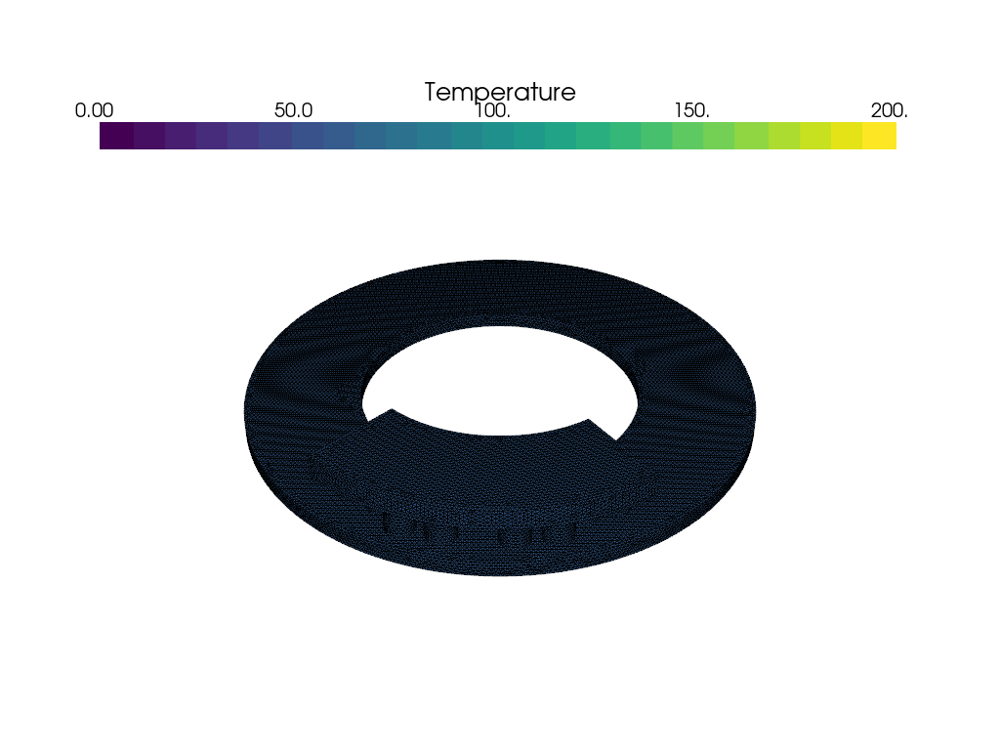

1: Start at: 2024-09-17 12:50:49
2: End at: 2024-09-17 13:14:29
3: Simulation time is 0 hours 24 minutes
4: First time step dt is 0.08093 s
5: Convection heat transfer coefficient is 7.75e-05 W/mm2 K
6: Radiation is 3.6e-13 W/mm2 K-4
7: Each rotation degree is 448 per time step or 1.2 circle
8: The first rotation degree is 1954.8
9: The mid rotation degree is 1954.8
10: The last rotation degree is 1954.8
11: Total contact area of 18 rubbing element is 199.9 cm2
12: The mesh element size is between 3-5 mm
13: Total elements number is 271817



In [9]:
# Display the GIF
from IPython.display import display, Image

display(Image(gif_name))

end_time = time.time()
elapsed_time = end_time - start_time
elapsed_time1 = round(elapsed_time, 0)

formatted_start_time = time.strftime("%Y-%m-%d %H:%M:%S", time.localtime(start_time))
formatted_end_time = time.strftime("%Y-%m-%d %H:%M:%S", time.localtime(end_time))
txt_name = "T-s-{}-d-{}-{}-c-{}-e-{}.txt".format(
    num_steps, angular_r, mesh_filename2, c_contact, total_elements
)
with open(txt_name, "w") as file:
     file.write("1: Start at: {}\n".format(formatted_start_time))
     file.write("2: End at: {}\n".format(formatted_end_time))
    
     if elapsed_time1 >= 60:
        min = elapsed_time1 / 60
        hours = min / 60
        file.write("3: Simulation time is {} hours {} minutes\n".format(round(hours), round(min)))
     else:
        file.write("3: Simulation time is {} second\n".format(elapsed_time1))
    
     file.write("4: First time step dt is {} s\n".format(round(dt[0], 5)))
     r_disc = 0.25
    
     file.write("5: Convection heat transfer coefficient is {} W/mm2 K\n".format(h))
     file.write("6: Radiation is {} W/mm2 K-4\n".format(round(radiation, 14)))
     file.write("7: Each rotation degree is {} per time step or {} circle\n".format(round(angular_r, 1), round(angular_r / 360, 1)))
     file.write("8: The first rotation degree is {}\n".format(round(v_angular[0] * r_disc * dt[0] * 1000, 1)))
     file.write("9: The mid rotation degree is {}\n".format(round(v_angular[round(num_steps / 2)] * r_disc * dt[round(len(dt) / 2)] * 1000, 1)))
     file.write("10: The last rotation degree is {}\n".format(round(v_angular[num_steps - 1] * r_disc * dt[-1] * 1000, 1)))
     file.write("11: Total contact area of 18 rubbing element is {} cm2\n".format(round(S_total / 100, 1)))
     file.write("12: The mesh element size is between {}-{} mm\n".format(mesh_min, mesh_max))
     file.write("13: Total elements number is {}\n".format(total_elements))    
   
with open(txt_name, "r") as file1:
    print(file1.read())

#### move files
# Define the source directory
source_dir = "/home/yanjun/Documents/FEniCSx/Practice/Concise"
# Define the destination directory
destination_dir = "/home/yanjun/Documents/FEM_results/python_results"

# Create the new folder in the destination directory
new_folder_name = f"s-{num_steps}-d-{angular_r}-m-{mesh_min}-{mesh_max}-c-{c_contact}-e-{total_elements}"
destination_dir = os.path.join(destination_dir, new_folder_name)
os.makedirs(destination_dir, exist_ok=True)

# List of files to move
#files_to_move = [gif_name, h5_name, xdmf_name, txt_name, csv_name]
# Move each file to the destination directory
#for filename in files_to_move:
#    source_file_path = os.path.join(source_dir, filename)
#    destination_file_path = os.path.join(destination_dir, filename)
    #shutil.move(source_file_path, destination_file_path)
#print("Move files successfully")

Lables already exists, for mesh m-3-5.msh is  [19098, 34079, 7351]


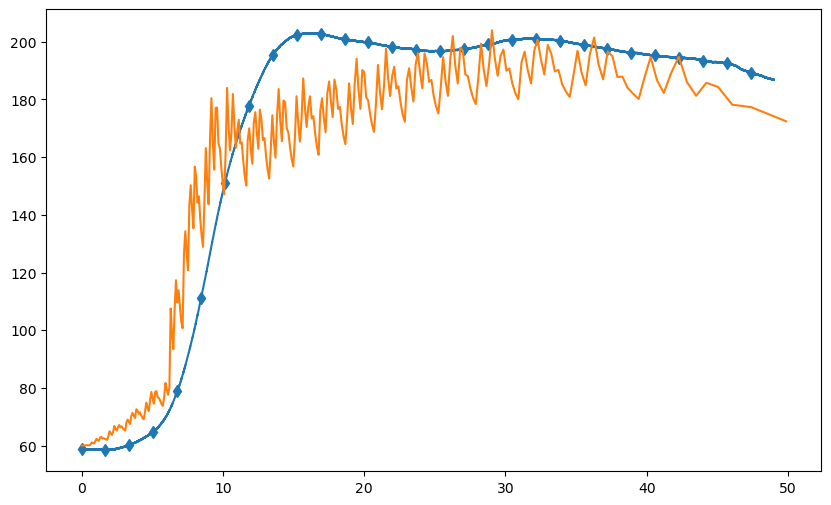

In [10]:
from disc_f import *
import pandas as pd
plt.figure(figsize=(10, 6))

df1 = pd.read_csv('/home/yanjun/documents/sim_results/experiment_result.csv')
T_e_ave = ( df1.iloc[:,1] + df1.iloc[:,3] + df1.iloc[:,5] ) /3
t_e = np.linspace (0, 49, len(T_e_ave) )
plt.plot(t_e, T_e_ave, label= "Experiment",marker='d',markevery=1000)


lables = find_3_coord(mesh_filename1)

t, T = [], []
for value in T_array:
    t.append(value[0])
    T.append(value[1])

T_3_ave = []
for i in range(len(T)):
    T_3_all = T[i][lables[0]] + T[i][lables[1]] + T[i][lables[2]]
    T_3_ave.append(T_3_all / 3)

plt.plot(t, T_3_ave)

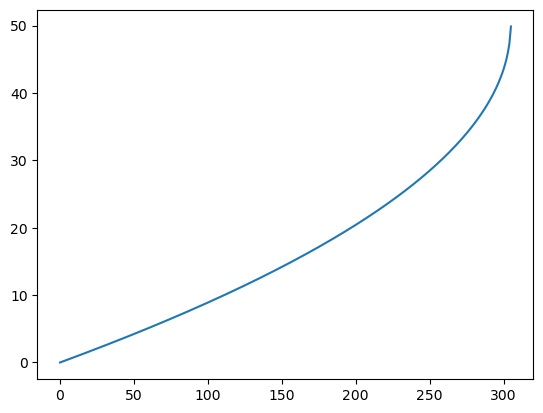

In [11]:
plt.plot(t)